# OpenCV 처음부터 끝까지 

> https://github.com/dltpdn/insightbook.opencv_project_python 참고했습니다.

In [1]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
import glob

&nbsp;

## 목차

    1. 이미지 다루기
    2. 영상 다루기
    3. 이미지 내 관심영역(ROI) 표시
    4. 이미지 색상 표현 방식(BGR, HSV, YUV)
    5. 스레시홀딩(Thresholding), 오츠의 알고리즘(Otsu's Method)
    6. 이미지 연산 (합성, 알파 블렌딩, 마스킹)
    7. 히스토그램과 정규화(Normalize), 평탄화(Equalization), CLAHE
    8. 2차원 히스토그램과 역투영(back project)
    9. 이미지 유사도 비교, 사람 얼굴과 해골 합성
    10. 이미지 이동(Translation), 확대/축소(Scaling), 회전(Rotation)
    11. 이미지 뒤틀기(어핀 변환, 원근 변환)
    12. 리매핑(Remapping), 오목/볼록 렌즈 왜곡(Lens Distortion), 방사 왜곡(Radial Distortion)
    13. 모자이크 처리(Mosaic), 리퀴파이(Liquify), 왜곡 거울(Distortion Mirror)
    14. 필터(Filter)와 컨볼루션(Convolution) 연산, 평균 블러링, 가우시안 블러링, 미디언 블러링, 바이레터럴 필터
    15. 경계 검출 (미분 필터, 로버츠 교차 필터, 프리윗 필터, 소벨 필터, 샤르 필터, 라플라시안 필터, 캐니 엣지)
    16. 모폴로지(Morphology) 연산 (침식, 팽창, 열림, 닫힘, 그레디언트, 탑햇, 블랙햇)
    17. 이미지 피라미드(Image Pyramid)
    18. 컨투어(Contour)
    19. 허프 변환(Hough Transformation)
    20. 연속 영역 분할 (거리 변환, 레이블링, 색 채우기, 워터셰드, 그랩컷, 평균 이동 필터)
    21. 이미지 매칭 (평균 해시 매칭, 템플릿 매칭)
    22. 이미지의 특징점(Keypoints)과 특징점 검출기(Keypoints detector)
    23. 특징 디스크립터 검출기 (SIFT, ORB)
    24. 특징 매칭(Feature Matching)
    25. 올바른 매칭점 찾기
    26. 배경 제거(Background Subtraction)
    27. 광학 흐름(Optical Flow)
    28. 객체 추적을 위한 Tracking API
    29. HOG(Histogram of Oriented Gradient) 디스크립터

## 1. 이미지 다루기

### 이미지 읽기

cv2.imread() : 함수를 이용하여 이미지 파일을 읽습니다. 이미지 파일의 경로는 절대/상대경로가 가능합니다.

Parameters : fileName : 이미지파일의 경로 , flag : 이미지 파일 읽을 때의 추가설정, return : numpy.ndarray

- flag 종류


    cv2.IMREAD_COLOR(이미지 파일을 Color로 읽어들입니다. 투명한 부분은 무시되며, Default값입니다.)

    cv2.IMREAD_GRAYSCALE(이미지를 Grayscale로 읽어 들입니다. 실제 이미지 처리시 중간단계로 많이 사용합니다.)

    cv2.IMREAD_UNCHANGED(이미지파일을 alpha channel까지 포함하여 읽어 들입니다.)

    flag 대신 1,0,-1로도 가능

In [4]:
img = cv2.imread('test_image.jpg', cv2.IMREAD_COLOR)

In [6]:
img.shape

(225, 400, 3)

&nbsp;

### 이미지 보기

cv2.imshow() : 함수는 이미지를 사이즈에 맞게 보여줍니다.

parameters : title(윈도우 창의 Title), image(cv2.imread() 의 return값)

cv2.waitKey() 는 keyboard입력을 대기하는 함수로 0이면 key입력까지 무한대기이며 특정 시간동안 대기하려면 milisecond값을 넣어주면 됩니다.

cv2.destroyAllWindows() 는 화면에 나타난 윈도우를 종료합니다. 일반적으로 위 3개는 같이 사용됩니다.

In [12]:
fname = 'test_image.jpg'

original = cv2.imread(fname, cv2.IMREAD_COLOR)
gray = cv2.imread(fname, cv2.IMREAD_GRAYSCALE)
unchange = cv2.imread(fname, cv2.IMREAD_UNCHANGED)

cv2.imshow('Original', original)
cv2.imshow('Gray', gray)
cv2.imshow('Unchange', unchange)

cv2.waitKey(0)
cv2.destroyAllWindows()

&nbsp;

### 이미지 저장하기

cv2.imwrite() 함수를 이용하여 변환된 이미지나 동영상의 특정 프레임을 저장합니다.

parameter : fileName(저장될 파일명), image(저장할 이미지)

In [16]:
img = cv2.imread('test_image.jpg', cv2.IMREAD_GRAYSCALE)
cv2.imshow('image',img)
k = cv2.waitKey(0)
if k == 27: # esc key
    cv2.destroyAllWindow()
elif k == ord('s'): # 's' key
    cv2.imwrite('lenagray.png',img)
    cv2.destroyAllWindows()

&nbsp;

### Matplotlib 사용하기

Matplotlib는 다양한 plot기능을 가진 Python Plot Library입니다. 이미지를 zoom하거나 하나의 화면에 여러개의 이미지를 보고자 할 때 유용합니다.

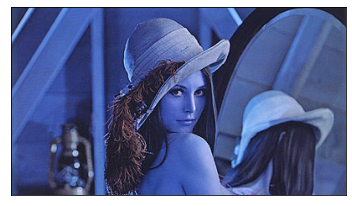

In [28]:
img = cv2.imread('test_image.jpg', cv2.IMREAD_COLOR)


plt.imshow(img)
plt.xticks([]) # x축 눈금
plt.yticks([]) # y축 눈금
plt.show()

openCV는 BGR로 사용하지만, Matplotlib는 RGB로 이미지를 보여주기 때문에 색이 이상하게 나옴

b,g,r -> r,g,b로 바꾸면 가능

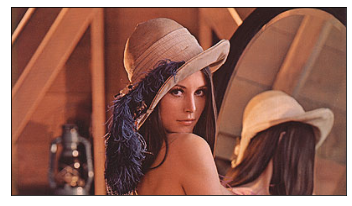

In [29]:
img = cv2.imread('test_image.jpg', cv2.IMREAD_COLOR)

b, g, r = cv2.split(img)   # img파일을 b,g,r로 분리
img2 = cv2.merge([r,g,b]) # b, r을 바꿔서 Merge

plt.imshow(img2)
plt.xticks([]) # x축 눈금
plt.yticks([]) # y축 눈금
plt.show()

## 2. 영상 다루기

### Camera로 부터 영상 재생

- Camera로부터 영상을 읽어, 화면에 보옂기 위해서 아래와 같은 순서로 진행

    - VideoCapture Object를 생성합니다. 변수로는 camera device index나 동영상 파일명을 넘겨줍니다. 일반적으로 0 이면 Camera와 연결
    
    - Loop를 돌면서 frame을 읽어 들입니다.
    
    - 읽은 frame에 대해서 변환작업을 수행한 후, 화면에 보여줍니다.
    
    - 영상 재생이 끝나면, VideoCapure Object를 release하고 window를 닫습니다.

In [4]:
# cap 이 정상적으로 open이 되었는지 확인하기 위해서 cap.isOpen() 으로 확인가능
cap = cv2.VideoCapture(0)

# cap.get(prodId)/cap.set(propId, value)을 통해서 속성 변경이 가능.
# 3은 width, 4는 heigh

print('width: {0}, height: {1}'.format(cap.get(3),cap.get(4)))
cap.set(3,320)
cap.set(4,240)

while(True):
    # ret : frame capture결과(boolean)
    # frame : Capture한 frame
    ret, frame = cap.read()

    if (ret):
        # image를 Grayscale로 Convert함.
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        cv2.imshow('frame', gray)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

cap.release()
cv2.destroyAllWindows()

width: 640.0, height: 480.0


&nbsp;

### File로 부터 영상 재생

File로 부터 동영상 재생도 Camera에서 영상 재생과 동일합니다.

In [ ]:
cap = cv2.VideoCapture('vtest.avi')

while(cap.isOpened()):
    ret, frame = cap.read()
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    cv2.imshow('frame',gray)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
cap.release()
cv2.destroyAllWindows()

&nbsp;

### 영상 저장

영상을 저장하기 위해서는 cv2.VideoWriter Object를 생성해야 합니다.

- parameter

    - outputFile : 저장될 파일명
    - fourcc : Codec정보. cv2.VideoWriter_fourcc()
    - frame : 초당 저장될 frame
    - size : 저장될 사이즈
    
fourcc정보는 cv2.VideoWriter_fourcc('M','J','P','G') 또는 cv2.VideoWriter_fourcc(*'MJPG) 와 같이 표현할 수 있습니다. 

In [14]:
cap = cv2.VideoCapture(0)

# video recorder
fourcc =  cv2.VideoWriter_fourcc(*'XVID')  # cv2.VideoWriter_fourcc() does not exist
out = cv2.VideoWriter("output.avi", fourcc, 25.0, (640,480))

# record video
while (cap.isOpened()):
    ret, frame = cap.read()

    if ret:
        # 이미지 반전,  0:상하, 1 : 좌우
        frame = cv2.flip(frame, 0)

        out.write(frame)

        cv2.imshow('frame', frame)

        if cv2.waitKey(0) & 0xFF == ord('q'):
            break
    else:
        break

cap.release()
out.release()
cv2.destroyAllWindows()

## 3. 이미지 내 관심영역(RoI) 표시

- 관심 영역(ROI)이란 말 그대로 영상 내에서 관심이 있는 영역을 뜻함
- 임의의 사진으로 확인하면서 설명

In [5]:
def imshow(a):
    globals()['img'] = cv2.imread(f'{a}', cv2.IMREAD_COLOR)
    b, g, r = cv2.split(img)   # img파일을 b,g,r로 분리
    img2 = cv2.merge([r,g,b]) # b, r을 바꿔서 Merge

    plt.imshow(img2)
    plt.xticks([]) # x축 눈금
    plt.yticks([]) # y축 눈금
    plt.show()

In [6]:
def imsave(a,b):
    cv2.imshow("img", a)
    cv2.imwrite(f'{b}',a)
    cv2.destroyAllWindows()

    imshow(f'{b}')

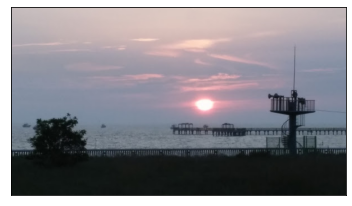

In [7]:
imshow('roi.jpg')

### 태양 위치 주위를 사각형으로 표시

(50, 50, 3)


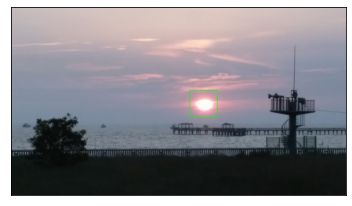

In [8]:
x=320; y=150; w=50; h=50        # roi 좌표
roi = img[y:y+h, x:x+w]         # roi 지정        ---①

print(roi.shape)                # roi shape, (50,50,3)
cv2.rectangle(roi, (0,0), (h-1, w-1), (0,255,0)) # roi 전체에 사각형 그리기 ---②

# --- cv2 창으로 보기 ---
# cv2.imshow("img", img)
# key = cv2.waitKey(0)
# print(key)
# cv2.destroyAllWindows()

imsave(img,'roi_rec.png')

cv2.imread() 함수를 실행하면 이미지를 numpy 배열로 반환, numpy 배열은 슬라이싱이 가능, 원하는 영역을 지정하기 위해서는 이미지 numpy 배열을 슬라이싱 하면 됩니다. 위 코드에서 img[y:y+h, x:x+w]는 원하는 영역을 슬라이싱 합니다. 즉, roi 변수에는 관심 영역인 태양을 슬라이싱 한 numpy 배열이 담깁니다.

cv2.rectangle(roi, (0,0), (h-1, w-1), (0,255,0))은 태양 부분만 슬라이싱 한 roi 이미지의 (0, 0)부터 (h-1, w-1)까지 (0, 255, 0) 색으로 사각형을 표시하는 코드
    
    - (0, 0)은 좌측 상단
    - (h-1, w-1)은 우측 하단
    - RGB 값인 (0, 255, 0)은 녹색

### 관심영역 복제 및 새 창에 띄우기 

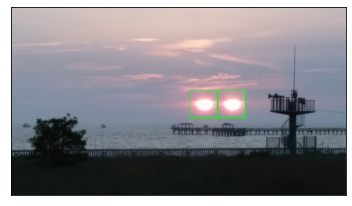

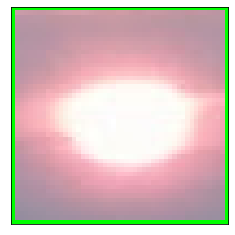

In [9]:
x=320; y=150; w=50; h=50
roi = img[y:y+h, x:x+w]     # roi 지정
img2 = roi.copy()           # roi 배열 복제 ---①

img[y:y+h, x+w:x+w+w] = roi # 새로운 좌표에 roi 추가, 태양 2개 만들기
cv2.rectangle(img, (x,y), (x+w+w, y+h), (0,255,0)) # 2개의 태양 영역에 사각형 표시


imsave(img,'roi_2.png') # 원본 이미지 출력
imsave(img2,'roi_point.png') # roi 만 따로 출력

### 마우스 드래그로 관심 영역 표시하기

- 관심 영역을 관심 영역을 표시하기 위해서는 원하는 영역의 좌표와 크기(높이, 너비)가 필요
- 마우스를 통해 번거로운 과정 쉽게 적용

In [10]:
isDragging = False                      # 마우스 드래그 상태 저장 
x0, y0, w, h = -1,-1,-1,-1              # 영역 선택 좌표 저장
blue, red = (255,0,0),(0,0,255)         # 색상 값 

def onMouse(event,x,y,flags,param):     # 마우스 이벤트 핸들 함수  --- 1
    global isDragging, x0, y0, img      # 전역변수 참조
    if event == cv2.EVENT_LBUTTONDOWN:  # 왼쪽 마우스 버튼 다운, 드래그 시작 --- 2
        isDragging = True
        x0 = x
        y0 = y
    elif event == cv2.EVENT_MOUSEMOVE:  # 마우스 움직임 --- 3
        if isDragging:                  # 드래그 진행 중
            img_draw = img.copy()       # 사각형 그림 표현을 위한 이미지 복제
            cv2.rectangle(img_draw, (x0, y0), (x, y), blue, 2) # 드래그 진행 영역 표시
            cv2.imshow('img', img_draw) # 사각형 표시된 그림 화면 출력
    elif event == cv2.EVENT_LBUTTONUP:  # 왼쪽 마우스 버튼 업 --- 4
        if isDragging:                  # 드래그 중지
            isDragging = False          
            w = x - x0                  # 드래그 영역 폭 계산
            h = y - y0                  # 드래그 영역 높이 계산
            print("x:%d, y:%d, w:%d, h:%d" % (x0, y0, w, h))
            if w > 0 and h > 0:         # 폭과 높이가 양수이면 드래그 방향이 옳음 --- 5
                img_draw = img.copy()   # 선택 영역에 사각형 그림을 표시할 이미지 복제
                # 선택 영역에 빨간 사각형 표시
                cv2.rectangle(img_draw, (x0, y0), (x, y), red, 2) 
                cv2.imshow('img', img_draw) # 빨간 사각형 그려진 이미지 화면 출력
                cv2.imwrite('./red_img.jpg', img_draw) # ROI 영역드래그한 빨간색 사각형 저장 --- 6
                roi = img[y0:y0+h, x0:x0+w] # 원본 이미지에서 선택 영영만 ROI로 지정 --- 7
                cv2.imshow('cropped', roi)  # ROI 지정 영역을 새창으로 표시
                cv2.moveWindow('cropped', 0, 0) # 새창을 화면 좌측 상단에 이동
                cv2.imwrite('./cropped.jpg', roi)   # ROI 영역만 파일로 저장 --- 8
                
                print("croped.")
            else:
                cv2.imshow('img', img)  # 드래그 방향이 잘못된 경우 사각형 그림ㅇㅣ 없는 원본 이미지 출력
                print("좌측 상단에서 우측 하단으로 영역을 드래그 하세요.")

In [11]:
img = cv2.imread('roi.jpg', cv2.IMREAD_COLOR)
cv2.imshow('img', img)
cv2.setMouseCallback('img', onMouse) # 마우스 이벤트 등록 --- 9
cv2.waitKey()
cv2.destroyAllWindows()

x:324, y:160, w:42, h:31
croped.


- onMouse()라는 콜백 함수를 선언
    - 1. 마우스 왼쪽 버튼을 눌렀을 때
        - 드래그가 시작되었다는 것을 기억하기 위한 isDragging이라는 변수의 상태를 True로 변경, 드래그가 시작된 점을 x0, y0로 지정
    - 2. 누른 상태로 드래그했을 때
        -  img를 복제하고, 복제한 이미지의 (x0, y0)부터 (x, y)까지 파란색 사각형으로 표시, (x0, y0)는 마우스 드래그가 시작된 위치이고, (x, y)는 마우스의 현재 위치
    - 3. 마우스 왼쪽 버튼을 뗄 때
        -  isDragging은 False로 바꾸고, 드래그 영역의 폭은 w, 높이는 h로 계산, w와 h가 모두 양수이면 지정 영역을 빨간색 사각형으로 표시
    - 위의 3단계가 끝나면 이미지를 저장

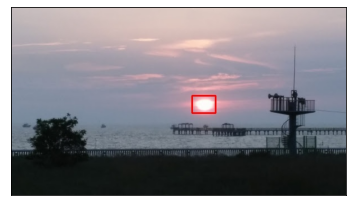

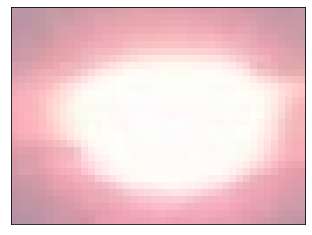

In [12]:
imshow('red_img.jpg') # 마우스로 표시한 부분
imshow('cropped.jpg') # crop한 부분

&nbsp;

### selectROI로 관심영역 지정 및 표시, 저장

- 마우스로 관심영역 추출할때 매번 함수를 작성하는것은 번거로움
- OpenCV에서는 이를 간단하게 도와주는 함수를 제공
- 마우스 이벤트 처리를 위한 코드 없이도 관심 영역을 지정 가능

- ret = cv2.selectROI(win_name, img, showCrossHair=True, fromCenter=False)
    - win_name: 관심영역을 표시할 창의 이름
    - img: 관심영역을 표시할 이미지
    - showCrossHair: 선택 영역 중심에 십자 모양 표시 여부
    - fromCenter: 마우스 시작 지점을 영역의 중심으로 지정
    - ret: 선택한 영역의 좌표와 크기 (x, y, w, h); 선택을 취소하면 모두 0으로 지정됨

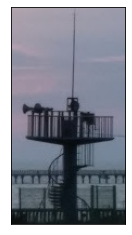

In [8]:
img = cv2.imread('roi.jpg', cv2.IMREAD_COLOR)
x,y,w,h = cv2.selectROI('img', img, False)
if w and h:
    roi = img[y:y+h, x:x+w]
    cv2.imshow('cropped', roi)                   # ROI 지정 영역을 새창으로 표시
    cv2.moveWindow('cropped', 0, 0)              # 새창을 화면 측 상단으로 이동
    cv2.imwrite('cropped2.jpg', roi)  # ROI 영역만 파일로 저장
    
cv2.imshow('img', img)
cv2.waitKey(0)
cv2.destroyAllWindows()


imshow('cropped2.jpg')

&nbsp;

## 4. 이미지 색상 표현 방식(BGR, HSV, YUV)

- BGR, BGRA
    - 색상을 표현하는 방법으로 RGB, 빨강, 초록, 파랑 세 가지 색의 빛을 섞어서 원하는 색을 만드는 방식
    - OpenCV는 그 반대의 순서인 BGR로 표현
    
    - RGBA는 RGB에 A(알파, alpha)가 추가된 색상 표기법, A는 배경의 투명도를 의미

In [1]:
import cv2
from matplotlib import pyplot as plt
import numpy as np

In [9]:
# 기본 값 옵션
img = cv2.imread('opencv_logo.png')   
# IMREAD_COLOR 옵션                   
bgr = cv2.imread('opencv_logo.png', cv2.IMREAD_COLOR)    
# IMREAD_UNCHANGED 옵션
bgra = cv2.imread('opencv_logo.png', cv2.IMREAD_UNCHANGED) 
# 각 옵션에 따른 이미지 shape
print("default", img.shape, "color", bgr.shape, "unchanged", bgra.shape) 

cv2.imshow('bgr', bgr)
cv2.imshow('bgra', bgra)
cv2.imshow('alpha', bgra[:,:,3])  # 알파 채널만 표시
cv2.waitKey(0)
cv2.destroyAllWindows()

default (1024, 831, 3) color (1024, 831, 3) unchanged (1024, 831, 4)


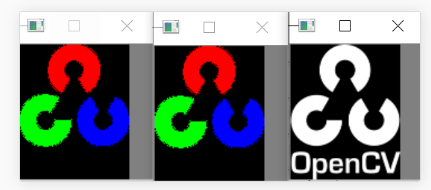

- 파라미터를 cv2.IMREAD_COLOR로 전달한 것과 아무 파라미터를 전달하지 않은 이미지의 차이는 없음
- 첫 번째와 두 번째 이미지 모두 shape가 (240, 195, 3), 세 번째 이미지는 알파 채널이 하나 더 있어 shape가 (240, 195, 4)
- 세 번째 이미지에서 전경의 알파 값은 255, 배경의 알파 값은 0, 255 = 흰색 , 0 = 검은색
- 첫 번째, 두 번째 이미지와 달리 세 번째 이미지는 알파 채널만 표시했으므로 전경과 배경을 쉽게 분리가능, 이런 이유로 알파 채널은 마스크 채널이라고 함

&nbsp;

### BGR 색상 이미지를 회색조 이미지로 변환하기

- 컬러 이미지를 회색조 이미지로 변환하는 것은 이미지 연산의 양을 줄여서 속도를 높임
- 처음부터 회색조로 읽어 들이는 함수 :  cv2.imread(img, cv2.IMREAD_GRAYSCALE), cv2.imread() 함수의 두 번째 파라미터로 cv2.IMREAD_GRAYSCALE을 전달
- 처음에는 BGR 컬러 이미지로 읽어 들이고 그 이후에 회색조로 변환하는 경우 : cv2.cvtcolor() 함수로 구현

In [11]:
img = cv2.imread('test_image.jpg')

img2 = img.astype(np.uint16)                # dtype 변경 ---①
b,g,r = cv2.split(img2)                     # 채널 별로 분리 ---② b,g,r = img2[:,:,0], img2[:,:,1], img2[:,:,2]

gray1 = ((b + g + r)/3).astype(np.uint8)    # 평균 값 연산후 dtype 변경 ---③
gray2 = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) # BGR을 그레이 스케일로 변경 ---④


cv2.imshow('original', img)
cv2.imshow('gray1', gray1)
cv2.imshow('gray2', gray2)

cv2.waitKey(0)
cv2.destroyAllWindows()

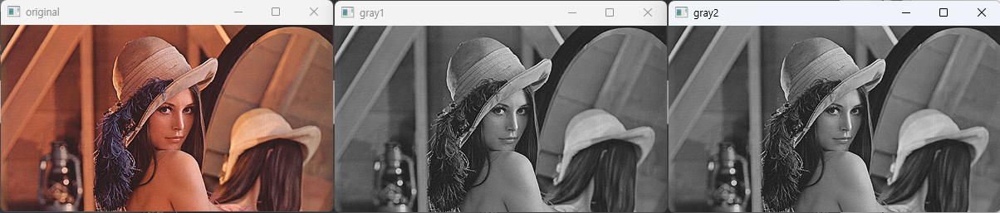

- gray1 이미지는 평균값을 이용해 회색조 이미지로 표현하는 알고리즘을 직접 구현한 것
- 평균을 구하기 전에 dtype을 unit16으로 변경(3 채널의 값을 합하면 255보다 큰 값이 나올 수 있기 때문에), 평균을 구한 뒤에는 다시 unit8로

- gray2 는 cv2.cvtcolor(img, flag)를 통한 그레이 스케일변경 방법
- flag 파라미터에 cv2.COLOR_BRG2GRAY

- flag parameter은 총 274개, 그중 가장 잘 사용되는 parameter 설명
    - cv2.COLOR_BGR2GRAY: BGR 색상 이미지를 회색조 이미지로 변환
    - cv2.COLOR_GRAY2BGR: 회색조 이미지를 BGR 색상 이미지로 변환
    - cv2.COLOR_BGR2RGB: BGR 색상 이미지를 RGB 색상 이미지로 변환
    - cv2.COLOR_BGR2HSV: BGR 색상 이미지를 HSV 색상 이미지로 변환
    - cv2.COLOR_HSV2BGR: HSV 색상 이미지를 BGR 색상 이미지로 변환
    - cv2.COLOR_BGR2YUV: BGR 색상 이미지를 YUV 색상 이미지로 변환
    - cv2.COLOR_YUV2BGR: YUB 색상 이미지를 BGR 색상 이미지로 변환

&nbsp;

### HSV 방식

- HSV 방식은 RGB와 마찬가지로 3개의 채널을 갖는 색상 이미지 표현법
- 3개의 채널은 H(Hue, 색조), S(Saturation, 채도), V(Value, 명도)

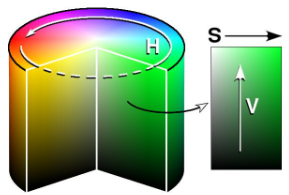

위 그림을 통해 확인하면

    - H 값은 이미지가 어떤 색상인지 나타내는 값
    - S는 이미지의 색상이 얼마나 순수하게 포함되어 있는지를 나타내는 값
    - V는 색상이 얼마나 밝은지 어두운지 나타내는 값

cv2.cvtColor() 함수에서 두 번째 파라미터로 cv2.COLOR_BGR2HSV 넣어주면  BGR -> HSV 으로 변환, cv2.COLOR_HSV2BGR은 HSV -> BGR

### BGR을 HSV로 변환

In [12]:
#---① BGR 컬러 스페이스로 원색 픽셀 생성
red_bgr = np.array([[[0,0,255]]], dtype=np.uint8)   # 빨강 값만 갖는 픽셀
green_bgr = np.array([[[0,255,0]]], dtype=np.uint8) # 초록 값만 갖는 픽셀
blue_bgr = np.array([[[255,0,0]]], dtype=np.uint8)  # 파랑 값만 갖는 픽셀
yellow_bgr = np.array([[[0,255,255]]], dtype=np.uint8) # 노랑 값만 갖는 픽셀

#---② BGR 컬러 스페이스를 HSV 컬러 스페이스로 변환
red_hsv = cv2.cvtColor(red_bgr, cv2.COLOR_BGR2HSV);
green_hsv = cv2.cvtColor(green_bgr, cv2.COLOR_BGR2HSV);
blue_hsv = cv2.cvtColor(blue_bgr, cv2.COLOR_BGR2HSV);
yellow_hsv = cv2.cvtColor(yellow_bgr, cv2.COLOR_BGR2HSV);

#---③ HSV로 변환한 픽셀 출력
print("red:",red_hsv)
print("green:", green_hsv)
print("blue", blue_hsv)
print("yellow", yellow_hsv)

red: [[[  0 255 255]]]
green: [[[ 60 255 255]]]
blue [[[120 255 255]]]
yellow [[[ 30 255 255]]]


- 색상을 알아내기 위해서 RGB 방식은 세 가지 채널의 값을 모두 알아야 하지만, HSV 방식은 오직 H값 하나만 알면 되므로 좀 더 편리하고 효과적

&nbsp;

### YUV, YCbCr 방식

- Y는 밝기, U는 밝기와 파란색과의 색상 차, V는 밝기와 빨간색과의 색상 차를 의미
- Y에는 많은 비트수를 할당하고 U와 V에는 적은 비트수를 할당하여 데이터를 압축하는 효과를 가짐
- 아래는 Y=0.5일 때, V와 U에 따른 YUV 방식의 색상 이미지 영역

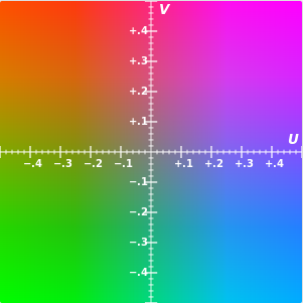

&nbsp;

### BGR 값을 YUV 

In [14]:
#---① BGR 컬러 스페이스로 3가지 밝기의 픽셀 생성
dark = np.array([[[0,0,0]]], dtype=np.uint8)        # 3 채널 모두 0인 가장 어두운 픽셀
middle = np.array([[[127,127,127]]], dtype=np.uint8) # 3 채널 모두 127인 중간 밝기 픽셀
bright = np.array([[[255,255,255]]], dtype=np.uint8) # 3 채널 모두 255인 가장 밝은 픽셀

#---② BGR 컬러 스페이스를 YUV 컬러 스페이스로 변환
dark_yuv = cv2.cvtColor(dark, cv2.COLOR_BGR2YUV)
middle_yuv = cv2.cvtColor(middle, cv2.COLOR_BGR2YUV)
bright_yuv = cv2.cvtColor(bright, cv2.COLOR_BGR2YUV)

#---③ YUV로 변환한 픽셀 출력
print("dark:",dark_yuv)
print("middle:", middle_yuv)
print("bright", bright_yuv)

dark: [[[  0 128 128]]]
middle: [[[127 128 128]]]
bright [[[255 128 128]]]


- BGR값은 (0, 0, 0), (127, 127, 127), (255, 255, 255)로 어두운 픽셀, 중간 밝기의 픽셀, 가장 밝은 픽셀
- YUV 방식으로 변환하면 각각 (0, 128, 128), (127, 128, 128), (255, 128, 128)
- 두 번째, 세 번째 값은 동일한데 Y값만 변화
- 밝기에 좀 더 신경을 써야 한다면 BGR 방식보다 YUV 방식을 사용하는 것이 더 현명한 방법

&nbsp;

- OpenCV에서 색상을 표현하는 방식은 네 가지(BGR 방식, BGRA 방식, HSV 방식, YUV 방식)
- BGR 방식은 전통적인 RGB 방식과 유사하며 그 순서만 반대
- BGRA 방식은 BGR 방식에서 투명도를 나타내는 A(알파) 값이 추가된 방식
- HSV 방식은 색조, 채도, 명도를 이용해서 색상을 표현하는 방식으로 H만 알면 색조는 어느 정도 파악이 가능, 색조를 한눈에 알고자 한다면 HSV 방식을 사용
- YUV 방식은 밝기에 더 신경을 써야 하는 경우에 사용

&nbsp;

## 5. 스레시홀딩(Thresholding), 오츠의 알고리즘(Otsu's Method)

&nbsp;

### 스레시홀딩(Thresholding)
- 바이너리 이미지를 만드는 가장 대표적인 방법
    - 바이너리 이미지 : 검은색과 흰색만으로 표현한 이미지를 의미
- 스레시홀딩이란 여러 값을 어떤 임계점을 기준으로 두 가지 부류로 나누는 방법을 의미

&nbsp;

### 전역 스레시홀딩
- 어떤 임계값을 정한 뒤 픽셀 값이 임계값을 넘으면 255, 임계값을 넘지 않으면 0으로 지정하는 방식
- OpenCV에서 cv2.threshold() 함수로 구현가능
- 전역 스레시홀딩 작업을 numpy 연산과 cv2.threshold() 함수를 통해 수행하는 과정

127.0


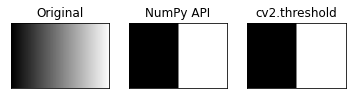

In [16]:
img = cv2.imread('gray_gradient.jpg', cv2.IMREAD_GRAYSCALE) #이미지를 그레이 스케일로 읽기

# --- ① NumPy API로 바이너리 이미지 만들기
thresh_np = np.zeros_like(img)   # 원본과 동일한 크기의 0으로 채워진 이미지
thresh_np[ img > 127] = 255      # 127 보다 큰 값만 255로 변경

# ---② OpenCV API로 바이너리 이미지 만들기
ret, thresh_cv = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY) 
print(ret)  # 127.0, 바이너리 이미지에 사용된 문턱 값 반환

# ---③ 원본과 결과물을 matplotlib으로 출력
imgs = {'Original': img, 'NumPy API':thresh_np, 'cv2.threshold': thresh_cv}
for i , (key, value) in enumerate(imgs.items()):
    plt.subplot(1, 3, i+1)
    plt.title(key)
    plt.imshow(value, cmap='gray')
    plt.xticks([]); plt.yticks([])

plt.show()

- 검은색에서 흰색으로 점점 변하는 그라데이션 이미지를 회색조로 읽음
- numpy 연산을 통해 픽셀 값이 127보다 크면 255, 픽셀 값이 127보다 작거나 같으면 0
- 위 작업을 cv2.threshold(img, 127, 255, cv2.THRESH_BINARY) 함수를 호출하여 수행가능



- ret, out = cv2.threshold(img, threshold, value, type_flag)
    - img: 변환할 이미지
    - threshold: 스레시홀딩 임계값
    - value: 임계값 기준에 만족하는 픽셀에 적용할 값
    - type_flag: 스레시홀딩 적용 방법
    
    
    
    - type_flag 값
        - cv2.THRESH_BINARY: 픽셀 값이 임계값을 넘으면 value로 지정하고, 넘지 못하면 0으로 지정
        - cv2.THRESH_BINARY_INV: cv.THRESH_BINARY의 반대
        - cv2.THRESH_TRUNC: 픽셀 값이 임계값을 넘으면 value로 지정하고, 넘지 못하면 원래 값 유지
        - cv2.THRESH_TOZERO: 픽셀 값이 임계값을 넘으면 원래 값 유지, 넘지 못하면 0으로 지정
        - cv2.THRESH_TOZERO_INV: cv2.THRESH_TOZERO의 반대
    
    - ret은 스레시홀딩에 사용한 임계값,  out은 스레시홀딩이 적용된 바이너리 이미지
    - 첫번째 결과인 ret은 threshold 파라미터로 전달한 값과 동일

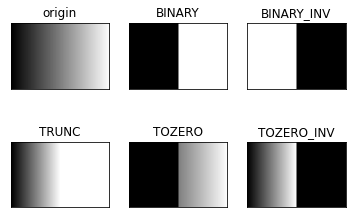

In [17]:
img = cv2.imread('gray_gradient.jpg', cv2.IMREAD_GRAYSCALE)

_, t_bin = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)
_, t_bininv = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY_INV)
_, t_truc = cv2.threshold(img, 127, 255, cv2.THRESH_TRUNC)
_, t_2zr = cv2.threshold(img, 127, 255, cv2.THRESH_TOZERO)
_, t_2zrinv = cv2.threshold(img, 127, 255, cv2.THRESH_TOZERO_INV)

imgs = {'origin':img, 'BINARY':t_bin, 'BINARY_INV':t_bininv, \
        'TRUNC':t_truc, 'TOZERO':t_2zr, 'TOZERO_INV':t_2zrinv}

for i, (key, value) in enumerate(imgs.items()):
    plt.subplot(2,3, i+1)
    plt.title(key)
    plt.imshow(value, cmap='gray')
    plt.xticks([]);    plt.yticks([])
    
plt.show()

&nbsp;

### 오츠의 이진화 알고리즘

- 바이너리 이미지를 만들 때 가장 중요한 점은 임계값을 얼마로 정하냐 하는 것
- 오츠의 알고리즘은 임계값을 임의로 정해 픽셀을 두 부류로 나누고 두 부류의 명암 분포를 구하는 작업을 반복, 모든 경우의 수 중에서 두 부류의 명암 분포가 가장 균일할 때의 임계값을 선택
- 밑은 오츠의 알고리즘 예시

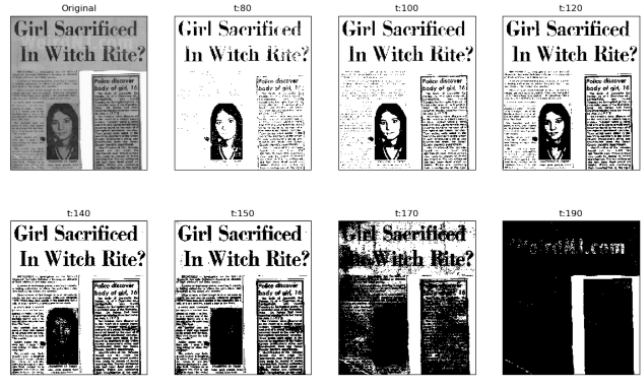

- OpenCV에서 오츠의 알고리즘 적용은 cv2.threshold() 함수의 마지막 파라미터로 cv2.THRESH_OTSU 사용
- 오츠의 알고리즘은 최적의 임계값을 찾아주므로 cv2.threshold() 함수에 전달하는 threshold 파라미터는 아무 값이어도 상관없음, 무시됨

otsu threshold: 131.0


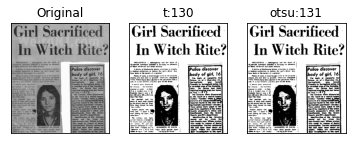

In [19]:
# 이미지를 그레이 스케일로 읽기
img = cv2.imread('scaned_paper.jpg', cv2.IMREAD_GRAYSCALE) 
# 경계 값을 130으로 지정  ---①
_, t_130 = cv2.threshold(img, 130, 255, cv2.THRESH_BINARY)        
# 경계 값을 지정하지 않고 OTSU 알고리즘 선택 ---②
t, t_otsu = cv2.threshold(img, -1, 255,  cv2.THRESH_BINARY | cv2.THRESH_OTSU) 
print('otsu threshold:', t)                 # Otsu 알고리즘으로 선택된 경계 값 출력

imgs = {'Original': img, 't:130':t_130, 'otsu:%d'%t: t_otsu}
for i , (key, value) in enumerate(imgs.items()):
    plt.subplot(1, 3, i+1)
    plt.title(key)
    plt.imshow(value, cmap='gray')
    plt.xticks([]); plt.yticks([])

plt.show()

- 원본 이미지의 글씨는 선명하지 않지만 바이너리 이미지로 변환하니 글씨가 좀 더 선명해짐
- 맨 왼쪽은 원본 이미지, 두 번째 이미지는 임계값을 130으로 지정해준 바이너리 이미지, 세 번째 이미지는 오츠의 알고리즘을 적용한 바이너리 이미지(오츠의 알고리즘에 따르면 최적의 임계값은 131)
- 오츠의 알고리즘 내용을 확인하면


```python
t, t_otsu = cv2.threshold(img, -1, 255,  cv2.THRESH_BINARY | cv2.THRESH_OTSU) 
```

    - 두 번째 파라미터인 -1은  threshold를 전달하는 값, 오츠의 알고리즘에서는 무시됨
    - 오츠의 알고리즘이 최적의 임계값을 자동으로 찾아준다는 장점이 있지만, 모든 경우의 수에 대해 조사해야 하므로 속도가 빠르지 않다는 단점 존재

&nbsp;

### 적응형 스레시홀딩(Adaptive Thresholding)

- 전역 스레시홀딩이 매번 좋은 성능을 내는 것은 아님
        - 원본 이미지에서 조명이 일정하지 않거나 배경색이 여러 개인 경우에는 하나의 임계값으로 선명한 바이너리 이미지를 만들어내기 힘들 수도 있음
- 이때는 이미지를 여러 영역으로 나눈 뒤, 그 주변 픽셀 값만 활용하여 임계값을 계산, 이를 적응형 스레시 홀딩이라고 함



```python
cv2.adaptiveThreshold(img, value, method, type_flag, block_size, C)
```

       img: 입력영상
       value: 임계값을 만족하는 픽셀에 적용할 값
       method: 임계값 결정 방법
       type_flag: 스레시홀딩 적용 방법 (cv2.threshod()와 동일)
       block_size: 영역으로 나눌 이웃의 크기(n x n), 홀수
       C: 계산된 임계값 결과에서 가감할 상수(음수 가능)
       
- method

        cv2.ADAPTIVE_THRESH_MEAN_C: 이웃 픽셀의 평균으로 결정
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C: 가우시안 분포에 따른 가중치의 합으로 결정

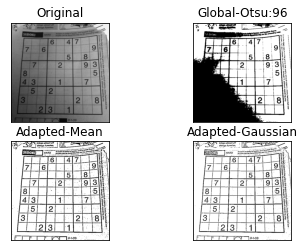

In [20]:
blk_size = 9        # 블럭 사이즈
C = 5               # 차감 상수 
img = cv2.imread('./sudoku.png', cv2.IMREAD_GRAYSCALE) # 그레이 스케일로  읽기

# ---① 오츠의 알고리즘으로 단일 경계 값을 전체 이미지에 적용
ret, th1 = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)

# ---② 어뎁티드 쓰레시홀드를 평균과 가우시안 분포로 각각 적용
th2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C,\
                                      cv2.THRESH_BINARY, blk_size, C)
th3 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, \
                                     cv2.THRESH_BINARY, blk_size, C)

# ---③ 결과를 Matplot으로 출력
imgs = {'Original': img, 'Global-Otsu:%d'%ret:th1, \
        'Adapted-Mean':th2, 'Adapted-Gaussian': th3}
for i, (k, v) in enumerate(imgs.items()):
    plt.subplot(2,2,i+1)
    plt.title(k)
    plt.imshow(v,'gray')
    plt.xticks([]),plt.yticks([])

plt.show()

- 오츠의 알고리즘을 사용한 바이너리 이미지를 확인했을때
    - 왼쪽 아래는 검정색으로, 오른쪽 위는 흰색으로 변해 이미지를 식별하기가 어려움
    - 원본 이미지 좌측 하단이 우측 상단보다 더 그늘지고 어두워 발생하는 현상, 전역 스레시홀딩을 하면 발생하는 문제
    
- 적응형 스레시 홀딩
    - Adapted-Mean
        - Adapted-Gaussian 적용한것보다 선명하지만 잡음이 조금 있음
    - Adapted-Gaussian
        - Adapted-Mean보다 선명하지 않지만 잡음은 적음

- 적응형 스레시홀딩 알고리즘
    - 전체 이미지에 총 9개의 블록을 설정
    - 블록별로 임계값 설정(cv2.ADAPTIVE_THRESH_MEAN_C를 파라미터로 전달하면 각 블록의 이웃 픽셀의 평균으로 임계값 설정, cv2.ADAPTIVE_THRESH_GAUSSIAN_C를 파라미터로 전달하면 가우시안 분포에 따른 가중치의 합으로 임계값 설정)
    - 정해진 임계값을 바탕으로 각 블록별로 스레시홀딩 수행
    - 전역 스레시홀딩을 적용한 것보다 더 선명하고 부드러운 결과를 얻음
- 대부분 이미지에 조명차이가 있어서 전역 스레시홀딩보다 적응형 스레시 홀딩을 사용함

&nbsp;

## 6. 이미지 연산 (합성, 알파 블렌딩, 마스킹)

- 이미지 연산을 위한 방법은 numpy를 활용하는 방법이 있지만 opencv에서 연산함수를 제공하는 이유는 값의 범위때문, 0~255 인데 연산결과가 255보다 크거나 0보다 작을수 있어서 이를 제한할 필요가 있음

- opencv 제공되는 연산함수

    ```python
    cv2.add(src1,src2,dest,mask,dtype) : src1과 src2 더하기
    ```
        - src1: 첫 번째 입력 이미지

        - src2: 두 번째 입력 이미지

        - dest(optional): 출력 영상

        - mask(optional): mask 값이 0이 아닌 픽셀만 연산

        - dtype(optional): 출력 데이터 타입(dtype)
&nbsp;
    ```python
    cv2.subtract(src1,src2,dest,mask,dtype) : src1과 src2 빼기
    ```
        - parameter cv2.add와 동일
&nbsp;
    ```python
    cv2.multiply(src1, src2, dest, scale, dtype) :  src1과 src2 곱하기
    ```
        - scale(optional) : 연산 결과에 추가 연산할 값
&nbsp;  
    ```python
    cv2.multiply(src1, src2, dest, scale, dtype) :  src1을 src2로 나누기
    ```
        - cv2.multiply와 동일

In [21]:
# ---① 연산에 사용할 배열 생성
a = np.uint8([[200, 50]]) 
b = np.uint8([[100, 100]])

#---② NumPy 배열 직접 연산
add1 = a + b
sub1 = a - b
mult1 = a * 2
div1 = a / 3

# ---③ OpenCV API를 이용한 연산
add2 = cv2.add(a, b)
sub2 = cv2.subtract(a, b)
mult2 = cv2.multiply(a , 2)
div2 = cv2.divide(a, 3)

#---④ 각 연산 결과 출력
print(add1, add2)
print(sub1, sub2)
print(mult1, mult2)
print(div1, div2)

[[ 44 150]] [[255 150]]
[[100 206]] [[100   0]]
[[144 100]] [[255 100]]
[[66.66666667 16.66666667]] [[67 17]]


- numpy 연산 결과와 OpenCV 연산 함수를 활용한 연산 결과가 서로 다름
- 덧셈에서 200 + 100 = 300으로 255를 초과, unit8 타입의 범위는 0~255 이므로 255를 넘는 값은 다시 0부터 카운팅 수행
    - numpy에서는 300 - 255 - 1 = 44
    - opencv에서는 255초과값은 255
- 위와 같은 이유로 뻴셈에서는 opencv는 0이하는 0, 곱하기, 나누기에서도 255초과하거나 0보다 작은 값을 갖지 않고 소수점은 갖지않음


- cv2.add()에 세 번째 파라미터를 전달하면 첫 번째 두 번째 파라미터 합을 세 번째 파라미터에 할당
```python
c = cv2.add(a,b)
c = cv2.add(a,b,None)
cv2.add(a,b,c)
```
- 위 3개의 코드는 같은 결과수행

#### 4번째 parameter인 mask 사용시

In [22]:
#---① 연산에 사용할 배열 생성
a = np.array([[1, 2]], dtype=np.uint8)
b = np.array([[10, 20]], dtype=np.uint8)
#---② 2번째 요소가 0인 마스크 배열 생성 
mask = np.array([[1, 0]], dtype=np.uint8)

#---③ 누적 할당과의 비교 연산
c1 = cv2.add(a, b, None, mask)
print(c1)
c2 = cv2.add(a, b, b.copy(), mask)
print(c2, b)
c3 = cv2.add(a, b, b, mask)
print(c3, b)

[[11  0]]
[[11 20]] [[10 20]]
[[11 20]] [[11 20]]


- cv2.add(a, b, None, mask) 연산에서 a + b = [[11,22]]가 나와야하지만 mask옵션에서 0이 아닌 위치만 계산하기 때문에 [[11,0]]
- cv2.add(a, b, b.copy(), mask)는 a+b의 첫번째 요소만 더하고 b.copy()에 반영할때 첫번째 자리만 반영 [[11 , 20]]
- cv2.add(a, b, b, mask) 위와 같은 연산으로 이루어지고 기존의 b도 변경

&nbsp;

### 이미지 합성

- 두 이미지를 합성할 때 위에서 살펴본 numpy의 합이나 cv2.add() 함수만으로는 좋은 결과를 얻을 수 없음
    - numpy는 255초과 값만큼 반영 150+180 = 330 -> 74
    - cv2.add() 연산을 하면 대부분의 픽셀 값이 255으로 몰려서 흰색됨

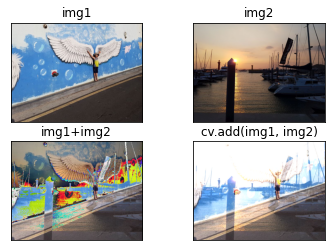

In [26]:
# ---① 연산에 사용할 이미지 읽기
img1 = cv2.imread('./wing_wall.jpg')
img2 = cv2.imread('./yate.jpg')

# ---② 이미지 덧셈
img3 = img1 + img2  # 더하기 연산
img4 = cv2.add(img1, img2) # OpenCV 함수

imgs = {'img1':img1, 'img2':img2, 'img1+img2': img3, 'cv.add(img1, img2)': img4}

# ---③ 이미지 출력
for i, (k, v) in enumerate(imgs.items()):
    plt.subplot(2,2, i + 1)
    plt.imshow(v[:,:,::-1]) # BGR -> RGB
    plt.title(k)
    plt.xticks([]); plt.yticks([])

plt.show()

- numpy로 img1+img2를 한 경우 255를 넘는 픽셀은 이상한 색상을 보임
-  cv2.add(img1, img2)를 수행한 경우 대부분의 값이 255에 몰려 전체적으로 하얀 픽셀


- 두 이미지를 제대로 합성하려면 각각의 이미지에 가중치를 주고 합해야함, 가중치를 알파(alpha) 값
- 새로운 이미지 알파(alpha)를 활용하여 합성 결과 픽셀 값 g(x)를 구하는 공식은 밑과 같음

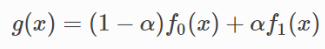

```python
cv2.addWeight(img1, alpha, img2, beta, gamma)
```
        img1, img2: 합성할 두 이미지
        alpha: img1에 지정할 가중치(알파 값)
        beta: img2에 지정할 가중치, 흔히 (1-alpha) 적용
        gamma: 연산 결과에 가감할 상수, 흔히 0 적용

### 알파 블렌딩

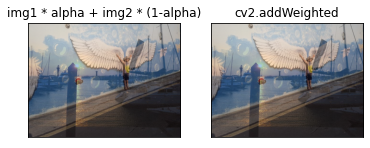

In [28]:
alpha = 0.5 # 합성에 사용할 알파 값

#---① 합성에 사용할 영상 읽기
img1 = cv2.imread('./wing_wall.jpg')
img2 = cv2.imread('./yate.jpg')

# ---② NumPy 배열에 수식을 직접 연산해서 알파 블렌딩 적용
blended = img1 * alpha + img2 * (1-alpha)
blended = blended.astype(np.uint8) # 소수점 발생을 제거하기 위함

# ---③ addWeighted() 함수로 알파 블렌딩 적용
dst = cv2.addWeighted(img1, alpha, img2, (1-alpha), 0) 


imgs = {'img1 * alpha + img2 * (1-alpha)':blended, 'cv2.addWeighted':dst}

for i, (k, v) in enumerate(imgs.items()):
    plt.subplot(1,2, i + 1)
    plt.imshow(v[:,:,::-1]) # BGR -> RGB
    plt.title(k)
    plt.xticks([]); plt.yticks([])

plt.show()

- 알파 값이 0.5라는 것은 두 이미지에 동일한 가중치를 주고 합성한다는 뜻
-  왼쪽은 알파를 활용한 이미지 합성을 numpy로 직접 구현한 결과고 오른쪽은 cv2.addWeight() 함수를 활용한 결과, 둘다 같음

### 트랙바로 알파 블렌딩

In [31]:
win_name = 'Alpha blending'     # 창 이름
trackbar_name = 'fade'          # 트렉바 이름

# ---① 트렉바 이벤트 핸들러 함수
def onChange(x):
    alpha = x/100
    dst = cv2.addWeighted(img1, 1-alpha, img2, alpha, 0) 
    cv2.imshow(win_name, dst)


# ---② 합성 영상 읽기
img1 = cv2.imread('./man_face.jpg')
img2 = cv2.imread('./lion_face.jpg')

# ---③ 이미지 표시 및 트렉바 붙이기
cv2.imshow(win_name, img1)
cv2.createTrackbar(trackbar_name, win_name, 0, 100, onChange)


cv2.waitKey()
cv2.destroyAllWindows()

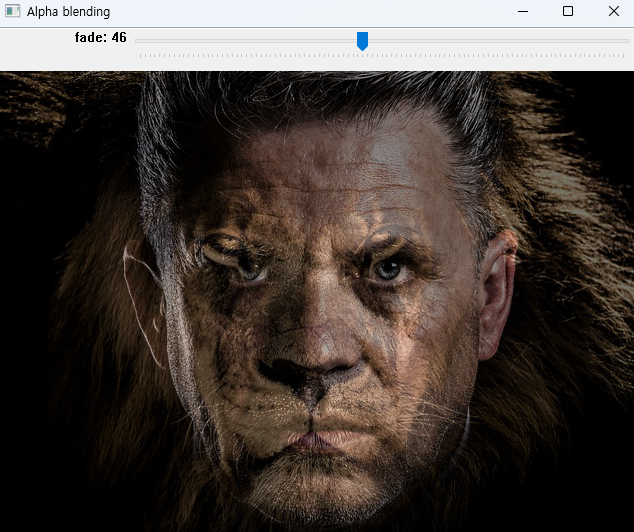

### 비트와이즈 연산

- 비트와이즈 연산은 두 이미지를 합성할 때 특정 영역만 선택하거나 특정 영역만 제외하는 등의 선별적인 연산에 도움을 줌
- 비트와이즈 설명 밑 그림 참조

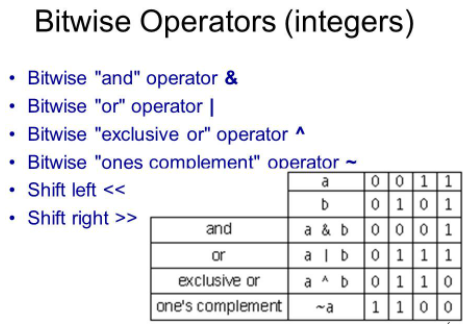


- OpenCV에서 제공하는 비트와이즈 연산 함수
    - cv2.bitwise_and(img1, img2, mask=None): 각 픽셀에 대해 AND 연산
    - cv2.bitwise_or(img1, img2, mask=None): 각 픽셀에 대해 OR 연산
    - cv2.bitwise_xor(img1, img2, mask=None): 각 픽셀에 대해 XOR 연산
    - cv2.bitwise_not(img1, img2, mask=None): 각 픽셀에 대해 NOT 연산
    
    - img1, img2는 연산을 수행할 이미지, 두 이미지는 동일한 shape
    - mask는 0이 아닌 픽셀만 연산

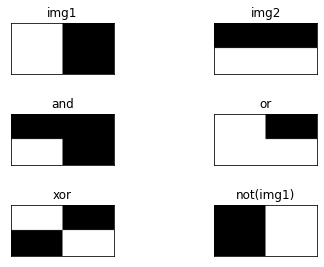

In [10]:
#--① 연산에 사용할 이미지 생성
img1 = np.zeros( ( 200,400), dtype=np.uint8)
img2 = np.zeros( ( 200,400), dtype=np.uint8)
img1[:, :200] = 255         # 왼쪽은 흰색(255), 오른쪽은 검정색(0)
img2[100:200, :] = 255      # 위쪽은 검정색(0), 아래쪽은 흰색(255)

#--② 비트와이즈 연산
bitAnd = cv2.bitwise_and(img1, img2)
bitOr = cv2.bitwise_or(img1, img2)
bitXor = cv2.bitwise_xor(img1, img2)
bitNot = cv2.bitwise_not(img1)

#--③ Plot으로 결과 출력
imgs = {'img1':img1, 'img2':img2, 'and':bitAnd, 
          'or':bitOr, 'xor':bitXor, 'not(img1)':bitNot}

for i, (title, img) in enumerate(imgs.items()):
    plt.subplot(3,2,i+1)
    plt.tight_layout(h_pad=2, w_pad=2)
    plt.title(title)
    plt.imshow(img, 'gray')
    plt.xticks([]); plt.yticks([])

plt.show()

- and는 둘다 1일때만 True 그래서 같이 흰색부분만 흰색으로 표시 나머지 검은색
- or은 흰색이 1번이라도 있으면 흰색
- xor 은 서로 반대될때만 1
- not은 반대

### bitwise_and 연산으로 마스킹하기

In [25]:
#--① 이미지 읽기
img = cv2.imread('./test_image.jpg')

#--② 마스크 만들기
mask = np.zeros_like(img)
cv2.circle(mask, (195,110), 90, (255,255,255), -1)  # cv2.circle(대상이미지, (원점x, 원점y), 반지름, (색상), 채우기)

#--③ 마스킹
masked = cv2.bitwise_and(img, mask)

#--④ 결과 출력
cv2.imshow('original', img)
cv2.imshow('mask', mask)
cv2.imshow('masked', masked)
cv2.waitKey()
cv2.destroyAllWindows()

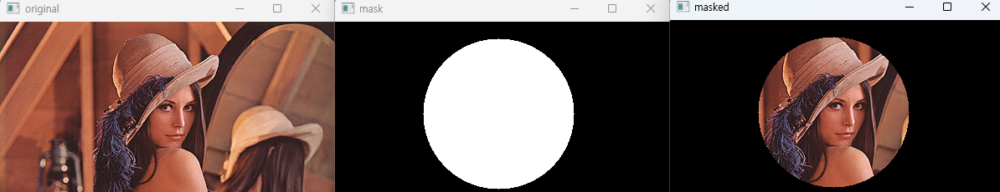

- 원본 이미지에서 검은색은 거의없음
- 두 번째 이미지인 흰색 원에서는 흰색 원 부분만 255의 값을 가지고 나머지는 0
- 원본 이미지와 원 이미지를 AND 연산하면 세 번째 이미지 계산

### 두 이미지의 차이

- 두 이미지의 픽셀 값을 빼면 음수가 나올수 있으므로 절댓값 취해줘야함
    
    ```python
    diff = cv2.absdiff(img1, img2)
    ```
     - img1, img2: 입력 이미지
     - diff: 두 이미지의 차의 절대 값
    

### 두 이미지의 차를 통해 도면의 차이 찾아내기

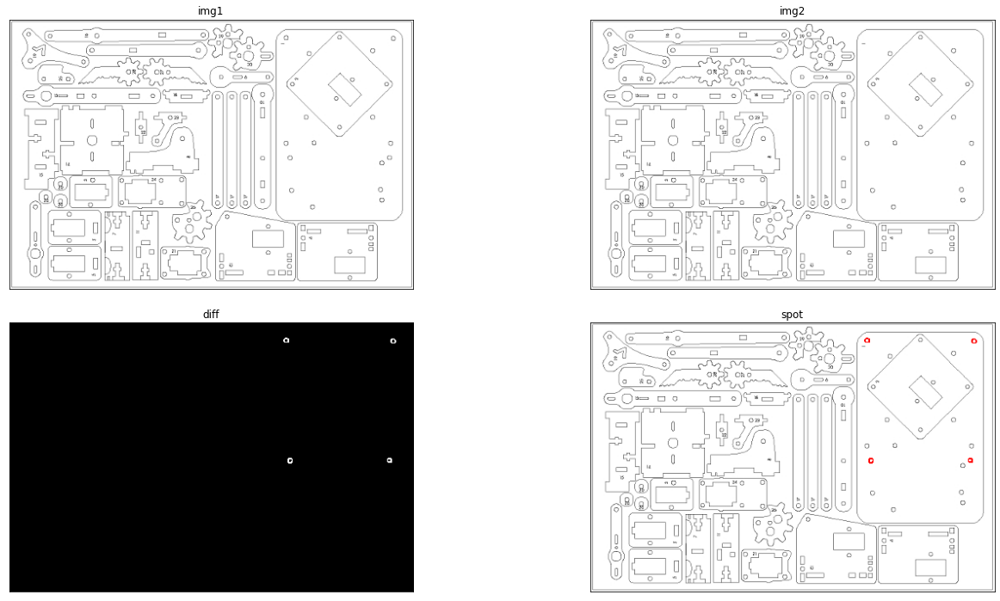

In [41]:
#--① 연산에 필요한 영상을 읽고 그레이스케일로 변환
img1 = cv2.imread('./robot_arm1.jpg')
img2 = cv2.imread('./robot_arm2.jpg')
img1_gray = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2_gray = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

#--② 두 영상의 절대값 차 연산
diff = cv2.absdiff(img1_gray, img2_gray)

#--③ 차 영상을 극대화 하기 위해 쓰레시홀드 처리 및 컬러로 변환
_, diff = cv2.threshold(diff, 1, 255, cv2.THRESH_BINARY)
diff_red = cv2.cvtColor(diff, cv2.COLOR_GRAY2BGR)
diff_red[:,:,0] = 0

#--④ 두 번째 이미지에 변화 부분 표시
spot = cv2.bitwise_xor(img2, diff_red)

#--⑤ 결과 영상 출력

imgs = {'img1':img1, 'img2':img2, 'diff':diff, 'spot':spot}
plt.figure(figsize=(20, 10))
for i, (title, img) in enumerate(imgs.items()):
    plt.subplot(2,2,i+1)
    plt.tight_layout(h_pad=2, w_pad=2)
    plt.title(title)
    plt.imshow(img, 'gray')
    plt.xticks([]); plt.yticks([])
    
plt.show()

- 두 이미지를 읽어온 뒤 그레이 스케일 적용 후 두 이미지 차 계산
- 차이를 뚜렷하게 하기 위해 cv2.threshold() 함수를 활용하여 픽셀 값이 1보다 큰 값은 255로 바꾸고 그렇지 않은 픽셀 값은 0으로 변경 (diff에서 255된 곳이 흰색)
- 색상을 표현하기 위해 cv2.cvtColor() 함수를 활용하여 색상 스케일을 맞추기 위해 차원을 변경, 색상 빨간색으로 변경
- 마지막으로 cv2.bitwise_xor() 연산수행 (img2 와 diff_red 비트와이즈 연산수행하면 서로 다른부분만 1)

### 이미지 합성과 마스킹

- 이미지는 배경과 전경으로 나눔
- 배경이 투명한 이미지를 활용하여 BGRA 색상 형식으로 표현할 때, 배경은 A(알파, alpha)가 0이고, 전경은 A가 255
- 이를 활용해서 배경을 분리할수있음

### 투명 배경 PNG 파일을 이용한 합성

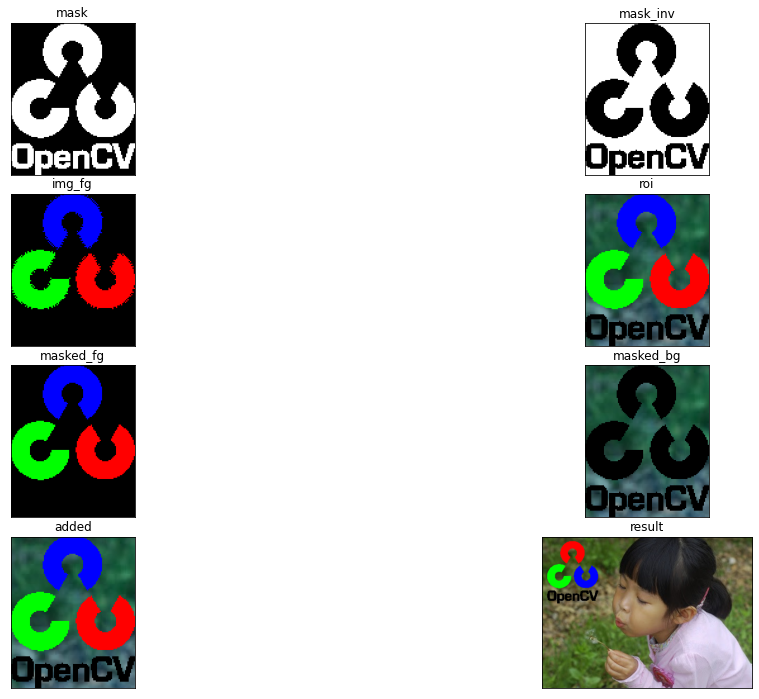

In [66]:
#--① 합성에 사용할 영상 읽기, 전경 영상은 4채널 png 파일
img_fg = cv2.imread('./opencv_logo (1).png', cv2.IMREAD_UNCHANGED)
img_bg = cv2.imread('./girl.jpg')

#--② 알파채널을 이용해서 마스크와 역마스크 생성
_, mask = cv2.threshold(img_fg[:,:,3], 1, 255, cv2.THRESH_BINARY)
mask_inv = cv2.bitwise_not(mask)

#--③ 전경 영상 크기로 배경 영상에서 ROI 잘라내기
img_fg = cv2.cvtColor(img_fg, cv2.COLOR_BGRA2BGR)
h, w = img_fg.shape[:2]
roi = img_bg[10:10+h, 10:10+w ]

#--④ 마스크 이용해서 오려내기
masked_fg = cv2.bitwise_and(img_fg, img_fg, mask=mask)
masked_bg = cv2.bitwise_and(roi, roi, mask=mask_inv)

#--⑥ 이미지 합성
added = masked_fg + masked_bg
img_bg[10:10+h, 10:10+w] = added

imgs = {'mask':mask, 'mask_inv':mask_inv, 'img_fg':img_fg, 'roi': roi, 'masked_fg':masked_fg, 'masked_bg':masked_bg, 'added':added, 'result':img_bg}
plt.figure(figsize=(20, 10))
for i, (title, img) in enumerate(imgs.items()):
    plt.subplot(4,2,i+1)
    plt.tight_layout(h_pad=0, w_pad=0)
    plt.title(title)
    if i == 7:
        plt.imshow(img[:,:,::-1], 'gray')
    else:
        plt.imshow(img, 'gray')
    plt.xticks([]); plt.yticks([])
    
plt.show()

- _, mask = cv2.threshod(img_fg[:, :, 3], 1, 255, cv2.THRESH_BINARY) 를 통해서 픽셀 값이 1보다 큰 값은 255로 바꾸고 그렇지 않은 픽셀 값은 0 이렇게 해서 배경과 전경을 분리하는 mask 생성, 배경 부분은 BRGA의 A값이 0 전경 부분은 A != 0
- mask_inv = cv2.bitwise_not(mask) 는 mask와 반대, 배경 A!=0 , 전경 A=0
- bitwise_and 계산을 통해 img_fg 와 img_fg 같은 부분만 이때 마스크는 글자와 로고 부분만 흰색임으로 해당 위치만 계산
- bitwise_and 계산을 통해 roi 와 roi 같은 부분만, mask_inv는 배경만 흰색 그래서 배경만 계산하고 글자 로고는 계산 안함

- 위의 masked_fg + masked_bg 합쳐서 added 얻음 , 이후 girl 이미지의 해당영역에 합성

### HSV 색상으로 마스킹

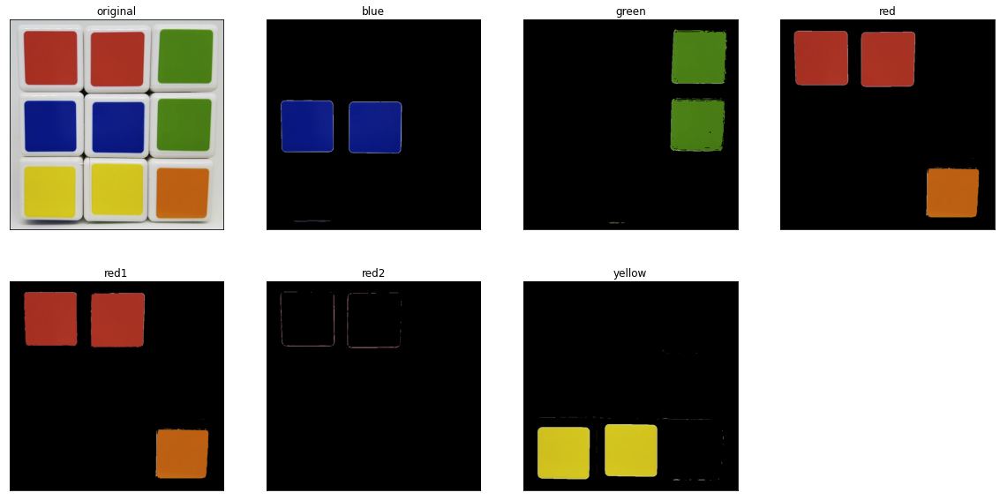

In [5]:
#--① 큐브 영상 읽어서 HSV로 변환
img = cv2.imread("./cube.jpg")
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

#--② 색상별 영역 지정
blue1 = np.array([90, 50, 50])
blue2 = np.array([120, 255,255])
green1 = np.array([45, 50,50])
green2 = np.array([75, 255,255])
red1 = np.array([0, 50,50])
red2 = np.array([15, 255,255])
red3 = np.array([165, 50,50])
red4 = np.array([180, 255,255])
yellow1 = np.array([20, 50,50])
yellow2 = np.array([35, 255,255])

# --③ 색상에 따른 마스크 생성
mask_blue = cv2.inRange(hsv, blue1, blue2)
mask_green = cv2.inRange(hsv, green1, green2)
mask_red = cv2.inRange(hsv, red1, red2)
mask_red2 = cv2.inRange(hsv, red3, red4)
mask_yellow = cv2.inRange(hsv, yellow1, yellow2)

#--④ 색상별 마스크로 색상만 추출
res_blue = cv2.bitwise_and(img, img, mask=mask_blue)
res_green = cv2.bitwise_and(img, img, mask=mask_green)
res_red1 = cv2.bitwise_and(img, img, mask=mask_red)
res_red2 = cv2.bitwise_and(img, img, mask=mask_red2)
res_red = cv2.bitwise_or(res_red1, res_red2)
res_yellow = cv2.bitwise_and(img, img, mask=mask_yellow)

#--⑤ 결과 출력
imgs = {'original': img, 'blue':res_blue, 'green':res_green, 'red':res_red, 'red1': res_red1, 'red2': res_red2 ,'yellow':res_yellow}
plt.figure(figsize=(20, 10))

for i, (k, v) in enumerate(imgs.items()):
    plt.subplot(2,4, i+1)
    plt.title(k)
    plt.imshow(v[:,:,::-1])
    plt.xticks([]); plt.yticks([])
plt.show()

- cv2.inRange(hsv, lower, upper)는 hsv의 모든 값 중 lower와 upper 범위 사이에 있는 값은 255 나머지 값은 0
    - red1 = np.array([0, 50,50]), red2 = np.array([15, 255,255]) 이걸 cv2.inRange(hsv, red1, red2) 로 한다면 hsv 값이 0 ~ 15, 50 ~ 255 , 50 ~ 255 사이만 값을 255로 나머지는 0

### 크로마키 마스킹과 합성

roi 좌표 x=163,y=26,w=477,h=426


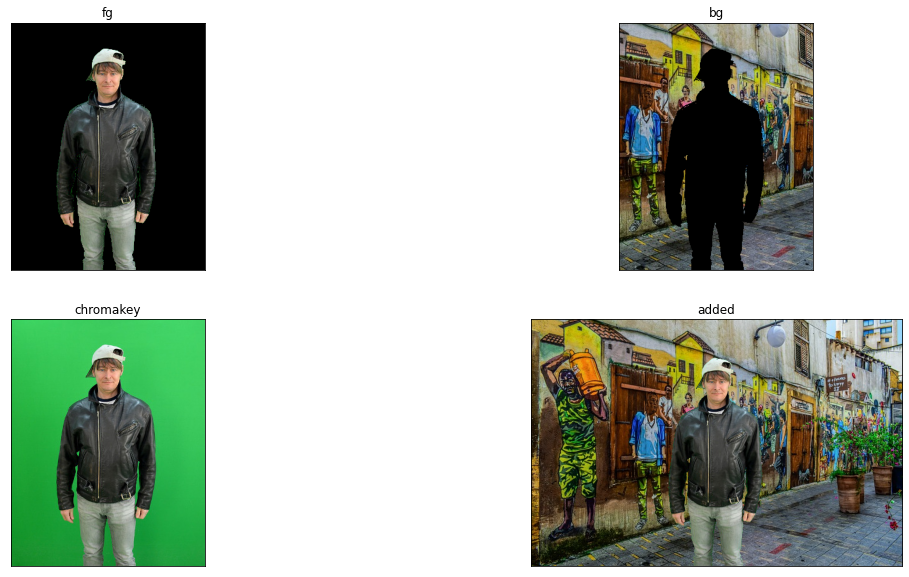

In [12]:
#--① 크로마키 배경 영상과 합성할 배경 영상 읽기
img1 = cv2.imread('./man_chromakey.jpg')
img2 = cv2.imread('./street.jpg')

#--② ROI 선택을 위한 좌표 계산
height1, width1 = img1.shape[:2]
height2, width2 = img2.shape[:2]
x = (width2 - width1)//2
y = height2 - height1
w = x + width1
h = y + height1
print(f'roi 좌표 x={x},y={y},w={w},h={h}')

#--③ 크로마키 배경 영상에서 크로마키 영역을 10픽셀 정도로 지정
chromakey = img1[:10, :10, :]
offset = 20

#--④ 크로마키 영역과 영상 전체를 HSV로 변경
hsv_chroma = cv2.cvtColor(chromakey, cv2.COLOR_BGR2HSV)
hsv_img = cv2.cvtColor(img1, cv2.COLOR_BGR2HSV)

#--⑤ 크로마키 영역의 H값에서 offset 만큼 여유를 두어서 범위 지정
# offset 값은 여러차례 시도 후 결정
#chroma_h = hsv_chroma[0]
chroma_h = hsv_chroma[:,:,0]
lower = np.array([chroma_h.min()-offset, 100, 100])
upper = np.array([chroma_h.max()+offset, 255, 255])

#--⑥ 마스크 생성 및 마스킹 후 합성
mask = cv2.inRange(hsv_img, lower, upper)
mask_inv = cv2.bitwise_not(mask)
roi = img2[y:h, x:w]
fg = cv2.bitwise_and(img1, img1, mask=mask_inv)
bg = cv2.bitwise_and(roi, roi, mask=mask)
img2[y:h, x:w] = fg + bg

#--⑦ 결과 출력
imgs = {'fg':fg, 'bg':bg, 'chromakey':img1, 'added':img2}
plt.figure(figsize=(20, 10))


for i, (k, v) in enumerate(imgs.items()):
    plt.subplot(2,2, i + 1)
    plt.imshow(v[:,:,::-1]) # BGR -> RGB
    plt.title(k)
    plt.xticks([]); plt.yticks([])

plt.show()

- ROI 위치를 x,y,w,h에 할당
- chromakey 영역 지정
- chromakey와 img1을 hsv로 변환
- 크로마키 영역을 h값에서 offset(사전 지정)한만큼 범위 여유를 둠
- inRange를 통해서 img안에 해당하는 색부분만 255
- not 연산을 통해서 반대만 출력 (mask가 배경을 가리킴 not 연산통해 사람부분만) 
- and연산으로 fg,bg각각 얻고 해당 좌표에 합성

- 이미지 합성에는 블렌딩과 마스킹이 필요
- 블렌딩을 위한 알파 값 선택과 마스킹을 위한 좌표, 색상 선택에는 많은 시간이 소요
- cv2.seamlessClone()을 통해 두 이미지의 특징을 살려 알아서 합성하는 기능 수행

```python
dst = cv2.seamlessClone(src, dst, mask, coords, flags, output)
```
    src: 입력 이미지, 일반적으로 전경
    dst: 대상 이미지, 일반적으로 배경
    mask: 마스크, src에서 합성하고자 하는 영역은 255, 나머지는 0
    coords: src가 놓이기 원하는 dst의 좌표 (중앙)
    flags: 합성 방식
    output(optional): 합성 결과

### SeamlessClone을 활용한 이미지 합성

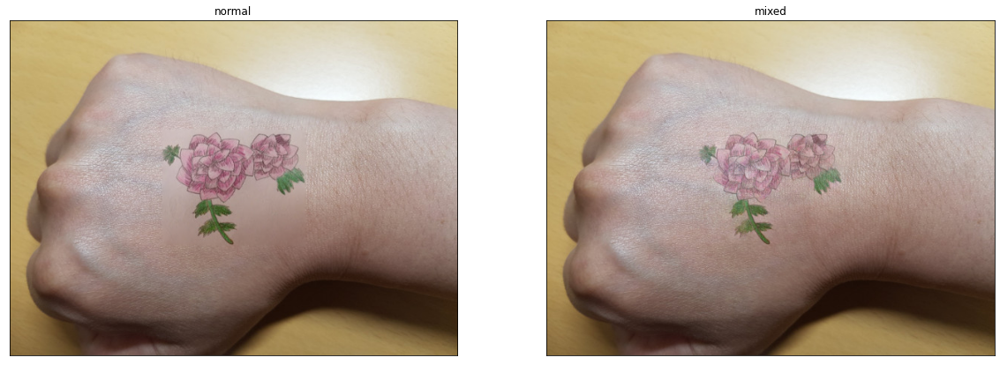

In [13]:
#--① 합성 대상 영상 읽기
img1 = cv2.imread("./drawing.jpg")
img2 = cv2.imread("./my_hand.jpg")

#--② 마스크 생성, 합성할 이미지 전체 영역을 255로 셋팅
mask = np.full_like(img1, 255)
 
#--③ 합성 대상 좌표 계산(img2의 중앙)
height, width = img2.shape[:2]
center = (width//2, height//2)
 
#--④ seamlessClone 으로 합성 
normal = cv2.seamlessClone(img1, img2, mask, center, cv2.NORMAL_CLONE)
mixed = cv2.seamlessClone(img1, img2, mask, center, cv2.MIXED_CLONE)

#--⑦ 결과 출력
imgs = {'normal':normal, 'mixed':mixed}
plt.figure(figsize=(20, 10))


for i, (k, v) in enumerate(imgs.items()):
    plt.subplot(1,2, i + 1)
    plt.imshow(v[:,:,::-1]) # BGR -> RGB
    plt.title(k)
    plt.xticks([]); plt.yticks([])

plt.show()

- 알파 값이나 마스크를 신경 쓰지 않아도 됨
- mask는 img1의 전체 영역을 255로 채워서 해당 영역 전부가 합성의 대상임을 표현
- 합성하려는 영역을 제외하고는 0으로 채우는 것이 더 좋음
- cv2.NORMAL_CLONE일 때는 꽃은 선명하지만 주변의 피부가 흐려짐
- cv2.MIXED_CLONE일 때는 꽃은 다소 흐리지만 주변 피부가 선명함

## 7. 히스토그램과 정규화(Normalize), 평탄화(Equalization), CLAHE

### 히스토그램

- 히스토그램은 도수 분포표를 그래프로 나타낸 것, 무엇이 몇 개 있는지 개수를 세어 놓은 것을 그래프로 나타낸 것 의미
- 이미지의 픽셀값을 히스토그램으로 표시하는 것은 이미지를 분석하는 데 도움을 줌
    - 전체 이미지에서 픽셀 값이 1인 픽셀이 몇 개이고, 2인 픽셀이 몇 개이고, 255인 픽셀이 몇 개인지까지 세는 것
    - 이를 통해 픽셀들의 색상이나 명암의 분포를 파악 가능

```python
cv2.calHist(img, channel, mask, histSize, ranges)
```

    img: 이미지 영상, [img]처럼 리스트로 감싸서 전달
    channel: 분석 처리할 채널, 리스트로 감싸서 전달 - 1 채널: [0], 2 채널: [0, 1], 3 채널: [0, 1, 2]
    mask: 마스크에 지정한 픽셀만 히스토그램 계산, None이면 전체 영역
    histSize: 계급(Bin)의 개수, 채널 개수에 맞게 리스트로 표현 - 1 채널: [256], 2 채널: [256, 256], 3 채널: [256, 256, 256]
    ranges: 각 픽셀이 가질 수 있는 값의 범위, RGB인 경우 [0, 256]

### 회색조 1채널 히스토그램

hist.shape: (256, 1)
hist.sum(): 270000.0 img.shape: (450, 600)


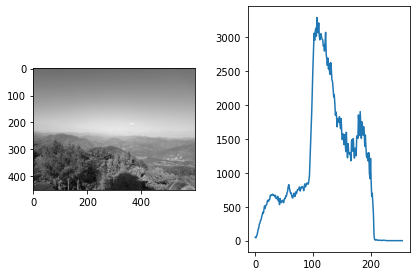

In [24]:
#--① 이미지 그레이 스케일로 읽기 및 출력
img = cv2.imread('./mountain.jpg', cv2.IMREAD_GRAYSCALE)

fig, axes = plt.subplots(1,2)
plt.tight_layout(h_pad=0, w_pad=3)

axes[0].imshow(img,cmap='gray')


#--② 히스토그램 계산 및 그리기
hist = cv2.calcHist([img], [0], None, [256], [0,256])
axes[1].plot(hist)

print("hist.shape:", hist.shape)  #--③ 히스토그램의 shape (256,1)
print("hist.sum():", hist.sum(), "img.shape:",img.shape) #--④ 히스토그램 총 합계와 이미지의 크기
plt.show()

- 그레이 스케일 한 이미지를 1차원 히스토그램으로 표현한 결과
- range가 [0, 256] : 0~255 까지
- cv2.calcHist()로 반환한 hist 객체는 plt.plot(hist)을 통해 그래프로 출력가능

### 색상 이미지 히스토그램

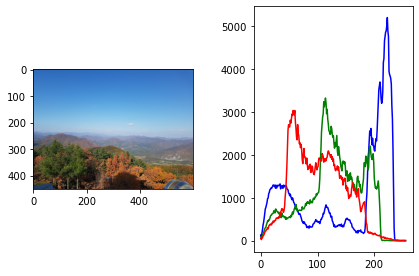

In [4]:
#--① 이미지 읽기 및 출력
img = cv2.imread('./mountain.jpg')

fig, axes = plt.subplots(1,2)
plt.tight_layout(h_pad=0, w_pad=3)

axes[0].imshow(img[:,:,::-1])

#--② 히스토그램 계산 및 그리기
channels = cv2.split(img)

colors = ('b', 'g', 'r')
for (ch, color) in zip (channels, colors):
    hist = cv2.calcHist([ch], [0], None, [256], [0, 256])
    axes[1].plot(hist, color = color)
plt.show()

- cv2.split(img) 함수를 호출하면 R, G, B 채널이 각각 나눔
- img는 색상 이미지이므로 3 채널 이미지인데, cv2.split(img)을 해주면 빨강, 파랑, 초록의 각 1 채널 이미지로 나눔
- 히스토그램을 보면 파란색 분포가 큰 것을 알 수 있음, 파란색 하늘 영역이 많아서

### 정규화(Normalization)

- 특정 영역에 몰려 있는 경우 화질을 개선하기도 하고, 이미지 간의 연산 시 서로 조건이 다른 경우 같은 조건으로 만들기도 가능
- OpenCV는 cv2.normalize()라는 함수로 정규화를 제공

```python
dst = cv2.normalize(src, dst, alpha, beta, type_flag)
```

    src: 정규화 이전의 데이터
    dst: 정규화 이후의 데이터
    alpha: 정규화 구간 1
    beta: 정규화 구간 2, 구간 정규화가 아닌 경우 사용 안 함
    type_flag: 정규화 알고리즘 선택 플래그 상수
    

- type_flag
    - alpha와 beta 구간으로 정규화하는 cv2.NORM_MINMAX
    - 전체 합으로 나누는 cv2.NORM_L1
    - 단위 벡터로 정규화하는 cv2.NORM_L2
    - 최댓값으로 나누는 cv2.NORM_INF

### 히스토그램 정규화

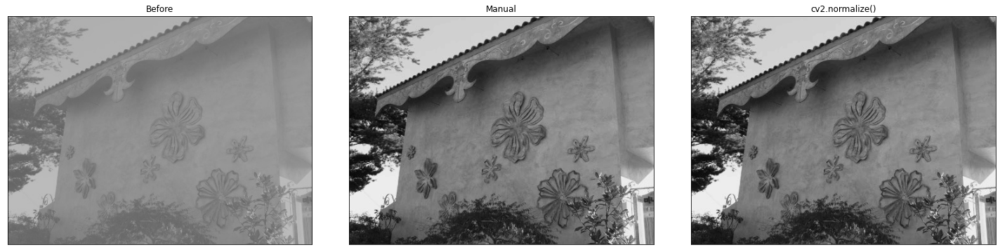

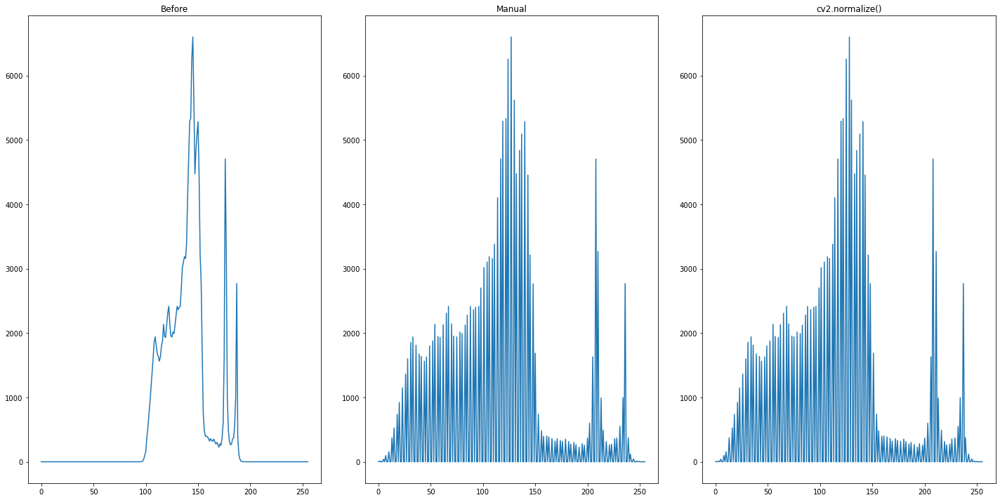

In [29]:
#--① 그레이 스케일로 영상 읽기
real = cv2.imread('./abnormal.jpg')
img = cv2.imread('./abnormal.jpg', cv2.IMREAD_GRAYSCALE)

#--② 직접 연산한 정규화
img_f = img.astype(np.float32)
img_norm = ((img_f - img_f.min()) * (255) / (img_f.max() - img_f.min()))
img_norm = img_norm.astype(np.uint8)

#--③ OpenCV API를 이용한 정규화
img_norm2 = cv2.normalize(img, None, 0, 255, cv2.NORM_MINMAX)

#--④ 히스토그램 계산
hist = cv2.calcHist([img], [0], None, [256], [0, 255])
hist_norm = cv2.calcHist([img_norm], [0], None, [256], [0, 255])
hist_norm2 = cv2.calcHist([img_norm2], [0], None, [256], [0, 255])



imgs = {'Before' : real, 'Manual' : img_norm, 'cv2.normalize()' : img_norm2}
plt.figure(figsize=(20, 10))
for i, (k, v) in enumerate(imgs.items()):
    plt.subplot(1,3, i + 1)
    plt.tight_layout(h_pad=0, w_pad=3)
    
    if i == 0:
        plt.imshow(v)
    else:
        plt.imshow(v,cmap='gray') # BGR -> RGB
    plt.title(k)
    plt.xticks([]); plt.yticks([])

plt.show()

hists = {'Before' : hist, 'Manual':hist_norm, 'cv2.normalize()':hist_norm2}
plt.figure(figsize=(20, 10))
for i, (k, v) in enumerate(hists.items()):
    plt.subplot(1,3,i+1)
    plt.tight_layout(h_pad=0, w_pad=3)
    plt.title(k)
    plt.plot(v)
plt.show()

- 왼쪽 : 원본이미지
- 가운데 : 공식 수동으로 계산한 정규화 이미지
- 오른쪽 cv2.normalize() 함수를 활용하여 정규화한 이미지


- 정규화 전에는 픽셀 값이 중앙에 몰려있음, 정규화 적용하면 픽셀 값이 전체적으로 고르게 퍼져서 화질이 개선됨

### 평탄화(Equalization)

- 정규화는 분포가 한곳에 집중되어 있는 경우에는 효과적
- 집중된 영역에서 멀리 떨어진 값이 있을 경우에는 효과가 없음
- 평탄화는 각각의 값이 전체 분포에 차지하는 비중에 따라 분포를 재분배하므로 명암 대비를 개선하는 데 효과적
- 이미지의 히스토그램이 특정 영역에 너무 집중되어 있으면 명암 대비가 낮아 좋은 이미지라고 할 수 없음
- 특정 영역에 집중되어 있는 분포를 골고루 분포하도록 하는 작업을 히스토그램 평탄화(Histogram Equalization)라고 함


```python
dst = cv2.equalizeHist(src, dst)
```
    src: 대상 이미지, 8비트 1 채널
    dst(optional): 결과 이미지

### 회색조 이미지에 평탄화 적용

(256,)


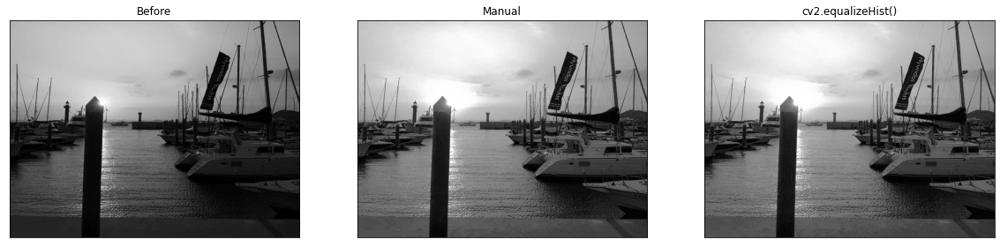

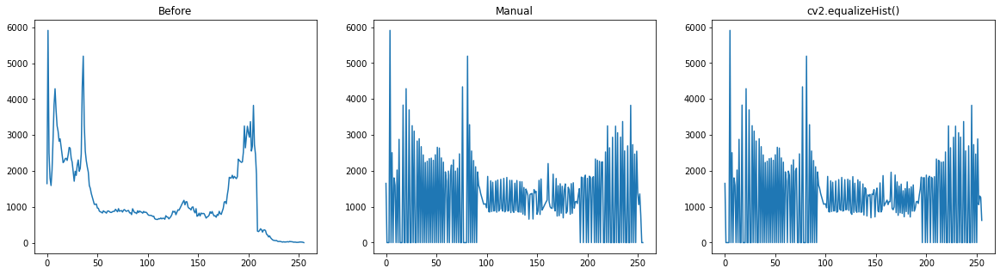

In [2]:
#--① 대상 영상으로 그레이 스케일로 읽기
img = cv2.imread('./yate.jpg', cv2.IMREAD_GRAYSCALE)
rows, cols = img.shape[:2]

#--② 이퀄라이즈 연산을 직접 적용
hist = cv2.calcHist([img], [0], None, [256], [0, 256]) #히스토그램 계산
cdf = hist.cumsum()                                     # 누적 히스토그램 
cdf_m = np.ma.masked_equal(cdf, 0)                      # 0(zero)인 값을 NaN으로 제거
cdf_m = (cdf_m - cdf_m.min()) /(rows * cols) * 255      # 이퀄라이즈 히스토그램 계산
cdf = np.ma.filled(cdf_m,0).astype('uint8')             # NaN을 다시 0으로 환원
print(cdf.shape)
img2 = cdf[img]                                         # 히스토그램을 픽셀로 맵핑

#--③ OpenCV API로 이퀄라이즈 히스토그램 적용
img3 = cv2.equalizeHist(img)

#--④ 이퀄라이즈 결과 히스토그램 계산
hist2 = cv2.calcHist([img2], [0], None, [256], [0, 256])
hist3 = cv2.calcHist([img3], [0], None, [256], [0, 256])

#--⑤ 결과 출력

imgs = {'Before' : img, 'Manual' : img2, 'cv2.equalizeHist()' : img3}
plt.figure(figsize=(20, 10))
plt.tight_layout(h_pad=0, w_pad=3)
for i, (k, v) in enumerate(imgs.items()):
    plt.subplot(1,3, i + 1)
    plt.imshow(v,cmap='gray') # BGR -> RGB
    plt.title(k)
    plt.xticks([])
    plt.yticks([])

plt.show()



hists = {'Before':hist, 'Manual':hist2, 'cv2.equalizeHist()':hist3}
plt.figure(figsize=(20, 5))
plt.tight_layout(h_pad=0, w_pad=3)
for i, (k, v) in enumerate(hists.items()):
    plt.subplot(1,3,i+1)
    plt.title(k)
    plt.plot(v)
plt.show()

- 명암 대비가 낮은 부둣가 이미지의 화질이 개선됨
- 원본 이미지와 비교했을때 전체적으로 선명한 것을 확인할수 있음

### 색상 이미지에 대한 평탄화 적용

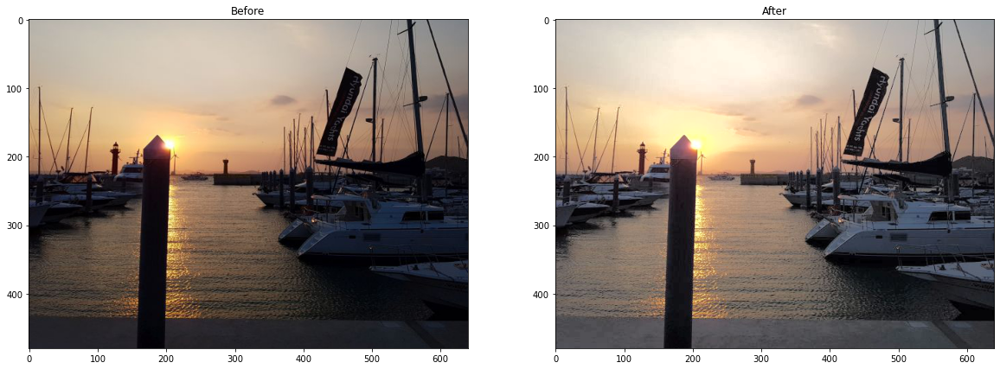

In [27]:
img = cv2.imread('./yate.jpg') #이미지 읽기, BGR 스케일

#--① 컬러 스케일을 BGR에서 YUV로 변경
img_yuv = cv2.cvtColor(img, cv2.COLOR_BGR2YUV) 

#--② YUV 컬러 스케일의 첫번째 채널에 대해서 이퀄라이즈 적용
img_yuv[:,:,0] = cv2.equalizeHist(img_yuv[:,:,0]) 

#--③ 컬러 스케일을 YUV에서 BGR로 변경
img2 = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2BGR) 


fig, axes = plt.subplots(1,2,figsize=(20, 10))
axes[0].imshow(img[:,:,::-1])
axes[1].imshow(img2[:,:,::-1])

axes[0].set_title("Before")
axes[1].set_title("After")
plt.show()

- 평탄화 적용 전(왼쪽 이미지) 보다 적용 후(오른쪽 이미지)가 더 선명
- 밝기가 더 개선되어 화질이 좋아진 것을 확인할수있음

### CLAHE (Contrast Limited Adaptive Histogram Equalization)

- 평탄화를 하면 이미지의 밝은 부분이 날아가는 현상이 발생
- 이미지의 밝은 부분이 날라가는 현상을 막기 위해 이미지를 일정한 영역으로 나누어 평탄화를 적용
    - 일정한 영역 내에서 극단적으로 어둡거나 밝은 부분이 있으면 노이즈가 생겨 원하는 결과를 얻을 수 없음
-  어떤 영역이든 지정된 제한 값을 넘으면 그 픽셀은 다른 영역에 균일하게 배분하여 적용, 이러한 평탄화 방식을 CLAHE


```python
clahe = cv2.createCLAHE(clipLimit, tileGridSize)
```
        clipLimit: 대비(Contrast) 제한 경계 값, default=40.0
        tileGridSize: 영역 크기, default=8 x 8
        clahe: 생성된 CLAHE 객체
```python
clahe.apply(src): CLAHE 적용
```
        src: 입력 이미지

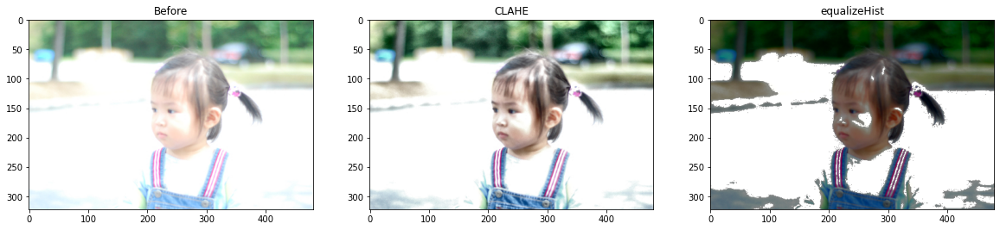

In [28]:
#--①이미지 읽어서 YUV 컬러스페이스로 변경
img = cv2.imread('./bright.jpg')
img_yuv = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)

#--② 밝기 채널에 대해서 이퀄라이즈 적용
img_eq = img_yuv.copy()
img_eq[:,:,0] = cv2.equalizeHist(img_eq[:,:,0])
img_eq = cv2.cvtColor(img_eq, cv2.COLOR_YUV2BGR)

#--③ 밝기 채널에 대해서 CLAHE 적용
img_clahe = img_yuv.copy()
clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8,8)) #CLAHE 생성
img_clahe[:,:,0] = clahe.apply(img_clahe[:,:,0])           #CLAHE 적용
img_clahe = cv2.cvtColor(img_clahe, cv2.COLOR_YUV2BGR)

#--④ 결과 출력

fig, axes = plt.subplots(1,3,figsize=(20, 10))
axes[0].imshow(img[:,:,::-1])
axes[1].imshow(img_clahe[:,:,::-1])
axes[2].imshow(img_eq[:,:,::-1])

axes[0].set_title("Before")
axes[1].set_title("CLAHE")
axes[2].set_title("equalizeHist")
plt.show()

- 오른쪽의 단순한 평탄화를 적용하면 밝은 부분은 날아가는 현상이 발생
-  CLAHE를 적용할 땐 이러한 현상이 개선되고 선명해짐

## 8. 2차원 히스토그램과 역투영(back project)

### 2차원 히스토그램 (2D Histogram)

- 1차원 히스토그램은 이미지 안에 픽셀이 각각 몇 개인지를 표현
-  2차원 히스토그램은 축이 2개이고, 각 축이 만나는 지점의 개수를 표현

### 2D 히스토그램

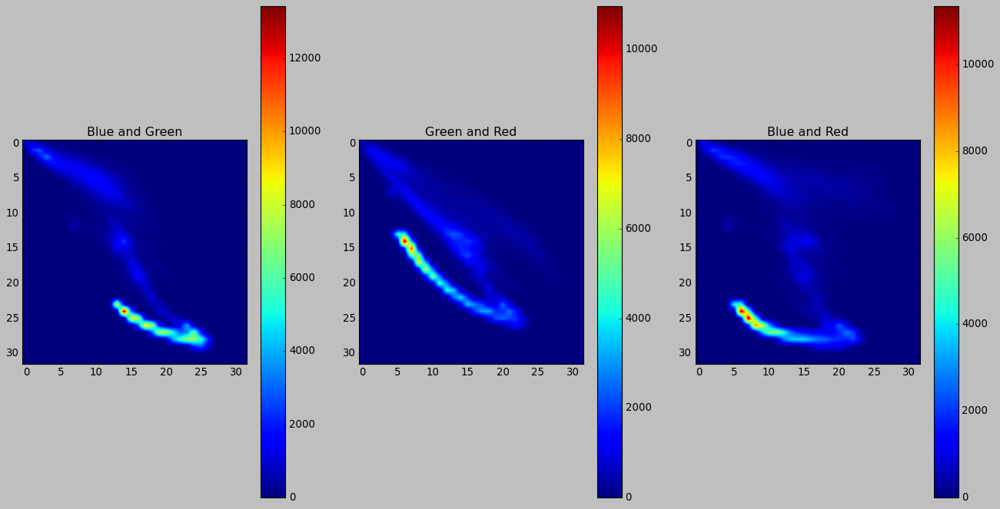

In [30]:
plt.style.use('classic')            # --①컬러 스타일을 1.x 스타일로 사용
img = cv2.imread('./mountain.jpg')
plt.figure(figsize=(20, 10))
plt.tight_layout(h_pad=0, w_pad=3)


plt.subplot(131)
hist = cv2.calcHist([img], [0,1], None, [32,32], [0,256,0,256]) #--②
p = plt.imshow(hist)                                            #--③
plt.title('Blue and Green')                                     #--④
plt.colorbar(p)                                                 #--⑤


plt.subplot(132)
hist = cv2.calcHist([img], [1,2], None, [32,32], [0,256,0,256]) #--⑥
p = plt.imshow(hist)
plt.title('Green and Red')
plt.colorbar(p)

plt.subplot(133)
hist = cv2.calcHist([img], [0,2], None, [32,32], [0,256,0,256]) #--⑦
p = plt.imshow(hist)
plt.title('Blue and Red')
plt.colorbar(p)

plt.show()

### 역투영(Back Projection)

- 관심 영역의 히스토그램과 유사한 히스토그램을 갖는 영역을 찾아내는 기법
- 역투영을 활용하면 이미지 내에서 특정 물체나 배경을 분리할 수 있음
- 색상을 기준으로 분리하기 때문에 잔디와 비슷한 색상을 가진 다른 물체가 있는 경우 성능이 떨어짐

### 마우스로 선택한 영역의 물체 분리하기

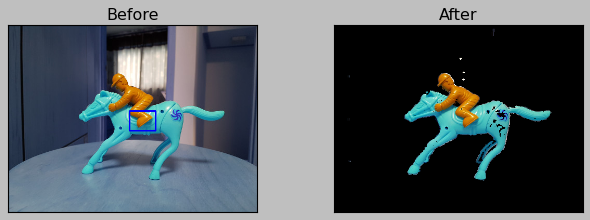

In [37]:
win_name = 'back_projection'
img = cv2.imread('./pump_horse.jpg')
hsv_img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
draw = img.copy()
fig, axes = plt.subplots(1,2)
plt.tight_layout(h_pad=0, w_pad=3)

# 역투영된 결과를 마스킹해서 결과를 출력하는 공통함수
def masking(bp, win_name):
    disc = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5,5))
    cv2.filter2D(bp,-1,disc,bp)
    _, mask = cv2.threshold(bp, 1, 255, cv2.THRESH_BINARY)
    result = cv2.bitwise_and(img, img, mask=mask)
    cv2.imshow(win_name, result)
    axes[1].imshow(result)

# OpenCV API로 구현한 함수
def backProject_cv(hist_roi):
    # 역투영 함수 호출 ---⑫
    bp = cv2.calcBackProject([hsv_img], [0, 1], hist_roi,  [0, 180, 0, 256], 1)
    # 역 투영 결과로 마스킹해서 결과 출력 ---⑬ 
    masking(bp,'result_cv')

# ROI 선택 
(x,y,w,h) = cv2.selectROI(win_name, img, False)
if w > 0 and h > 0:
    roi = draw[y:y+h, x:x+w]
    # 빨간 사각형으로 ROI 영역 표시
    cv2.rectangle(draw, (x, y), (x+w, y+h), (0,0,255), 2)
    # 선택한 ROI를 HSV 컬러 스페이스로 변경
    hsv_roi = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)
    # H,S 채널에 대한 히스토그램 계산
    hist_roi = cv2.calcHist([hsv_roi],[0, 1], None, [180, 256], [0, 180, 0, 256] )
    # ROI의 히스토그램을 매뉴얼 구현함수와 OpenCV 이용하는 함수에 각각 전달
    backProject_cv(hist_roi)
    
cv2.imshow(win_name, draw)
axes[0].imshow(draw)
cv2.waitKey()
cv2.destroyAllWindows()


axes[0].set_title('Before')
axes[1].set_title('After') 
axes[0].set_xticks([]) 
axes[0].set_yticks([]) 
axes[1].set_xticks([]) 
axes[1].set_yticks([]) 


plt.show()

- 마우스로 관심영역을 선택한 뒤, 관심 영역에 해당하는 물체만 추출
- 관심 영역을 HSV 형식으로 변경한 뒤 H, S 채널에 대한 2차원 히스토그램 생성
- 히스토그램을 OpenCV 함수의 파라미터로 전달

```python
cv2.calcBackProject(img, channel, hist, ranges, scale) -> 역투영을 직접 구현한 함수
```
        img: 입력 이미지, [img]처럼 리스트로 감싸서 사용
        channel: 처리할 채널, 리스트로 감싸서 사용
        hist: 역투영에 사용할 히스토그램
        ranges: 각 픽셀이 가질 수 있는 값의 범위
        scale: 결과에 적용할 배율 계수


- cv2.getStructuringElement()와 cv2.filter2D()는 마스크의 표면을 부드럽게 해주는 역할 수행


```python 
cv2.getStructuringElement(shape, ksize[,anchor]) -> 모폴로지( 영상을 형태학적인 측면으로 접근하는 것) 구조 요소를 생성해주는 함수
```
        shape : 구조화 요소 커널의 모양
            - cv2.MORPH_CROSS : 십자가형
            - cv2.MORPH_ELLIPSE : 타원형
            - cv2.MORPH_RECT : 직사각형
        Ksize : 구조화 요소 커널의 크기
        anchor : 구조화 요소 커너르이 기준점, default = (-1,-1)은 기준점을 중심으로 잡음
        
```python
cv2.filter2D(src, ddepth, kernel, dst=None, anchor=None, delta=None, borderType=None) -> 기본적인 2D 필터링 수행시 사용
```
        
        src : 입력 영상
        ddepth : 출력 영상 데이터 타입. (e.g) cv2.CV_8U, cv2.CV_32F, cv2.CV_64F, -1을 지정하면 src와 같은 타입의 dst 영상을 생성합니다.
        kernel: 필터 마스크 행렬. 실수형.
        anchor: 고정점 위치. (-1, -1)이면 필터 중앙을 고정점으로 사용
        delta: 추가적으로 더할 값
        borderType: 가장자리 픽셀 확장 방식
        dst: 출력 영상

### 역투영 장단점

- 알파 채널이나 크로마 키 같은 것이 없어도 복잡한 모양의 사물을 분리할 수 있다는 장점
- 역투영은 히스토그램을 기반으로 관심 영역의 색상과 비슷한 물체를 추출하므로, 관심 영역의 색상과 비슷한 다른 물체가 뒤섞여 있을 때는 효과가 떨어짐

## 9. 이미지 유사도 비교, 사람 얼굴과 해골 합성

### 이미지 유사도 비교 실습

- 픽셀 값의 분포가 서로 비슷하다면 유사한 이미지일 확률이 높고, 분포가 서로 다르다면 서로 다른 이미지일 확률이 높음
    --> 이러한 사실을 이용하여 이미지의 유사도를 측정가능, 두 이미지의 히스토그램을 비교하면 되는 것


```python
cv2.compareHist(hist1, hist2, method)
```
        hist1, hist2: 비교할 두 개의 히스토그램, 크기와 차원이 같아야 함
        method: 비교 알고리즘
            - cv2.HISTCMP_CORREL: 상관관계 (1: 완전 일치, -1: 완전 불일치, 0: 무관계)
            - cv2.HISTCMP_CHISQR: 카이제곱 (0: 완전 일치, 무한대: 완전 불일치)
            - cv2.HISTCMP_INTERSECT: 교차 (1: 완전 일치, 0: 완전 불일치 - 1로 정규화한 경우)

### 히스토그램 유사도 비교 

CORREL    	img1:   1.00	img2:   0.70	img3:   0.56	img4:   0.23	
CHISQR    	img1:   0.00	img2:  67.33	img3:  35.71	img4:1129.49	
INTERSECT 	img1:   1.00	img2:   0.54	img3:   0.40	img4:   0.18	
BHATTACHARYYA	img1:   0.00	img2:   0.48	img3:   0.47	img4:   0.79	


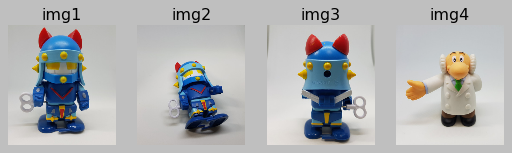

In [44]:
img1 = cv2.imread('./taekwonv1.jpg')
img2 = cv2.imread('./taekwonv2.jpg')
img3 = cv2.imread('./taekwonv3.jpg')
img4 = cv2.imread('./dr_ochanomizu.jpg')

imgs = [img1, img2, img3, img4]
hists = []
for i, img in enumerate(imgs) :
    plt.subplot(1,len(imgs),i+1)
    plt.title('img%d'% (i+1))
    plt.axis('off') 
    plt.imshow(img[:,:,::-1])
    
    #---① 각 이미지를 HSV로 변환
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    #---② H,S 채널에 대한 히스토그램 계산
    hist = cv2.calcHist([hsv], [0,1], None, [180,256], [0,180,0, 256])
    
    #---③ 0~1로 정규화
    cv2.normalize(hist, hist, 0, 1, cv2.NORM_MINMAX)
    hists.append(hist)

query = hists[0]
methods = {'CORREL' :cv2.HISTCMP_CORREL, 'CHISQR':cv2.HISTCMP_CHISQR, 
           'INTERSECT':cv2.HISTCMP_INTERSECT,
           'BHATTACHARYYA':cv2.HISTCMP_BHATTACHARYYA}

for j, (name, flag) in enumerate(methods.items()):
    print('%-10s'%name, end='\t')
    for i, (hist, img) in enumerate(zip(hists, imgs)):
        
        #---④ 각 메서드에 따라 img1과 각 이미지의 히스토그램 비교
        ret = cv2.compareHist(query, hist, flag)
        
        if flag == cv2.HISTCMP_INTERSECT: #교차 분석인 경우 
            ret = ret/np.sum(query)        #비교대상으로 나누어 1로 정규화
        print("img%d:%7.2f"% (i+1 , ret), end='\t')
    print()
plt.show()

- 각 이미지를 HSV 형식으로 변환한 뒤 H, V에 대하여 2차원 히스토그램을 계산해 정규화 수행
- query에 img1의 정규화된 히스토그램 할당
- compareHist로 query에 들어있는 img1의 히스토그램과 img1~4까지 비교수행
- img1이 원본과 동일, img4가 가장 비슷하지 않음

- 보통의 compareHist의 flag들은 정규화한 이미지를 원본과 비교하지만, cv2.HISTCMP_INTERSECT인 경우 원본 히스토그램으로 나누어주면 정규화가 되어 결과를 판별하기가 쉬워짐

### 사람 얼굴과 해골 합성

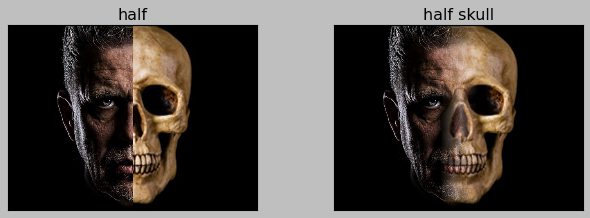

In [48]:
# 영상의 15%를 알파 블렌딩의 범위로 지정
alpha_width_rate = 15
fig, axes = plt.subplots(1,2)
plt.tight_layout(h_pad=0, w_pad=3)


# 합성할 두 영상 읽기
img_face = cv2.imread('./man_face.jpg')
img_skull = cv2.imread('./skull.jpg')

# 입력 영상과 같은 크기의 결과 영상 준비
img_comp = np.zeros_like(img_face)

# 연산에 필요한 좌표 계산
height, width = img_face.shape[:2]
middle = width//2                             # 영상의 중앙 좌표
alpha_width = width * alpha_width_rate // 100 # 알파 블렌딩 범위
start = middle - alpha_width//2               # 알파 블렌딩 시작 지점
step = 100/alpha_width                        # 알파 값 간격

# 입력 영상의 절반씩 복사해서 결과 영상에 합성
img_comp[:, :middle, : ] = img_face[:, :middle, :].copy()
img_comp[:, middle:, :] = img_skull[:, middle:, :].copy()

axes[0].imshow(img_comp[:,:,::-1])
axes[0].set_title('half')

# 알파 값을 바꾸면서 알파 블렌딩 적용
for i in range(alpha_width+1 ):
    alpha = (100 - step * i) / 100  # 증감 간격에 따른 알파 값 (1~0)
    beta = 1 - alpha                # 베타 값 (0~1)
    # 알파 블렌딩 적용
    img_comp[:, start+i] = img_face[:, start+i] * \
                                alpha + img_skull[:, start+i] * beta
    # print(i, alpha, beta)

axes[1].imshow(img_comp[:,:,::-1])
axes[1].set_title('half skull') 

axes[0].set_xticks([]) 
axes[0].set_yticks([]) 
axes[1].set_xticks([]) 
axes[1].set_yticks([]) 


plt.show()

- 위 코드에서 man_face 만큼의 빈 공간 img_comp 생성
- img_comp의 절반을 나눠 남자,해골 붙이기
- alpha,beta 조절하면서 알파 블렌딩 사용
- 부드럽게 합성됨

## 10. 이미지 이동(Translation), 확대/축소(Scaling), 회전(Rotation)

### 이미지 이동

- 원래 있던 좌표에 이동시키려는 거리만큼 더하기 

x_new = x_old + d₁
y_new = y_old + d₂

- 위 식을 핼렬식으로 표현하면


   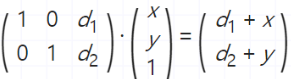
   
- 행렬식을 다시 풀어서 써보면'

x_new = x_old + d₁ = 1*x_old + 0*y_old + d₁


y_new = y_old + d₂ = 0*x_old + 1*y_old + d₂

- 위 식을 통해 이미지의 좌표를 이동하는 변환 행렬은 2X3 행렬
    - 변환 행렬 : 어떤 좌표를 선형 변환 해주는 행렬을 의미
    - 어떤 좌표를 다른 좌표로 이동시켜주는 행렬
    - 어떤 좌표에 변환 행렬을 곱해주면 다른 좌표가 구해지는 행렬
    

&nbsp;
- 이미지 이동에 대한 변환 행렬


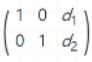

- OpenCV에서는 변환행렬을 이용해서 이미지를 변환하는 기능을 하는 cv2.warpAffine() 함수를 제공

```python
dst = cv2.warpAffine(src, matrix, dsize, dst, flags, borderMode, borderValue)
```
        src: 원본 이미지, numpy 배열
        matrix: 2 x 3 변환행렬, dtype=float32
        dsize: 결과 이미지의 크기, (width, height)
        flags(optional): 보간법 알고리즘 플래그
        borderMode(optional): 외곽 영역 보정 플래그
        borderValue(optional): cv2.BORDER_CONSTANT 외곽 영역 보정 플래그일 경우 사용할 색상 값 (default=0)
        dst: 결과 이미지
        
        flags의 값
            - cv2.INTER_LINEAR: default 값, 인접한 4개 픽셀 값에 거리 가중치 사용
            - cv2.INTER_NEAREST: 가장 가까운 픽셀 값 사용
            - cv2.INTER_AREA: 픽셀 영역 관계를 이용한 재샘플링
            - cv2.INTER_CUBIC: 인정합 16개 픽셀 값에 거리 가중치 사용
        
        borderMode의 값
            - cv2.BORDER_CONSTANT: 고정 색상 값
            - cv2.BORDER_REPLICATE: 가장자리 복제
            - cv2.BORDER_WRAP: 반복
            - cv2.BORDER_REFLECT: 반사
            
- 원본 이미지인 src를 변환 행렬 matrix에 따라 변환하는 함수
- 결과 이미지의 크기를 나타내는 파라미터는 dsize

### 평행 이동 

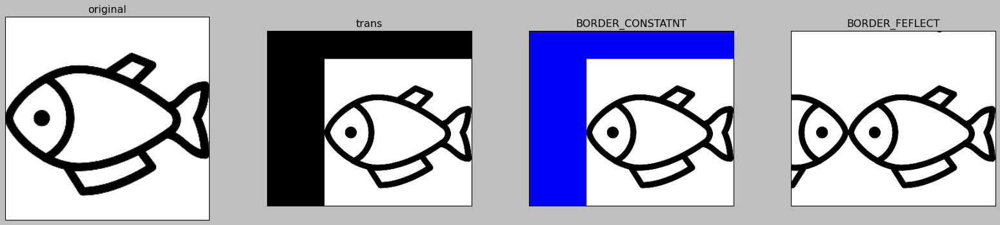

In [62]:
img = cv2.imread('./fish.jpg')
rows,cols = img.shape[0:2]  # 영상의 크기

dx, dy = 100, 50            # 이동할 픽셀 거리

# ---① 변환 행렬 생성 
mtrx = np.float32([[1, 0, dx],
                   [0, 1, dy]])  
# ---② 단순 이동
dst = cv2.warpAffine(img, mtrx, (cols+dx, rows+dy))   

# ---③ 탈락된 외곽 픽셀을 파랑색으로 보정
dst2 = cv2.warpAffine(img, mtrx, (cols+dx, rows+dy), None, \
                        cv2.INTER_LINEAR, cv2.BORDER_CONSTANT, (255,0,0) )

# ---④ 탈락된 외곽 픽셀을 원본을 반사 시켜서 보정
dst3 = cv2.warpAffine(img, mtrx, (cols+dx, rows+dy), None, \
                                cv2.INTER_LINEAR, cv2.BORDER_REFLECT)

imgs = {'original' : img, 'trans' : dst, 'BORDER_CONSTATNT' : dst2, 'BORDER_FEFLECT' : dst3}

fig, axes = plt.subplots(1,4,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- 물고기 이미지를 가로(x) 방향으로 100픽셀, 세로(y) 방향으로 50픽셀 평행 이동
- 가로의 양의 방향은 오른쪽이고, 세로의 양의 방향은 아래쪽
- 평행 이동을 시키면 기존 영역은 이미지가 잘림
- 잘리는 영역을 어떻게 보정할지를 borderMode 파라미터로 조정
- 외곽 영역 이외에는 픽셀의 탈락이 발생하지 않으므로 flags 파라미터는 무의미

### 이미지 확대 및 축소

- 기존의 좌표에 특정한 값을 곱하면 됨

x_new = a₁ * x_old


y_new = a₂ * y_old


- 이를 다시 풀어쓰면

x_new = a₁ * x_old = a₁ * x_old + 0 * y_old + 0 * 1


y_new = a₂ * y_old = 0 * x_old + a₂ * y_old + 0 * 1

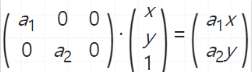


- 변환 행렬은 평행 이동할 때와 마찬가지로 2 x 3 행렬
- 2 x 2 행렬로 나타낼 수 있는데 굳이 2 x 3 행렬로 표현한 이유는 cv2.warpAffine() 함수는 변환 행렬이 2 x 3 행렬이 아니면 오류가 발생

### 행렬을 이용한 이미지 확대 및 축소

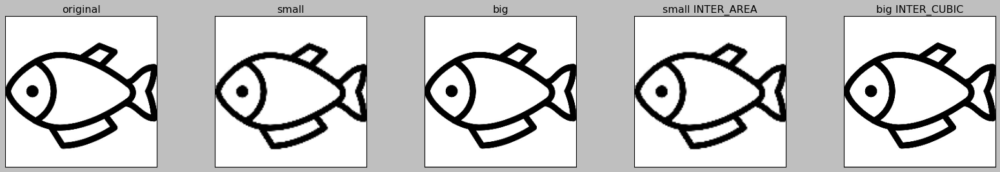

In [71]:
img = cv2.imread('./fish.jpg')
height, width = img.shape[:2]

# --① 0.5배 축소 변환 행렬
m_small = np.float32([[0.5, 0, 0],
                       [0, 0.5,0]])  
# --② 2배 확대 변환 행렬
m_big = np.float32([[2, 0, 0],
                     [0, 2, 0]])  

# --③ 보간법 적용 없이 확대 축소
dst1 = cv2.warpAffine(img, m_small, (int(height*0.5), int(width*0.5)))
dst2 = cv2.warpAffine(img, m_big, (int(height*2), int(width*2)))

# --④ 보간법 적용한 확대 축소
dst3 = cv2.warpAffine(img, m_small, (int(height*0.5), int(width*0.5)), \
                        None, cv2.INTER_AREA)
dst4 = cv2.warpAffine(img, m_big, (int(height*2), int(width*2)), \
                        None, cv2.INTER_CUBIC)

# 결과 출력
imgs = {'original' : img, 'small' : dst1, 'big' : dst2, 'small INTER_AREA' : dst3, "big INTER_CUBIC" : dst4}

fig, axes = plt.subplots(1,5,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- 위 코드에서는 똑같아 보이지만 2배, 1/2배 적용된 이미지가 나옴
- 일반적으로 보간법 파라미터로는 축소에는 cv2.INTER_AREA를 쓰고, 확대에는 cv2.INTER_CUBIC, cv2.INTER_LINEAR 사용

- 변환 행렬을 쓰지 않고도 확대 및 축소 cv2.resize() 함수 사용

```python
cv2.resize(src, dsize, dst, fx, fy, interpolation)
```

        src: 입력 원본 이미지
        dsize: 출력 영상 크기(확대/축소 목표 크기, (width, height)형식), 생략하면 fx, fy 배율을 적용
        fx, fy: 크기 배율, dsize가 주어지면 dsize를 적용함
        interpolation: 보간법 알고리즘 선택 플래그 (cv2.warpAffine()과 동일)
        dst: 결과 이미지
        
        
- cv2.resize() 함수를 사용하면 확대/축소를 몇 픽셀로 할지 혹은 어떤 배율로 할지 선택 가능
- dsize는 확대/축소를 원하는 목표 이미지의 크기,  fx, fy는 변경할 배율
    -  fx = 2, fy = 0.5 -> x축으로 2배, y축으로 0.5배 스케일링

### cv2.reize()로 이미지 확대 및 축소

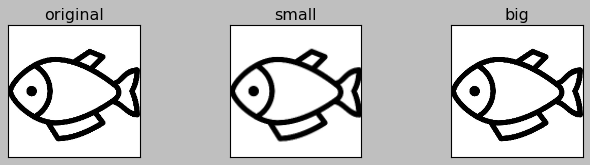

In [74]:
img = cv2.imread('./fish.jpg')
height, width = img.shape[:2]

#--① 크기 지정으로 축소
dst1 = cv2.resize(img, (int(width*0.5), int(height*0.5)), \
                         interpolation=cv2.INTER_AREA)

#--② 배율 지정으로 확대
dst2 = cv2.resize(img, None,  None, 2, 2, cv2.INTER_CUBIC)


#--③ 결과 출력
imgs = {'original' : img, 'small' : dst1, 'big' : dst2}

fig, axes = plt.subplots(1,3)
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- 같은 크기로 나오지만 원본의 1/2, 2 배를 적용한 이미지가 나옴
- cv2.resize() 함수는 변환 행렬을 이용하여 이미지 스케일링을 하는 것보다 더 간결

### 이미지 회전

- 이미지 회전을 위한 변환 행렬식


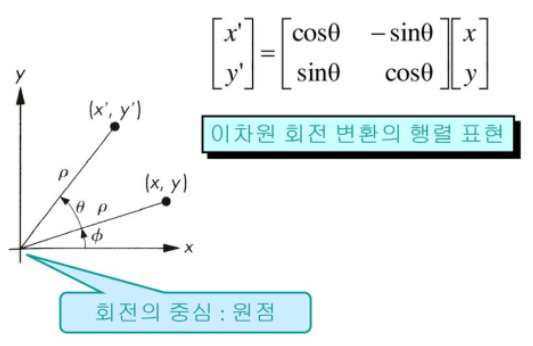

- OpenCV는 간단하게 변환행렬을 생성할 수 있게 아래와 같은 함수를 제공

```python
mtrx = cv2.getRotationMatrix2D(center, angle, scale)
```
        center: 회전축 중심 좌표 (x, y)
        angle: 회전할 각도, 60진법
        scale: 확대 및 축소비율

### 변환행렬을 이용한 이미지 회전

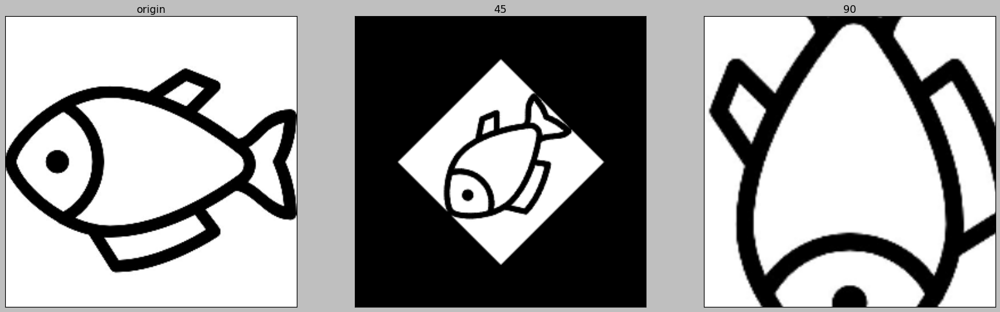

In [82]:
img = cv2.imread('./fish.jpg')
rows,cols = img.shape[0:2]

#---① 회전을 위한 변환 행렬 구하기
# 회전축:중앙, 각도:45, 배율:0.5
m45 = cv2.getRotationMatrix2D((cols/2,rows/2),45,0.5) 
# 회전축:중앙, 각도:90, 배율:1.5
m90 = cv2.getRotationMatrix2D((cols/2,rows/2),90,1.5) 

#---② 변환 행렬 적용
img45 = cv2.warpAffine(img, m45,(cols, rows))
img90 = cv2.warpAffine(img, m90,(cols, rows))

#---③ 결과 출력
# cv2.imshow('origin',img)
# cv2.imshow("45", img45)
# cv2.imshow("90", img90)
# cv2.waitKey(0)
# cv2.destroyAllWindows()


imgs = {'origin' : img, '45':img45, '90':img90}

fig, axes = plt.subplots(1,3,figsize=(20, 10))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

## 11. 이미지 뒤틀기(어핀 변환, 원근 변환)

- 이동, 확대/축소, 회전을 한 후에는 이미지의 모양이 그대로 유지됨 하지만 이미지 뒤틀기를 하면 기존 모양과 달라짐
- 이미지 뒤틀기에는 크게 두 가지가 있는데 어핀 변환과 원근 변환 존재

### 어핀 변환(Affine Transform)

```python
martix = cv2.getAffineTransform(pts1, pts2)
```
        pts1: 변환 전 영상의 좌표 3개, 3 x 2 배열
        pts2: 변환 후 영상의 좌표 3개, 3 x 2 배열
        matrix: 변환 행렬 반환, 2 x 3 행렬
- 3개의 좌표인 pts1이 pts2로 위치가 변한 만큼 이미지를 뒤트는 기능을 제공

### 어핀 변환

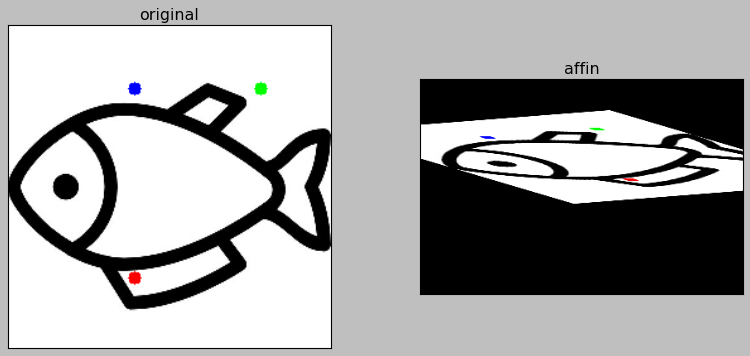

In [87]:
file_name = './fish.jpg'
img = cv2.imread(file_name)
rows, cols = img.shape[:2]

# ---① 변환 전, 후 각 3개의 좌표 생성
pts1 = np.float32([[100, 50], [200, 50], [100, 200]])
pts2 = np.float32([[80, 70], [210, 60], [250, 120]])

# ---② 변환 전 좌표를 이미지에 표시
cv2.circle(img, (100,50), 5, (255,0), -1)
cv2.circle(img, (200,50), 5, (0,255,0), -1)
cv2.circle(img, (100,200), 5, (0,0,255), -1)

#---③ 짝지은 3개의 좌표로 변환 행렬 계산
mtrx = cv2.getAffineTransform(pts1, pts2)

#---④ 어핀 변환 적용
dst = cv2.warpAffine(img, mtrx, (int(cols*1.5), rows))

#---⑤ 결과 출력
imgs = {'original' : img, 'affin' : dst}

fig, axes = plt.subplots(1,2,figsize=(10, 5))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

### 원근 변환(Perspective Transform)

- 어핀 변환은 이미지를 2차원으로 뒤트는 변환
- 원근 변환은 이미지를 3차원으로 변환, 멀리 있는 것은 작게 보이고, 가까이 있는 것은 크게 보이는 게 원근법의 원리
    - 원근법의 원리를 적용해 변환하는 방식이 원근 변환
    
    
```python
mtrx = cv2.getPerspectiveTransform(pts1, pts2)
```
        pts1: 변환 이전 영상의 좌표 4개, 4 x 2 배열
        pts2: 변환 이후 영상의 좌표 4개, 4 x 2 배열
        mtrx: 변환행렬 반환, 3 x 3 행렬
        
- 변환행렬을 cv2.warpAffine() 함수에 전달해주었는데, 원근 변환은 별도의 함수 cv2.warpPerspective() 함수사용 파라미터는 cv2.warpAffine() 동일

### 원근변환

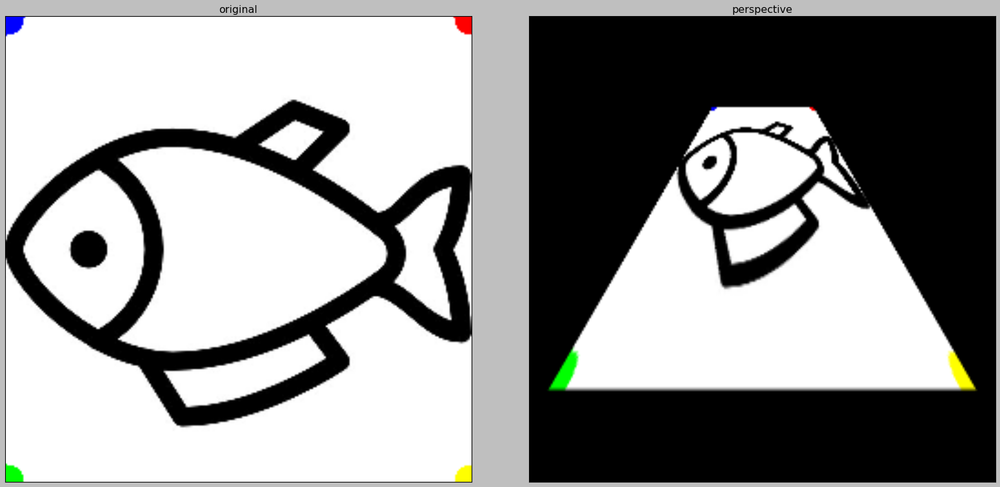

In [89]:
file_name = "./fish.jpg"
img = cv2.imread(file_name)
rows, cols = img.shape[:2]

#---① 원근 변환 전 후 4개 좌표
pts1 = np.float32([[0,0], [0,rows], [cols, 0], [cols,rows]])
pts2 = np.float32([[100,50], [10,rows-50], [cols-100, 50], [cols-10,rows-50]])

#---② 변환 전 좌표를 원본 이미지에 표시
cv2.circle(img, (0,0), 10, (255,0,0), -1)
cv2.circle(img, (0,rows), 10, (0,255,0), -1)
cv2.circle(img, (cols,0), 10, (0,0,255), -1)
cv2.circle(img, (cols,rows), 10, (0,255,255), -1)

#---③ 원근 변환 행렬 계산
mtrx = cv2.getPerspectiveTransform(pts1, pts2)
#---④ 원근 변환 적용
dst = cv2.warpPerspective(img, mtrx, (cols, rows))


imgs = {'original' : img, 'perspective' : dst}

fig, axes = plt.subplots(1,2,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

-  이미지의 위쪽 부분의 폭이 좁아져서 마치 멀리 있는 것처럼 보임, 이게 원근 변환
-  실제 많이 쓰이는 것은 원근 이미지를 평면 이미지로 변환할때 많이 사용

### 삼각형 어핀 변환

- OpenCV가 제공하는 기하학적 변환은 기본적으로 사각형이 기준
- 과정
    1. 어핀 변환 전 삼각형 좌표 3개를 정한다.
    2. 어핀 변환 후 삼각형 좌표 3개를 정한다.
    3. 변환 전 삼각형 좌표를 감싸는 외접 사각형 좌표를 구한다.
    4. 변환 후 삼각형 좌표를 감싸는 외접 사각형 좌표를 구한다.
    5. 과정 3, 4의 사각형 영역을 관심 영역(ROI, regison of interest)으로 지정한다.
    6. 과정 5의 관심 영역을 기준으로 변환 전, 후의 삼각형 좌표를 다시 계산한다.
    7. 과정 6의 변환 전 삼각형 좌표를 변환 후 삼각형 좌표로 어핀 변환해주는 변환 행렬을 구한다.
    8. 과정 7에서 구한 변환행렬을 적용해 어핀 변환을 한다.
    9. 과정 8에서 변환된 관심 영역에서 과정 2의 삼각형 좌표만 마스킹한다.
    10. 과정 9에서 구한 마스크를 이용해서 어핀 변환한 이미지와 원본 이미지를 합성한다.
    
    
```python
x, y, w, h = cv2.boudingRect(pts) -> 위의 3, 4처럼 삼각형 좌표를 감싸는 외접 사각형 좌표 구할때 사용
```
        pts: 다각형 좌표
        x, y, w, h = 외접 사각형의 좌표와 폭과 높이
        
```python
cv2.fillConvexPoly(img, pts, color, lineTypes) -> 9의 마스크를 구하기 위해 사용
```
        img: 입력 이미지
        pts: 다각형 좌표
        color: 다각형을 채울 색상
        lineType(optional): 선 그리기 알고리즘 선택 플래그

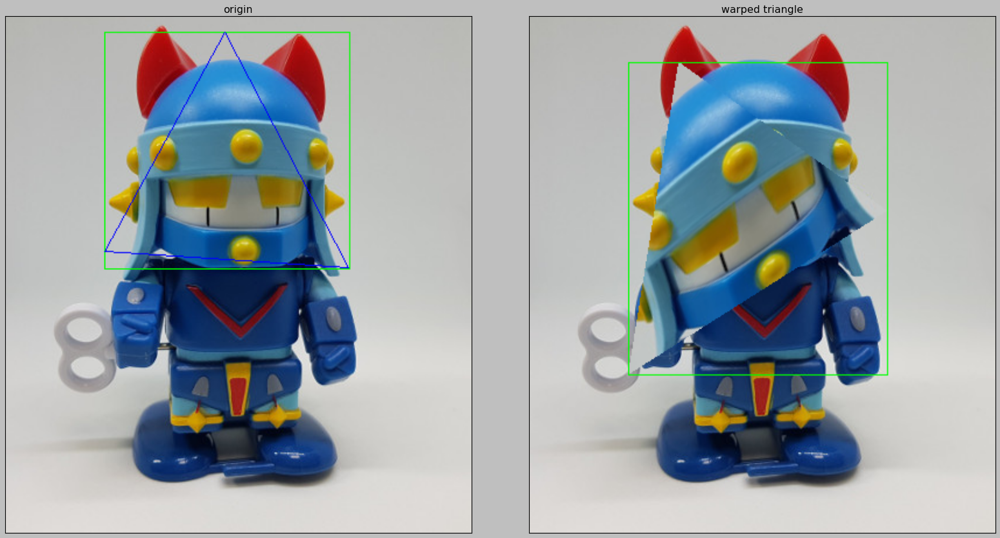

In [103]:
img = cv2.imread("./taekwonv1.jpg")
img2 = img.copy()
draw = img.copy()

# 변환 전,후 삼각형 좌표 ---①
pts1 = np.float32([[188,14], [85,202], [294,216]])
pts2 = np.float32([[128,40], [85,307], [306,167]])

# 각 삼각형을 완전히 감싸는 사각형 좌표 구하기 ---②
x1,y1,w1,h1 = cv2.boundingRect(pts1)
x2,y2,w2,h2 = cv2.boundingRect(pts2)

# 사각형을 이용한 관심영역 설정 ---③
roi1 = img[y1:y1+h1, x1:x1+w1]
roi2 = img2[y2:y2+h2, x2:x2+w2]

# 관심영역을 기준으로 좌표 계산 ---④
offset1 = np.zeros((3,2), dtype=np.float32)
offset2 = np.zeros((3,2), dtype=np.float32)
for i in range(3):
    offset1[i][0], offset1[i][1] = pts1[i][0]-x1, pts1[i][1]-y1
    offset2[i][0], offset2[i][1] = pts2[i][0]-x2, pts2[i][1]-y2

# 관심 영역을 주어진 삼각형 좌표로 어핀 변환 ---⑤
mtrx = cv2.getAffineTransform(offset1, offset2)
warped = cv2.warpAffine( roi1, mtrx, (w2, h2), None, \
                        cv2.INTER_LINEAR, cv2.BORDER_REFLECT_101)

# 어핀 변환 후 삼각형만 골라 내기 위한 마스크 생성 ---⑥
mask = np.zeros((h2, w2), dtype = np.uint8)
cv2.fillConvexPoly(mask, np.int32(offset2), (255))

# 삼각형 영역만 마스킹해서 합성 ---⑦
warped_masked = cv2.bitwise_and(warped, warped, mask=mask)
roi2_masked = cv2.bitwise_and(roi2, roi2, mask=cv2.bitwise_not(mask))
roi2_masked = roi2_masked + warped_masked
img2[y2:y2+h2, x2:x2+w2] = roi2_masked

# 관심 영역과 삼각형에 선 그려서 출력 ---⑧
cv2.rectangle(draw, (x1, y1), (x1+w1, y1+h1), (0,255,0), 1)
cv2.polylines(draw, [pts1.astype(np.int32)], True, (255,0,0), 1)
cv2.rectangle(img2, (x2, y2), (x2+w2, y2+h2), (0,255,0), 1)

imgs = {'origin' : draw, 'warped triangle' : img2}

fig, axes = plt.subplots(1,2,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

## 12. 리매핑(Remapping), 오목/볼록 렌즈 왜곡(Lens Distortion), 방사 왜곡(Radial Distortion)

### 렌즈 왜곡(Lens Distortion)

- 변환 행렬로는 구할 수 없는 모양의 변환, 렌즈 왜곡 변환이 바로 변환 행렬로는 구할 수 없는 변환
- 렌즈 왜곡 변환에는 리매핑, 오목 렌즈/볼록 렌즈 왜곡, 방사 왜곡 존재

### 리매핑(Remapping)

- 규칙성 없이 마음대로 이미지의 모양을 변환하는 것
- OpenCV는 cv2.remap()이라는 함수를 제공

```python
dst = cv2.remap(src, mapx, mapy, interpolation, dst, borderMode, borderValue)
```
        src: 입력 이미지
        mapx, mapy: x축과 y축으로 이동할 좌표, src와 동일한 크기, dtype=float32
        dst(optional): 결과 이미지
        나머지 인자는 cv2.warpAffine()과 동일
        
ex) mapx[0][0]=10, mapy[0][0]=5 라고 지정하면 ,  src 좌표 (0, 0)에 있는 픽셀을 (10, 5) 이동하는걸 의미


    - mapx와 mapy는 초기 값으로 0 같은 의미 없는 값이 아니라 원래 이미지의 좌표 값 주는 것이 좋음, 전체 픽셀 중 옮기고 싶은 픽셀에 대해서만 새로운 좌표를 지정하거나 원래 위치에서 얼마만큼 이동하라고 명령하는 것이 편하기 때문
    - mapx와 mapy를 np.zeros()로 초기화한 뒤 for문으로 초기화할 수 있지만 이렇게 하면 시간이 너무 오래 소요
    - np.indices() 함수를 쓰면 빠르게 초기화 가능
```python
mapy, mapx = np.indices( (rows, cols), dtype=np.float32)
```

- np.indices 사용예

```python
np.indices((2,2))

array([[[0, 0],
        [1, 1]],

       [[0, 1],
        [0, 1]]])
        
        
np.indices((3, 3))

array([[[0, 0, 0],
        [1, 1, 1],
        [2, 2, 2]],

       [[0, 1, 2],
        [0, 1, 2],
        [0, 1, 2]]])
```

리매핑으로 이미지 뒤집기

matrix: 0.0010006427764892578
remap: 0.0010006427764892578


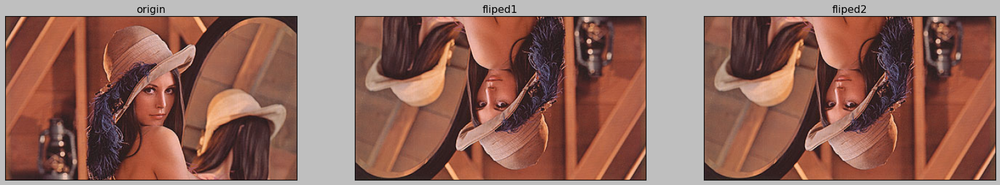

In [110]:
img = cv2.imread('./test_image.jpg')
rows, cols = img.shape[:2]



# 뒤집기 변환 행렬로 구현 ---①
st = time.time()
mflip = np.float32([ [-1, 0, cols-1],[0, -1, rows-1]]) # 변환 행렬 생성
fliped1 = cv2.warpAffine(img, mflip, (cols, rows))     # 변환 적용
print('matrix:', time.time()-st)

# remap 함수로 뒤집기 구현 ---②
st2 = time.time()
mapy, mapx = np.indices((rows, cols),dtype=np.float32) # 매핑 배열 초기화 생성
mapx = cols - mapx -1                                  # x축 좌표 뒤집기 연산
mapy = rows - mapy -1                                  # y축 좌표 뒤집기 연산
fliped2 = cv2.remap(img,mapx,mapy,cv2.INTER_LINEAR)  # remap 적용
print('remap:', time.time()-st2)


# 결과 출력 ---③
imgs = {'origin' : img, 'fliped1' : fliped1, 'fliped2': fliped2}

fig, axes = plt.subplots(1,3,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- 뒤집을때 사용한 연산


    x' = cols - x - 1
    y' = rows - y - 1
    
- 변환행렬을 이용하여 뒤집은 이미지와 cv2.remap() 함수로 리매핑하여 뒤집은 이미지의 결과는 같음
- cv2.remap() 함수로 변환하는 것은 변환 행렬로 변환하는 것보다 수행 속도가 더 느림
- 변환행렬로 표현할 수 있는 것은 변환행렬로 변환을 하는 것이 좋고 변환행렬로 표현할 수 없는 비선형 변환에만 cv2.remap() 함수를 사용

### 삼각함수를 이용한 비선형 리매핑
    - 변환 행렬로 표현할 수 없는 비선형 변환

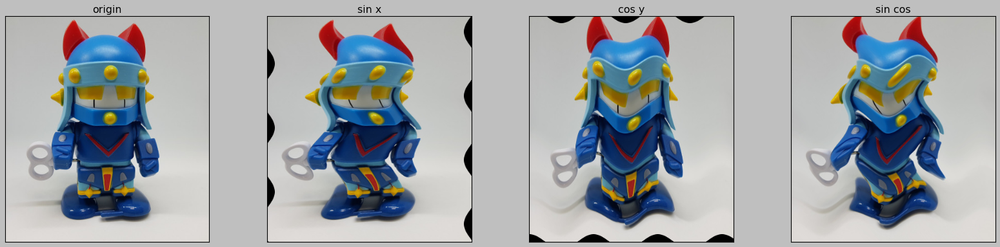

In [111]:
l = 20      # 파장(wave length)
amp = 15    # 진폭(amplitude)

img = cv2.imread('./taekwonv1.jpg')
rows, cols = img.shape[:2]

# 초기 매핑 배열 생성 ---①
mapy, mapx = np.indices((rows, cols),dtype=np.float32)

# sin, cos 함수를 적용한 변형 매핑 연산 ---②
sinx = mapx + amp * np.sin(mapy/l)  
cosy = mapy + amp * np.cos(mapx/l)

# 영상 매핑 ---③
img_sinx=cv2.remap(img, sinx, mapy, cv2.INTER_LINEAR) # x축만 sin 곡선 적용
img_cosy=cv2.remap(img, mapx, cosy, cv2.INTER_LINEAR) # y축만 cos 곡선 적용

# x,y 축 모두 sin, cos 곡선 적용 및 외곽 영역 보정
img_both=cv2.remap(img, sinx, cosy, cv2.INTER_LINEAR, \
                    None, cv2.BORDER_REPLICATE)
# 결과 출력 
imgs = {'origin' : img, 'sin x' : img_sinx, 'cos y' : img_cosy, 'sin cos' : img_both}

fig, axes = plt.subplots(1,4,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- x좌표, y좌표에 sin, cos 함수를 적용하여 새로운 사인파 코사인파 곡선으로 왜곡된 이미지 생성
- 마지막 이미지에는 sin, cos 함수를 모두 적용, cv2.BORDER_REPLICATE 파라미터로 외곽 보정 적용해서 외곽의 사라진 영역 보정

### 오목 렌즈와 볼록 렌즈 왜곡

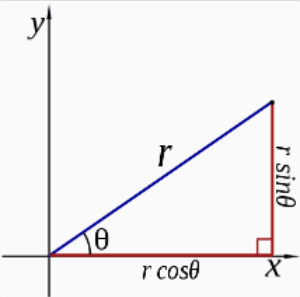

- x축과 y축의 직각으로 각각 선을 그어서 만나는 지점을 좌표 (x, y)로 나타냅니다. 이러한 형태의 좌표 시스템을 직교 좌표계
- 원점으로부터의 거리(r)와 사잇각(Θ)을 이용해서 (r, Θ)로 나타내는 방법이 있는데, 이를 극좌표계
- 두 좌표계는 상호 변환이 가능

```python
r, theta = cv2.cartToPolar(x, y): 직교 좌표 → 극좌표 변환
x, y = cv2.polarToCart(r, theta): 극좌표 → 직교 좌표 변환
```

- 좌표의 변환뿐만 아니라 좌표의 기준점 변환도 중요, 직교 좌표계를 사용할 때는 좌측 상단을 원점(0, 0)
- 반면에 극좌표에서는 이미지의 중앙을 원점, 중앙을 (0, 0)으로 두기 위해서 좌표의 값을 -1 ~ 1로 정규화

### 볼록/오몬 렌즈 왜곡 효과

(444, 400, 3)


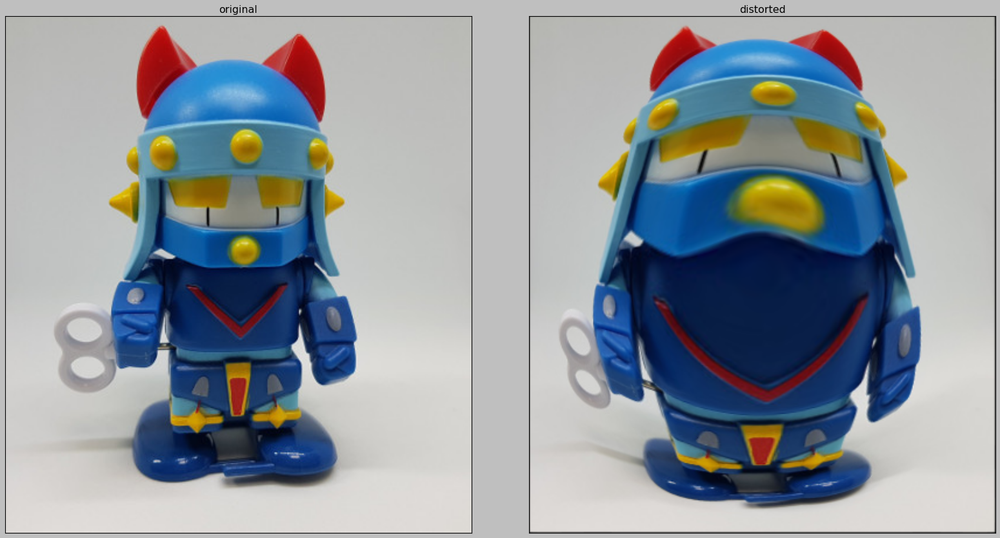

In [114]:
img = cv2.imread('./taekwonv1.jpg')
print(img.shape)
rows, cols = img.shape[:2]

# ---① 설정 값 셋팅
exp = 2       # 볼록, 오목 지수 (오목 : 0.1 ~ 1, 볼록 : 1.1~)
scale = 1           # 변환 영역 크기 (0 ~ 1)

# 매핑 배열 생성 ---②
mapy, mapx = np.indices((rows, cols),dtype=np.float32)

# 좌상단 기준좌표에서 -1~1로 정규화된 중심점 기준 좌표로 변경 ---③
mapx = 2*mapx/(cols-1)-1
mapy = 2*mapy/(rows-1)-1

# 직교좌표를 극 좌표로 변환 ---④
r, theta = cv2.cartToPolar(mapx, mapy)

# 왜곡 영역만 중심확대/축소 지수 적용 ---⑤
r[r< scale] = r[r<scale] **exp  

# 극 좌표를 직교좌표로 변환 ---⑥
mapx, mapy = cv2.polarToCart(r, theta)

# 중심점 기준에서 좌상단 기준으로 변경 ---⑦
mapx = ((mapx + 1)*cols-1)/2
mapy = ((mapy + 1)*rows-1)/2

# 재매핑 변환
distorted = cv2.remap(img,mapx,mapy,cv2.INTER_LINEAR)


imgs = {'original' : img, 'distorted' : distorted}

fig, axes = plt.subplots(1,2,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- exp는 이미지의 왜곡 지수를 나타내는 변수로 1이면 원본과 동일하게 하고, 1보다 작으면 오목 렌즈 효과를 내고, 1보다 크면 볼록 렌즈 효과
- 아래 코드는 좌표의 기준점을 바꾸고 -1~1 범위로 정규화하는 코드,  이후에 다시 좌상단 기준점으로 변경

```python
mapx = 2*mapx/(cols-1)-1
mapy = 2*mapy/(rows-1)-1
```

실질적인 렌즈 효과는 아래 코드에서 수행

```python
r[r< scale] = r[r<scale] **exp  
```

- 좌표의 범위를 -1~1로 정규화, scale의 최댓값은 1설정됨
- 극좌표계로 바꿨을 때의 r은 원의 반지름, 반지름이 scale보다 작은 범위에 있는 좌표에 대해서는 exp를 곱함, (eps가 1보다 크면 볼록, 1보다 작으면 오목)

### 방사 왜곡

- 카메라를 통해 이미지를 촬영할 때 카메라 가장자리 부분에서 약간의 왜곡 -> 배럴 왜곡
- 들어가는 듯한 왜곡 -> 핀쿠션 왜곡

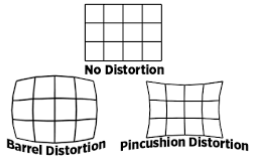

### 배럴 왜곡, 핀쿠션 왜곡

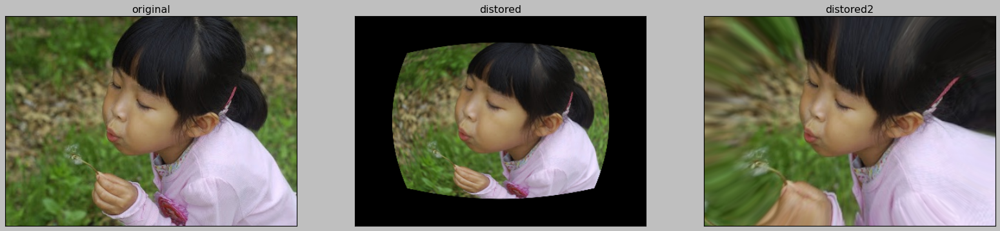

In [122]:
# 왜곡 계수 설정 ---①
k1, k2, k3 = 0.5, 0.2, 0.0 # 배럴 왜곡
h1, h2, h3 = -0.3, 0, 0    # 핀큐션 왜곡

img = cv2.imread('./girl.jpg')
rows, cols = img.shape[:2]

def make_distorted(k1, k2, k3):
    global img, rows, cols

    # 매핑 배열 생성 ---②
    mapy, mapx = np.indices((rows, cols),dtype=np.float32)

    # 중앙점 좌표로 -1~1 정규화 및 극좌표 변환 ---③
    mapx = 2*mapx/(cols-1)-1
    mapy = 2*mapy/(rows-1)-1
    r, theta = cv2.cartToPolar(mapx, mapy)

    # 방사 왜곡 변영 연산 ---④
    ru = r*(1+k1*(r**2) + k2*(r**4) + k3*(r**6)) 

    # 직교좌표 및 좌상단 기준으로 복원 ---⑤
    mapx, mapy = cv2.polarToCart(ru, theta)
    mapx = ((mapx + 1)*cols-1)/2
    mapy = ((mapy + 1)*rows-1)/2
    
    # 리매핑 ---⑥
    distored = cv2.remap(img,mapx,mapy,cv2.INTER_LINEAR)
    
    return distored


distored = make_distorted(k1, k2, k3)
distored2 = make_distorted(h1, h2, h3)


imgs = {'original' : img, 'distored' : distored, 'distored2' : distored2}

fig, axes = plt.subplots(1,3,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- 오목과 비슷한 프로세스

ru = r*(1+k1*(r**2) + k2*(r**4) + k3*(r**6)) 

- 위 연산식은 배럴 왜곡, 핀쿠션 왜곡을 적용해주는 연산식
- k의 값에 따라서 배럴 왜곡, 핀쿠션 왜곡 결정

## 13. 모자이크 처리(Mosaic), 리퀴파이(Liquify), 왜곡 거울(Distortion Mirror)

### 모자이크 처리

- 모자이크를 적용할 관심 영역의 이미지를 특정 비율로 축소시킨 뒤 다시 확대하면 모자이크 됨
- 크기가 작은 이미지를 최대 픽셀 값 이상의 크기로 확대하면 이미지가 깨짐, 이 원리를 적용한 것
- 관심 영역을 축소했다가 다시 확대하면 원래의 픽셀과 비슷하긴 하지만, 보간법에 의해서 연산한 결과라서 선명도가 떨어져 뿌옇게 됨, 이때 보간법은 cv2.INTER_AREA를 사용

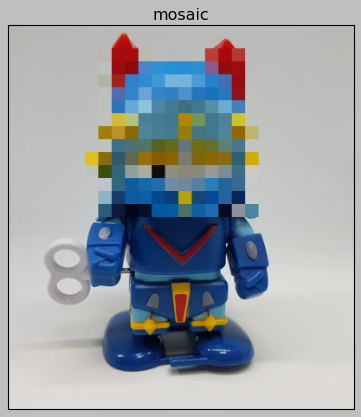

In [126]:
rate = 15               # 모자이크에 사용할 축소 비율 (1/rate)
win_title = 'mosaic'    # 창 제목
img = cv2.imread('./taekwonv1.jpg')    # 이미지 읽기

while True:
    x,y,w,h = cv2.selectROI(win_title, img, False) # 관심영역 선택
    if w and h:
        roi = img[y:y+h, x:x+w]   # 관심영역 지정
        roi = cv2.resize(roi, (w//rate, h//rate)) # 1/rate 비율로 축소
        
        # 원래 크기로 확대
        roi = cv2.resize(roi, (w,h), interpolation=cv2.INTER_AREA)  
        img[y:y+h, x:x+w] = roi   # 원본 이미지에 적용
        plt.imshow(img[:,:,::-1])
        plt.title('mosaic') 
        plt.xticks([]) 
        plt.yticks([]) 
    else:
        break

plt.show()
cv2.destroyAllWindows()

### 리퀴파이 도구

- 어플의 보정효과 -> 리퀴파이(Liquify)라고 함
- 이미지의 원하는 부분만 작게 하거나 크게 하는 기능을 리퀴파이

- 리퀴파이 원리
    - 사각형 영역을 4개의 삼각형 영역으로 나눔
    - 마우스의 위치를 가운데 교차점으로 지정
    - 마우스를 드래그하면 교차점의 위치가 오른쪽과 같이 변환
    - 각 4개의 삼각형의 크기가 변화후 각각의 4개의 삼각형에 대해서 각각 어핀 변환 수행
    
    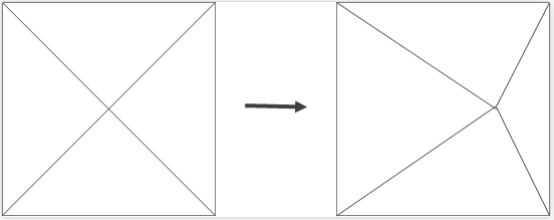

In [ ]:
win_title = 'Liquify'   # 창 이름
half = 50               # 관심 영역 절반 크기
isDragging = False      # 드래그 여부 플래그

# 리퀴파이 함수
def liquify(img, cx1,cy1, cx2,cy2) :
    # 대상 영역 좌표와 크기 설정
    x, y, w, h = cx1-half, cy1-half, half*2, half*2
    # 관심 영역 설정
    roi = img[y:y+h, x:x+w].copy()
    out = roi.copy()

    # 관심영역 기준으로 좌표 재 설정
    offset_cx1,offset_cy1 = cx1-x, cy1-y
    offset_cx2,offset_cy2 = cx2-x, cy2-y
    
    # 변환 이전 4개의 삼각형 좌표
    tri1 = [[ (0,0), (w, 0), (offset_cx1, offset_cy1)], # 상,top
            [ [0,0], [0, h], [offset_cx1, offset_cy1]], # 좌,left
            [ [w, 0], [offset_cx1, offset_cy1], [w, h]], # 우, right
            [ [0, h], [offset_cx1, offset_cy1], [w, h]]] # 하, bottom

    # 변환 이후 4개의 삼각형 좌표
    tri2 = [[ [0,0], [w,0], [offset_cx2, offset_cy2]], # 상, top
            [ [0,0], [0, h], [offset_cx2, offset_cy2]], # 좌, left
            [ [w,0], [offset_cx2, offset_cy2], [w, h]], # 우, right
            [ [0,h], [offset_cx2, offset_cy2], [w, h]]] # 하, bottom

    
    for i in range(4):
        # 각각의 삼각형 좌표에 대해 어핀 변환 적용
        matrix = cv2.getAffineTransform( np.float32(tri1[i]), \
                                         np.float32(tri2[i]))
        warped = cv2.warpAffine( roi.copy(), matrix, (w, h), \
            None, flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_REFLECT_101)
        # 삼각형 모양의 마스크 생성
        mask = np.zeros((h, w), dtype = np.uint8)
        cv2.fillConvexPoly(mask, np.int32(tri2[i]), (255,255,255))
        
        # 마스킹 후 합성
        warped = cv2.bitwise_and(warped, warped, mask=mask)
        out = cv2.bitwise_and(out, out, mask=cv2.bitwise_not(mask))
        out = out + warped

    # 관심 영역을 원본 영상에 합성
    img[y:y+h, x:x+w] = out
    return img 

# 마우스 이벤트 핸들 함수
def onMouse(event,x,y,flags,param):     
    global cx1, cy1, isDragging, img      # 전역변수 참조
    # 마우스 중심 점을 기준으로 대상 영역 따라다니기
    if event == cv2.EVENT_MOUSEMOVE:  
        if not isDragging :
            img_draw = img.copy()       
            # 드래그 영역 표시
            cv2.rectangle(img_draw, (x-half, y-half), \
                    (x+half, y+half), (0,255,0)) 
            cv2.imshow(win_title, img_draw) # 사각형 표시된 그림 화면 출력
    elif event == cv2.EVENT_LBUTTONDOWN :   
        isDragging = True                   # 드래그 시작
        cx1, cy1 = x, y                     # 드래그 시작된 원래의 위치 좌표 저장
    elif event == cv2.EVENT_LBUTTONUP :
        if isDragging:
            isDragging = False              # 드래그 끝
            # 드래그 시작 좌표와 끝난 좌표로 리퀴파이 적용 함수 호출
            liquify(img, cx1, cy1, x, y)    
            cv2.imshow(win_title, img)

    
img = cv2.imread("./taekwonv1.jpg")
h, w = img.shape[:2]

cv2.namedWindow(win_title)
cv2.setMouseCallback(win_title, onMouse) 
cv2.imshow(win_title, img)
while True:
    key = cv2.waitKey(1)
    if key & 0xFF == 27:
        break
cv2.destroyAllWindows()

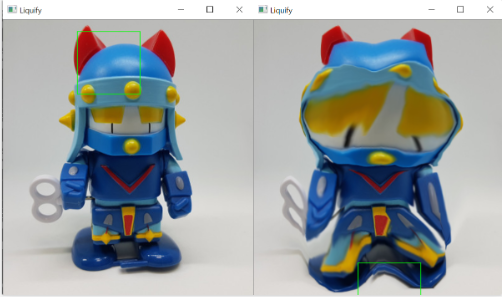

## 14. 필터(Filter)와 컨볼루션(Convolution) 연산, 평균 블러링, 가우시안 블러링, 미디언 블러링, 바이레터럴 필터

- 새로운 픽셀 값을 얻을 때 하나의 픽셀 값이 아닌 그 주변 픽셀들의 값을 활용하는 방법을 공간 영역 필터링, 기존의 영상을 흐릿하게 만드는 작업을 블러링 이라고 함

### 필터(Filter)와 컨볼루션(Convolution)

- 컨볼루션 연산은 공간 영역 필터링을 위한 핵심 연산 방법
- 공간 영역 필터링은 연산 대상 픽셀과 그 주변 픽셀들을 활용하여 새로운 픽셀 값을 얻는 방법
    - 주변 픽셀을 어느 범위까지 활용할지 그리고 연산은 어떻게 할지를 결정해야 함, 이런 역할을 하는 것이 바로 커널
    - 커널은 윈도, 필터, 마스크 라고 부름


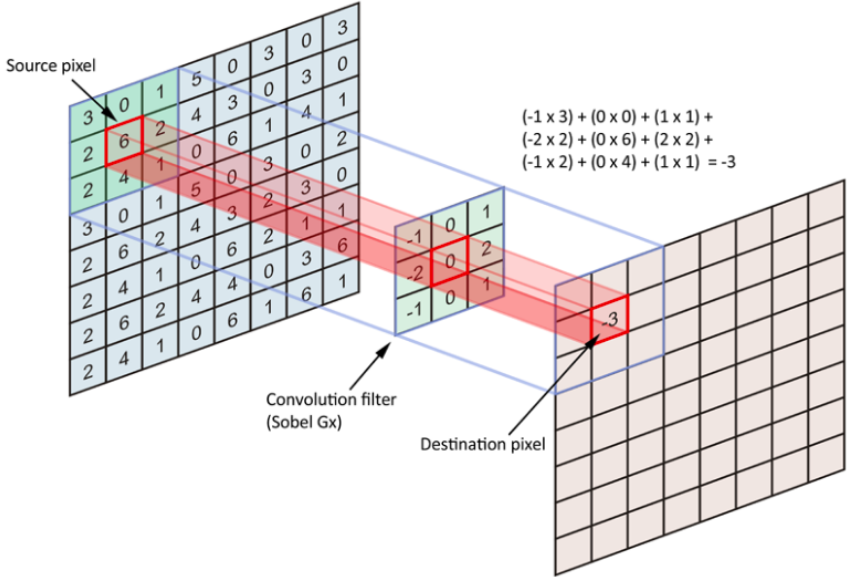

- 위 그림은 3 x 3 커널로 컨볼루션 연산을 하는 사진
- 픽셀 값 6을 기준으로 주변에 있는 픽셀 값인 3, 0, 1, 2, 1, 4, 2, 2까지 활용
- 일대일로 대응하는 위치에 있는 커널의 요소와 대응하는 입력 픽셀 값을 곱해서 모두 합한 것을 결과 픽셀 값으로 결정
- 이런 연산을 마지막 픽셀까지 반복하는 것을 컨볼루션 연산

```python
dst = cv2.filter2D(src, ddepth, kernel, dst, anchor, delta, borderType)
        src: 입력 영상, Numpy 배열
        ddepth: 출력 영상의 dtype (-1: 입력 영상과 동일)
        kernel: 컨볼루션 커널, float32의 n x n 크기 배열
        dst(optional): 결과 영상
        anchor(optional): 커널의 기준점, default: 중심점 (-1, -1)
        delta(optional): 필터가 적용된 결과에 추가할 값
        borderType(optional): 외곽 픽셀 보정 방법 지정
```

### 평균 필터를 생상하여 블러 적용

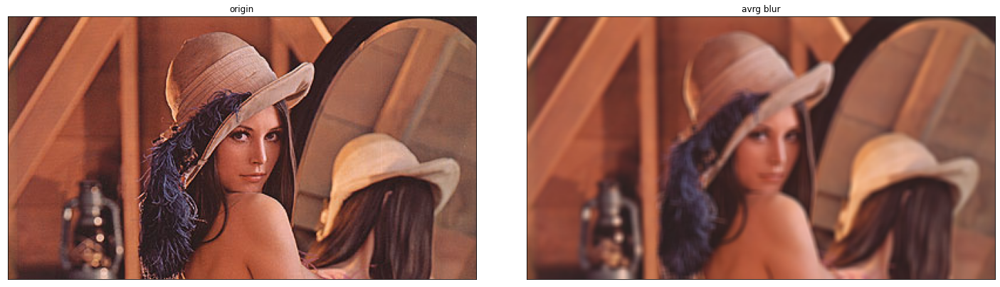

In [4]:
img = cv2.imread('./test_image.jpg')
'''
#5x5 평균 필터 커널 생성    ---①
kernel = np.array([[0.04, 0.04, 0.04, 0.04, 0.04],
                   [0.04, 0.04, 0.04, 0.04, 0.04],
                   [0.04, 0.04, 0.04, 0.04, 0.04],
                   [0.04, 0.04, 0.04, 0.04, 0.04],
                   [0.04, 0.04, 0.04, 0.04, 0.04]])
'''
# 5x5 평균 필터 커널 생성  
kernel = np.ones((5,5))/5**2

# 필터 적용             
blured = cv2.filter2D(img, -1, kernel)

# 결과 출력
imgs = {'origin' : img, 'avrg blur' : blured}

fig, axes = plt.subplots(1,2,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- np.ones((5, 5))/5**2는 평균 블러링 필터 역할을 수행
- 컨볼루션 연산을 배울 때는 원본 이미지의 픽셀 값과 그에 대응하는 필터의 픽셀 값을 요소 별로 곱한 뒤 모두 합을 했지만 ,평균 블러링을 적용 해야하기 위해 5 x 5 필터의 요소 개수인 5**2(=25)로 나눠줌


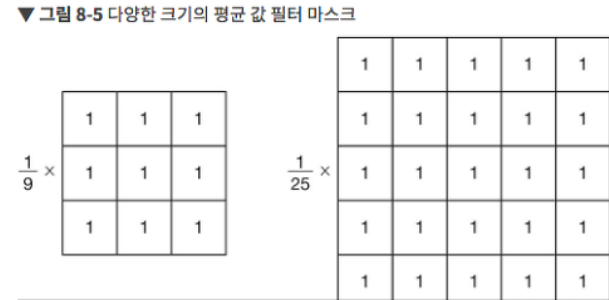


- 필터의 크기가 클수록 평균 블러링 수행시 선명도가 더 떨어짐

- OpenCV에서는 평균 블러링 함수를 지원함

```python
dst = cv2.blur(src, ksize, dst, anchor, borderType)
```
        src: 입력 영상, numpy 배열
        ksize: 커널의 크기
        나머지 파라미터는 cv2.filter2D()와 동일
        
```python
dst = cv2.boxFilter(src, ddepth, ksize, dst, anchor, normalize, borderType)
```
        ddepth: 출력 영상의 dtype (-1: 입력 영상과 동일)
        normalize(optional): 커널 크기로 정규화(1/ksize²) 지정 여부 (Boolean), default=True
        나머지 파라미터는 cv2.filter2D()와 동일
        
        
- cv2.blur() 함수는 커널의 크기만 정해주면 알아서 평균 커널을 생성해서 평균 블러링 적용,  커널 크기는 일반적으로 홀수로 적용
-  cv2.boxFilter() 함수는 normalize에 True를 전달하면 cv2.blur() 함수와 동일한 기능 수행

### 블러 전용 함수로 블러링 적용

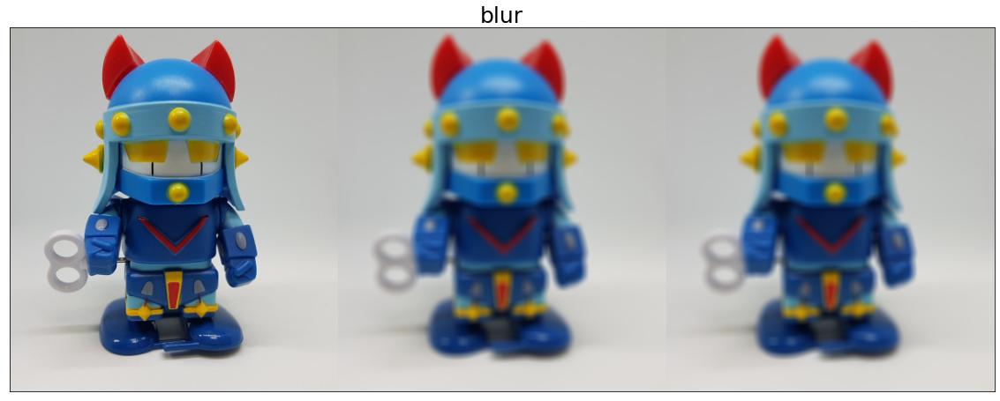

In [14]:
file_name = './taekwonv1.jpg'
img = cv2.imread(file_name)

# blur() 함수로 블러링  ---①
blur1 = cv2.blur(img, (10,10))

# boxFilter() 함수로 블러링 적용 ---②
blur2 = cv2.boxFilter(img, -1, (10,10))

# 결과 출력
merged = np.hstack( (img, blur1, blur2))

plt.figure(figsize=(20, 10))
plt.title('blur',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

-  cv2.blur() 함수와 cv2.boxFilter() 함수가 동일한 결과를 보여줌

### 가우시안 블러링(Gaussian Blurring)

- 가우시안 분포를 갖는 커널로 블러링 하는 것을 가우시안 블러링 이라고 함
- 가우시안 분포는 정규분포라고도 하고, 평균 근처에 몰려 있는 값들의 개수가 많고 평균에서 멀어질수록 그 개수가 적어지는 분포를 의미
- 가우시안 블러링 커널은 아래와 같이 중앙값이 가장 크고 중앙에서 멀어질수록 그 값이 작아짐

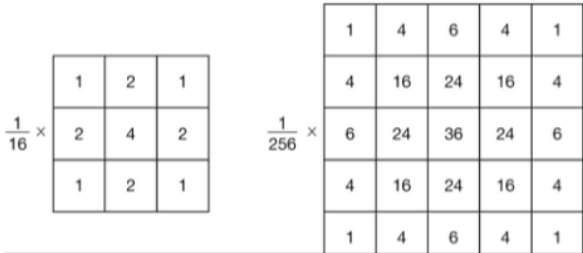


- 위의 평균 블러링과 다르게 1/(가로*세로)가 아닌 모든 요소의 합이 분모가 됨
- 가우시안 블러링 커널을 적용하면 대상 픽셀에 가까울수록 많은 영향을 주고, 멀어질수록 적은 영향을 주기 때문에 원래의 영상과 비슷하면서도 노이즈를 제거하는 효과가 있음

```python
cv2.GaussianBlur(src, ksize, sigmaX, sigmaY, borderType)
```
        src: 입력 영상
        ksize: 커널 크기 (주로 홀수)
        sigmaX: X 방향 표준편차 (0: auto)
        sigmaY(optional): Y 방향 표준편차 (default: sigmaX)
        borderType(optional): 외곽 테두리 보정 방식
        
        
```python
ret = cv2.getGaussianKernel(ksize, sigma, ktype)
```
        ret: 가우시안 커널 (1차원이므로 ret * ret.T 형태로 사용해야 함)
        
        
- cv2.GaussianBlur() 함수는 커널 크기와 표준 편차를 전달하면 가우시안 블러링을 적용함
- sigmaX에 0을 전달하면 자동으로 표준편차를 선택해서 사용
- sigmaY를 생략하면 sigmaX 값과 동일하게 적용


- cv2.getGaussianKernel() 함수는 커널 크기와 표준 편차를 전달하면 가우시안 필터를 반환
- 반환된 필터는 1차원이므로 cv2.filter2D() 함수에 사용하려면 ret * ret.T와 같은 형식으로 전달

### 가우시안 블러링

k1: [[0.0625 0.125  0.0625]
 [0.125  0.25   0.125 ]
 [0.0625 0.125  0.0625]]
k2: [[0.0625 0.125  0.0625]
 [0.125  0.25   0.125 ]
 [0.0625 0.125  0.0625]]


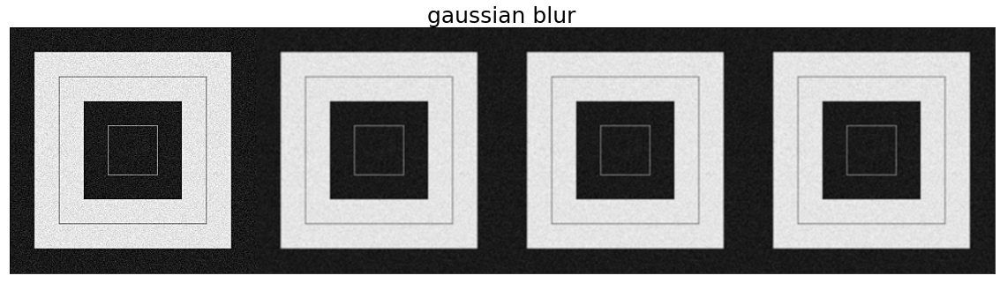

In [17]:
img = cv2.imread('./gaussian_noise.jpg')

# 가우시안 커널을 직접 생성해서 블러링  ---①
k1 = np.array([[1, 2, 1],
                   [2, 4, 2],
                   [1, 2, 1]]) *(1/16)
blur1 = cv2.filter2D(img, -1, k1)

# 가우시안 커널을 API로 얻어서 블러링 ---②
k2 = cv2.getGaussianKernel(3, 0)
blur2 = cv2.filter2D(img, -1, k2*k2.T)

# 가우시안 블러 API로 블러링 ---③
blur3 = cv2.GaussianBlur(img, (3, 3), 0)

# 결과 출력
print('k1:', k1)
print('k2:', k2*k2.T)
merged = np.hstack((img, blur1, blur2, blur3))

plt.figure(figsize=(20, 10))
plt.title('gaussian blur',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 첫 번째로 가우시안 필터를 직접 생성해서 cv2.filter2D() 함수에 전달하여 블러링을 적용
- 두 번째로 cv2.getGaussianKernel() 함수를 이용해 가우시안 커널 생성
    - 얻은 커널을 역시 cv2.filter2D() 함수에 전달하여 블러링을 적용
    - k2*k2.T와 같은 형태로 전달해야 함
- cv2.GaussianBlur() 함수를 활용하여 필터를 별도로 구하지 않고 직접 가우시안 블러링을 적용

> 두가지 모두 노이즈가 제거되는 효과, 가우시안 블러링은 노이즈 제거 효과있음

### 미디언 블러링(Median Blurring)

- 커널의 픽셀 값 중 중앙값을 선택하는 것을 미디언 블러링
- 미디언 블러링은 salt&pepper 잡음을 제거하는 효과 존재
    - salt&pepper : 소금과 후추를 뿌린 것과 같이 생긴 잡음

```python
dst = cv2.medianBlur(src, ksize)
```
        src: 입력 영상
        ksize: 커널 크기

### 미디언 블러링 

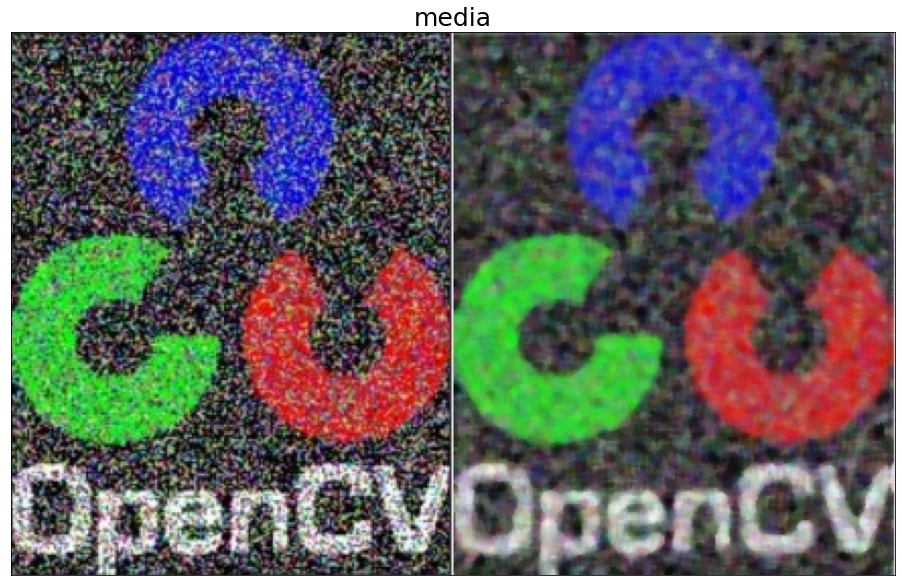

In [19]:
img = cv2.imread("./salt_pepper_noise.jpg")

# 미디언 블러 적용 --- ①
blur = cv2.medianBlur(img, 5)

# 결과 출력 
merged = np.hstack((img,blur))

plt.figure(figsize=(20, 10))
plt.title('media',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- salt&pepper 잡음이 제거되는것을 볼수 있음

### 바이레터럴 필터(Bilateral Filter)

- 지금까지 적용한 블러링은 잡음을 제거하는 효과는 뛰어났지만 그만큼 경계도 흐릿하게 만드는 문제 존재
- 바이레터럴 필터는 이를 개선하기 위해 가우시안 필터와 경계 필터를 결합
- 경계도 뚜렷하고 노이즈도 제거되는 효과가 있지만 속도가 느림


```python
dst = cv2.bilateralFilter(src, d, sigmaColor, sigmaSpace, dst, borderType)
```
        src: 입력 영상
        d: 필터의 직경(diameter), 5보다 크면 매우 느림
        sigmaColor: 색공간의 시그마 값
        sigmaSpace: 좌표 공간의 시그마 값

- 일반적으로 sigmaColor와 sigmaSpace는 같은 값을 사용, 값의 범위는 10~150을 권장

### 바이레터럴 필터와 가우시안 필터 비교

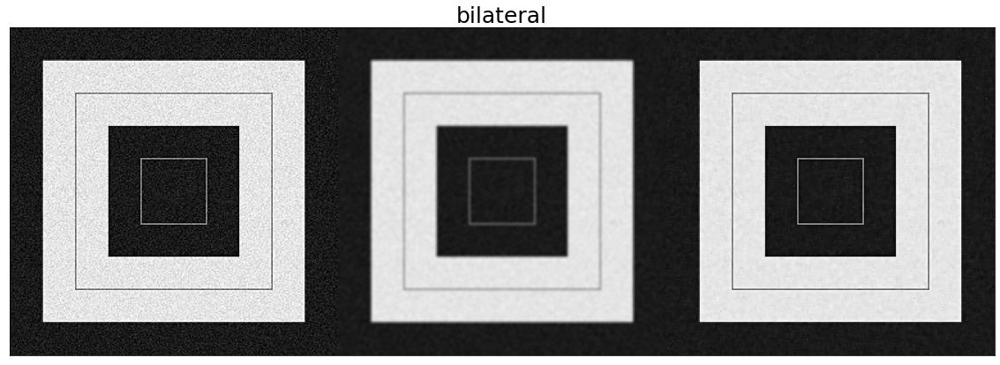

In [21]:
img = cv2.imread("./gaussian_noise.jpg")

# 가우시안 필터 적용 ---①
blur1 = cv2.GaussianBlur(img, (5,5), 0)

# 바이레터럴 필터 적용 ---②
blur2 = cv2.bilateralFilter(img, 5, 75, 75)

# 결과 출력
merged = np.hstack((img, blur1, blur2))

plt.figure(figsize=(20, 10))
plt.title('bilateral',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 가우시안 필터를 적용했을 때는 경곗값이 흐릿하지만, 바이레터럴 필터를 적용했을 때는 노이즈는 줄면서 경곗값을 유지

## 15. 경계 검출 (미분 필터, 로버츠 교차 필터, 프리윗 필터, 소벨 필터, 샤르 필터, 라플라시안 필터, 캐니 엣지)

- 영상의 경계를 선명하고 뚜렷하게 만드는 작업을 샤프닝 이라고 함
- 샤프닝은 영상에서 경계를 검출하여 경계에 있는 픽셀을 강조

### 기본 미분 필터

- 경계를 검출하기 위해서는 픽셀 값이 급격하게 변하는 지점을 찾아야함
    - 연속된 픽셀 값에 미분을 하여 찾아낼수 있음
    - 픽셀은 연속 공간 안에 있지 않으므로 미분 근사값을 구해야 함
- 미분 근사값은 서로 붙어 있는 픽셀 값을 빼면 됨
    - x방향, y방향으로 각각 픽셀 값을 빼면 미분 근사값이 됨
    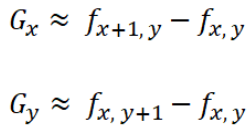
    
- 영상 내 픽셀 값의 미분 근사값 연산을 위한 컨볼루션 커널은 밑과 같음
    - 요소가 -1과 1인 이유는 접해져있는 픽셀 값을 빼기 때문
    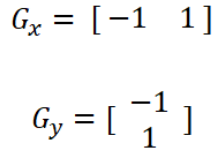

### 미분 커널로 경계 검출

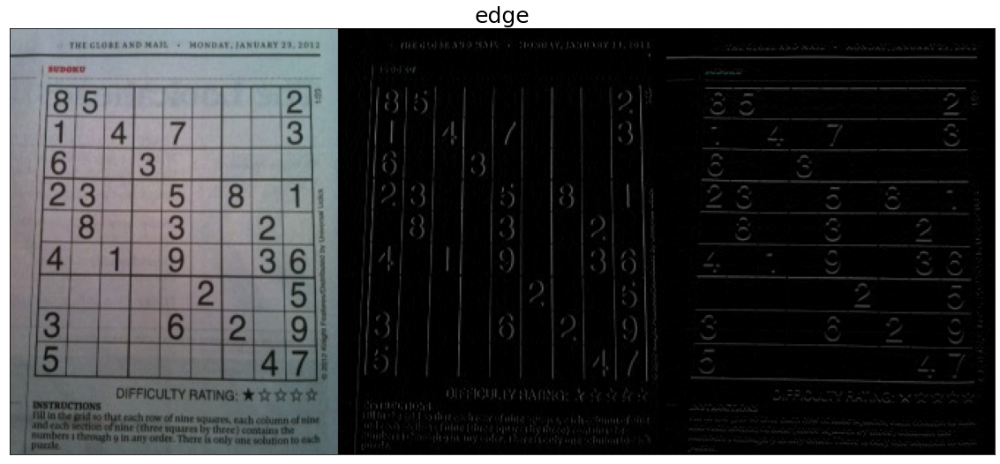

In [24]:
img = cv2.imread("./sudoku.jpg")

#미분 커널 생성 ---①
gx_kernel = np.array([[ -1, 1]])
gy_kernel = np.array([[ -1],[ 1]])

# 필터 적용 ---②
edge_gx = cv2.filter2D(img, -1, gx_kernel)
edge_gy = cv2.filter2D(img, -1, gy_kernel)
# 결과 출력
merged = np.hstack((img, edge_gx, edge_gy))

plt.figure(figsize=(20, 10))
plt.title('edge',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- x방향, y방향의 미분 커널을 생성하여 필터링을 적용
- x방향 미분 필터는 세로 방향의 경계를 검출했고, y방향 미분 필터는 가로 방향의 경계를 검출
    - x방향 미분 필터는 좌우 픽셀 값의 차를 기반으로 필터링했기 때문에 세로 방향의 경계를 검출한 것
    -  y방향 미분 필터는 상하 픽셀 값의 차를 기반으로 필터링했기 때문에 가로 방향의 경계를 검출한 것

### 로버츠 교차 필터 (Roberts Cross Filter)

- 로버츠 교차 필터를 위한 컨볼루션 커널 공식은 밑

    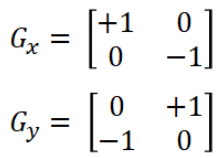
    
- 대각선 방향으로 +1과 -1을 배치시켜 사선 경계 검출 효과를 높임
- 노이즈에 민감하다는 단점

### 로버츠 교차 필터를 적용한 경계 검출

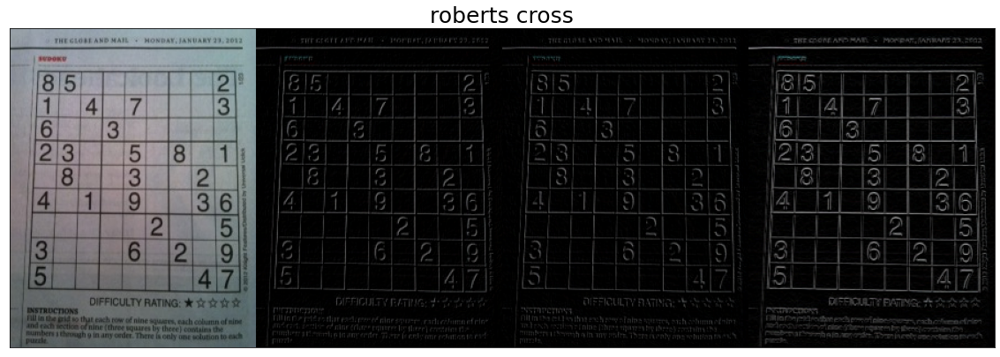

In [26]:
img = cv2.imread("./sudoku.jpg")

# 로버츠 커널 생성 ---①
gx_kernel = np.array([[1,0], [0,-1]])
gy_kernel = np.array([[0, 1],[-1,0]])

# 커널 적용 ---② 
edge_gx = cv2.filter2D(img, -1, gx_kernel)
edge_gy = cv2.filter2D(img, -1, gy_kernel)

# 결과 출력
merged = np.hstack((img, edge_gx, edge_gy, edge_gx+edge_gy))
plt.figure(figsize=(20, 10))
plt.title('roberts cross',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 세로, 가로 검출에 비해 더 명확하게 검출이 가능함

### 프리윗 필터 (Prewitt Filter)

- 프리윗 필터는 x축과 y축의 각 방향으로 차분을 세 번 계산하여 경계를 검출하는 필터
- 프리윗 필터는 상하/좌우 경계는 뚜렷하게 잘 검출하지만 대각선 검출이 약함

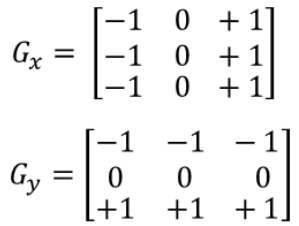

### 프리윗 마스크를 적용한 경계 검출

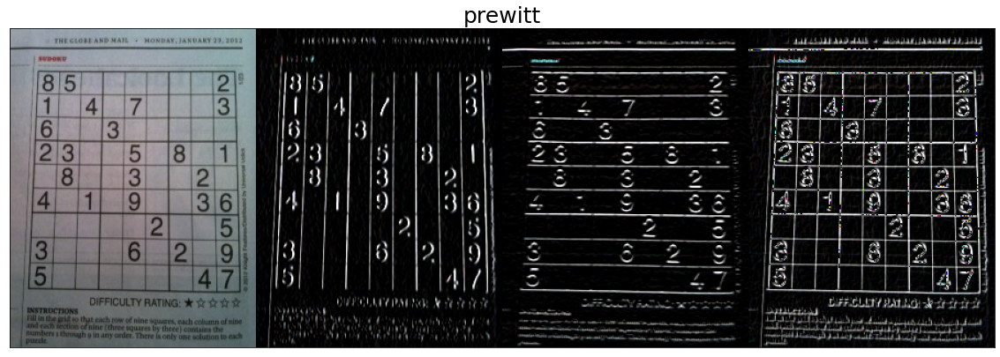

In [28]:
file_name = "./sudoku.jpg"
img = cv2.imread(file_name)

# 프리윗 커널 생성
gx_k = np.array([[-1,0,1], [-1,0,1],[-1,0,1]])
gy_k = np.array([[-1,-1,-1],[0,0,0], [1,1,1]])

# 프리윗 커널 필터 적용
edge_gx = cv2.filter2D(img, -1, gx_k)
edge_gy = cv2.filter2D(img, -1, gy_k)

# 결과 출력
merged = np.hstack((img, edge_gx, edge_gy, edge_gx+edge_gy))

plt.figure(figsize=(20, 10))
plt.title('prewitt',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 기본 미분 필터나 로버츠 교차 필터에 비해 상하/좌우 경계 검출 강도가 강함
- 마지막은 상하/좌우 경계 검출 필터로 필터링한 결과를 합친 것

### 소벨 필터 (Sobel Filter)

- 중심 픽셀의 차분 비중을 두 배로 준 필터
- 소벨 필터는 x축, y축, 대각선 방향의 경계 검출에 모두 강함

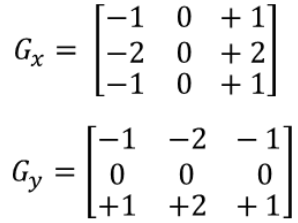

- 로버츠 필터와 프리윗 필터는 현재는 거의 쓰이지 않음
- 소벨 필터는 실무적으로도 쓰이므로 OpenCV에서 별도의 함수를 제공

```python
dst = cv2.Sobel(src, ddepth, dx, dy, dst, ksize, scale, delta, borderType)
```
        src: 입력 영상
        ddepth: 출력 영상의 dtype (-1: 입력 영상과 동일)
        dx, dy: 미분 차수 (0, 1, 2 중 선택, 둘 다 0일 수는 없음)
        ksize: 커널의 크기 (1, 3, 5, 7 중 선택)
        scale: 미분에 사용할 계수
        delta: 연산 결과에 가산할 값

### 소벨 마스크를 적용한 경계 검출

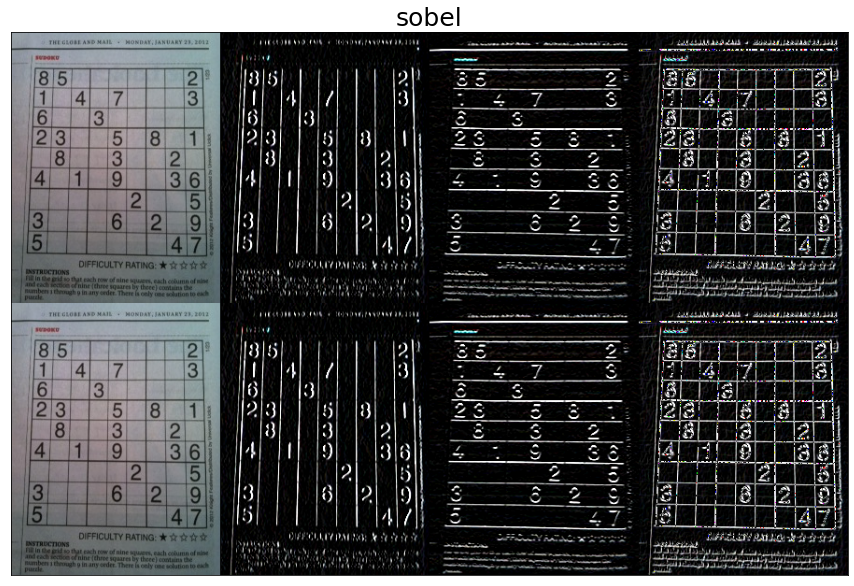

In [30]:
img = cv2.imread("./sudoku.jpg")

# 소벨 커널을 직접 생성해서 엣지 검출 ---①
## 소벨 커널 생성
gx_k = np.array([[-1,0,1], [-2,0,2],[-1,0,1]])
gy_k = np.array([[-1,-2,-1],[0,0,0], [1,2,1]])

## 소벨 필터 적용
edge_gx = cv2.filter2D(img, -1, gx_k)
edge_gy = cv2.filter2D(img, -1, gy_k)

# 소벨 API를 생성해서 엣지 검출
sobelx = cv2.Sobel(img, -1, 1, 0, ksize=3)
sobely = cv2.Sobel(img, -1, 0, 1, ksize=3) 

# 결과 출력
merged1 = np.hstack((img, edge_gx, edge_gy, edge_gx+edge_gy))
merged2 = np.hstack((img, sobelx, sobely, sobelx+sobely))
merged = np.vstack((merged1, merged2))

plt.figure(figsize=(20, 10))
plt.title('sobel',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

-  두 결과는 동일

### 샤르 필터 (Scharr Filter)

- 소벨 필터는 커널의 중심에서 멀어질수록 엣지 방향성의 정확도가 떨어짐, 이를 개선한 필터가 샤르 필터

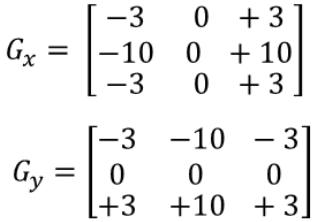

```python
dst = cv2.Scharr(src, ddepth, dx, dy, dst, scale, delta, borderType)
```
        ksize가 없다는 것을 제외하면 모든 파라미터는 cv2.Sobel()과 동일

### 샤르 마스크를 적용한 경계 검출

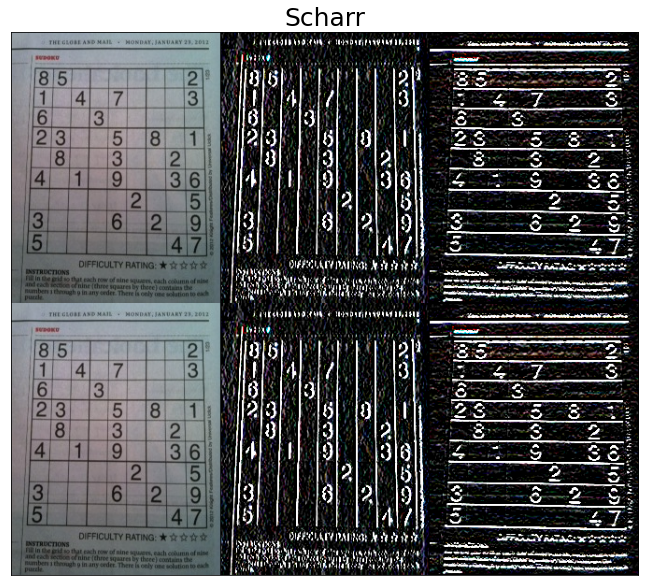

In [31]:
img = cv2.imread("./sudoku.jpg")

# 샤르 커널을 직접 생성해서 엣지 검출 ---①
gx_k = np.array([[-3,0,3], [-10,0,10],[-3,0,3]])
gy_k = np.array([[-3,-10,-3],[0,0,0], [3,10,3]])

edge_gx = cv2.filter2D(img, -1, gx_k)
edge_gy = cv2.filter2D(img, -1, gy_k)

# 샤르 API로 엣지 검출 ---②
scharrx = cv2.Scharr(img, -1, 1, 0)
scharry = cv2.Scharr(img, -1, 0, 1)

# 결과 출력
merged1 = np.hstack((img, edge_gx, edge_gy))
merged2 = np.hstack((img, scharrx, scharry))
merged = np.vstack((merged1, merged2))

plt.figure(figsize=(20, 10))
plt.title('Scharr',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

### 라플라시안 필터 (Laplacian Filter)

- 2차 미분을 적용한 필터
- 경계를 더 제대로 검출

```python
dst = cv2.Laplacian(src, ddepth, dst, ksize, scale, delta, borderType)
```
        파라미터는 cv2.Sobel()과 동일

### 라플라시안 마스크를 적용한 경계 검출

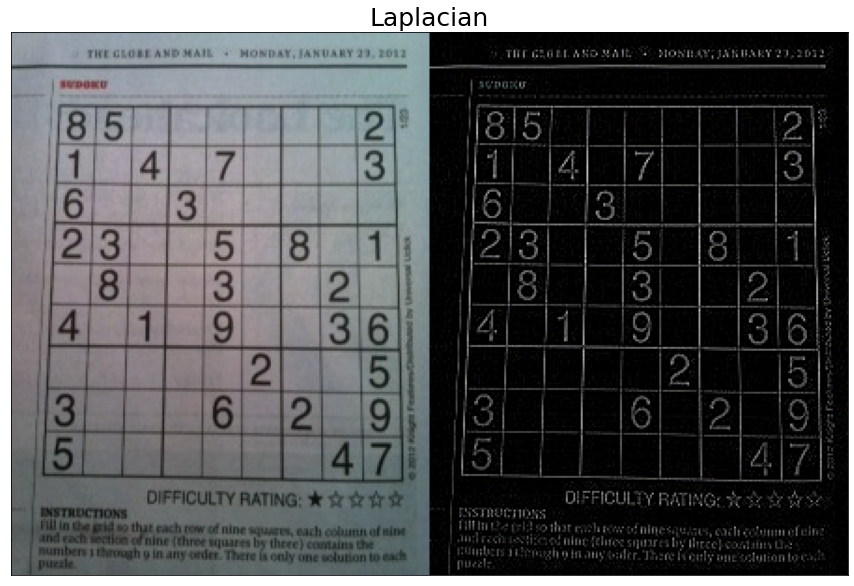

In [32]:
img = cv2.imread("./sudoku.jpg")

# 라플라시안 필터 적용 ---①
edge = cv2.Laplacian(img, -1)

# 결과 출력
merged = np.hstack((img, edge))

plt.figure(figsize=(20, 10))
plt.title('Laplacian',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 경계가 전과 비교했을때 확실히 뚜렷함

### 캐니 엣지 (Canny Edge)

- 캐니 엣지는 지금까지 살펴본 것처럼 한 가지 필터만 사용하는 것이 아니라 다음의 4단계 알고리즘에 따라 경계를 검출

- 과정
    1. 노이즈 제거: 5 x 5 가우시안 블러링 필터로 노이즈 제거
    2. 경계 그레디언트 방향 계산: 소벨 필터로 경계 및 그레디언트 방향 검출
    3. 비최대치 억제(Non-Maximum Suppression): 그레디언트 방향에서 검출된 경계 중 가장 큰 값만 선택하고 나머지는 제거
    4. 이력 스레시홀딩: 두 개의 경계 값(Max, Min)을 지정해서 경계 영역에 있는 픽셀들 중 큰 경계 값(Max) 밖의 픽셀과 연결성이 없는 픽셀 제거
    
```python
edges = cv2.Canny(img, threshold1, threshold2, edges, apertureSize, L2gardient)
```
        img: 입력 영상
        threshold1, threshold2: 이력 스레시홀딩에 사용할 Min, Max 값
        apertureSize: 소벨 마스크에 사용할 커널 크기
        L2gradient: 그레디언트 강도를 구할 방식 (True: 제곱 합의 루트 False: 절댓값의 합)
        edges: 엣지 결과 값을 갖는 2차원 배열

### 캐니 엣지 검출

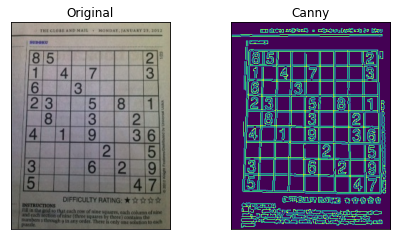

In [37]:
img = cv2.imread("./sudoku.jpg")

# 케니 엣지 적용 
edges = cv2.Canny(img,100,200)

# 결과 출력
fig, axes = plt.subplots(1,2)
plt.tight_layout(h_pad=0, w_pad=3)
axes[0].imshow(img)
axes[0].set_title('Original')
axes[0].set_xticks([]) 
axes[0].set_yticks([]) 


axes[1].imshow(edges)
axes[1].set_title('Canny')
axes[1].set_xticks([]) 
axes[1].set_yticks([]) 

plt.show()

- 확실히 하나의 필터를 적용한 것보다 경계 검출이 잘됨
- 가장 많이 쓰는 필터

## 16. 모폴로지(Morphology) 연산 (침식, 팽창, 열림, 닫힘, 그레디언트, 탑햇, 블랙햇)

- 모폴로지(morphology)란 '형태학'이라는 뜻
- 영상 분야에서 노이즈 제거, 구멍 채우기, 끊어진 선 이어 붙이기 등에 쓰이는 형태학적 연산을 의미
- 모폴로지 연산은 검은색과 흰색으로만 구성되어 있는 바이너리 이미지에 적용할 수 있음
- 모폴로지 연산으로는 침식, 팽창, 열림, 닫힘이 있음

### 침식 연산

- 침식 : 이미지를 깎아 내는 연산을 뜻함
- 침식 연산을 위해서는 구조화 요소 커널(structuring element kernel)이라는 0과 1로 구성된 커널이 필요
    - 구조화 요소 커널은 1이 채워진 모양에 따라 사각형, 타원형, 십자형 등으로 사용할 수 있음
- 침식 연산은 구조화 요소 커널을 입력 이미지에 적용해서 1로 채워진 영역을 온전히 올려 놓을 수 없으면 해당 픽셀을 0으로 변경
- 아래는 십자형 구조화 요소 커널로 침식 연산을 하는 과정
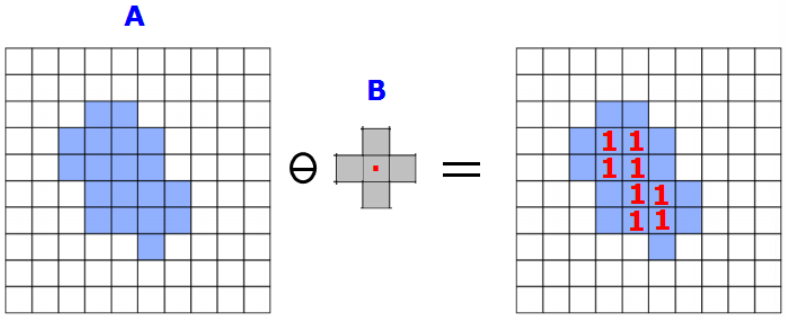

- A 이미지에서 흰색 배경은 0이고, 하늘색 전경은 1
- B는 십자형 구조화 요소 커널
    - 가운데를 포함해서 회색 부분이 다 1로 구성됨
    - 십자형 구조화 요소 커널의 중심부(빨간 점 부분)는 A 이미지의 파란색 부분을 순회
    - 한 칸 한 칸 훑으면서 구조화 요소 커널이 A 이미지의 하늘색 부분과 완전히 겹치지 않을 때는 0으로 변경,  완전히 겹치면 1

- 오른쪽은 침식 연산의 결과, 원래 하늘색 부분이 모두 1이었는데, 침식 연산 결과 빨간 1이 적혀 있는 부분만 1로 남아 있고 나머지 부분은 모두 0으로 변경
- 원본 이미지보다 조금 깎인 모습

----------------------------------------

- 구조화 요소 커널 생성 위한 함수
```python
cv2.getStructuringElement(shape, ksize, anchor)
```
        shape: 구조화 요소 커널 모양 (cv2.MORPH_RECT: 사각형, cv2.MORPH_EPLIPSE: 타원형, cv2.MORPH_CROSS: 십자형)
        ksize: 커널 크기
        anchor(optional): 구조화 요소의 기준점, cv2.MORPH_CROSS에만 의미 있으며 기본 값은 중심점 (-1, -1)
        
- 구조화 요소 커널로 침식 연산을 수행하는 함수
```python
dst = cv2.erode(src, kernel, anchor, iterations, borderType, borderValue)
```
        src: 입력 영상, 바이너리
        kernel: 구조화 요소 커널
        anchor(optional): cv2.getStructuringElement()와 동일
        iterations(optional): 침식 연산 적용 반복 횟수
        boderType(optional): 외곽 영역 보정 방법 
        boderValue(optional): 외곽 영역 보정 값

---------------------------------------

- 침식 연산은 큰 물체의 주변을 깎는 기능 수행
- 작은 물체는 아예 없애버리므로 노이즈 제거 효과, 원래는 떨어져 있는 물체인데 겹쳐 있는 것을 서로 떼어내는 데도 효과가 있음

### 침식 연산

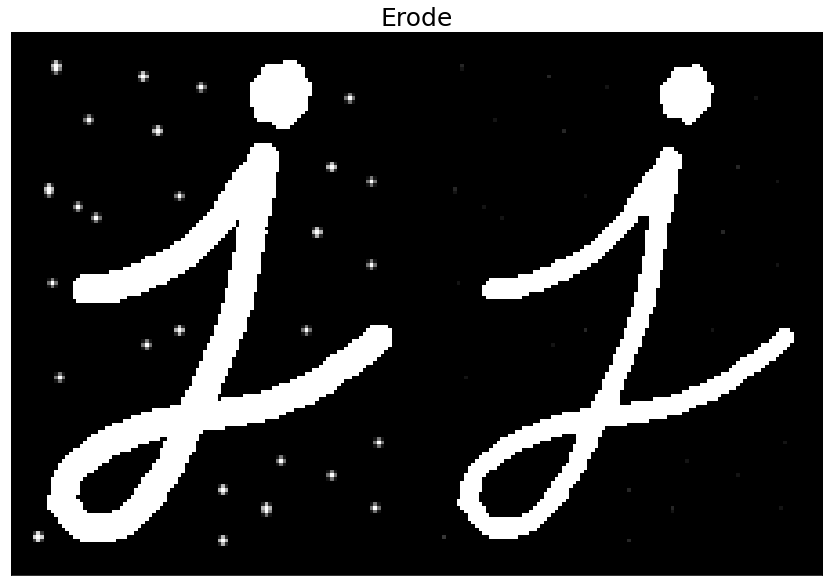

In [38]:
img = cv2.imread('./morph_dot.png')

# 구조화 요소 커널, 사각형 (3x3) 생성 ---①
k = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))

# 침식 연산 적용 ---②
erosion = cv2.erode(img, k)

# 결과 출력
merged = np.hstack((img, erosion))
plt.figure(figsize=(20, 10))
plt.title('Erode',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 사각형의 구조화 커널 3x3으로 침식 연산 수행
- 이즈가 제거되었고, 글씨가 전반적으로 가늘어짐

### 팽창 연산

- 팽창(dilatation)은 침식과 반대로 물체의 주변을 확장하는 연산, 침식과 반대 방법
    - 침식 연산은 구조화 요소 커널이 입력 영상에서 1로 채워진 영역과 완전히 겹치지 않으면 0으로 변경 
    - 팽창 연산은 이와 반대로 완전히 겹치지 않으면 1로 변경합

- 아래는 요소 커널이 십자가 아님

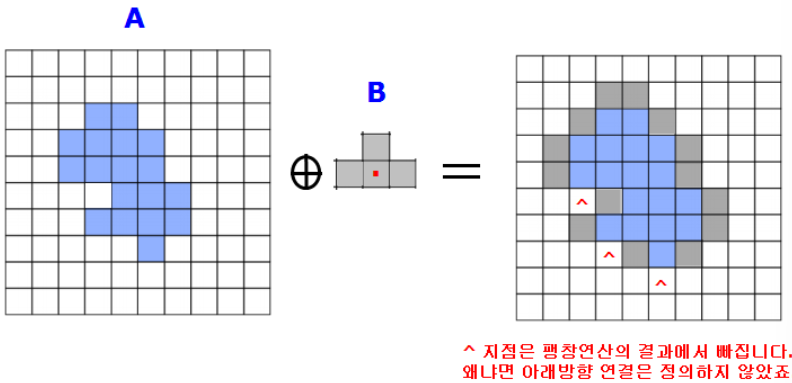

- 팽창을 위한 함수

```python
dst = cv2.dilate(src, kernel, dst, anchor, iterations, bordeType, borderValue)
```
        모든 파라미터는 cv2.erode()와 동일

### 팽창 연산

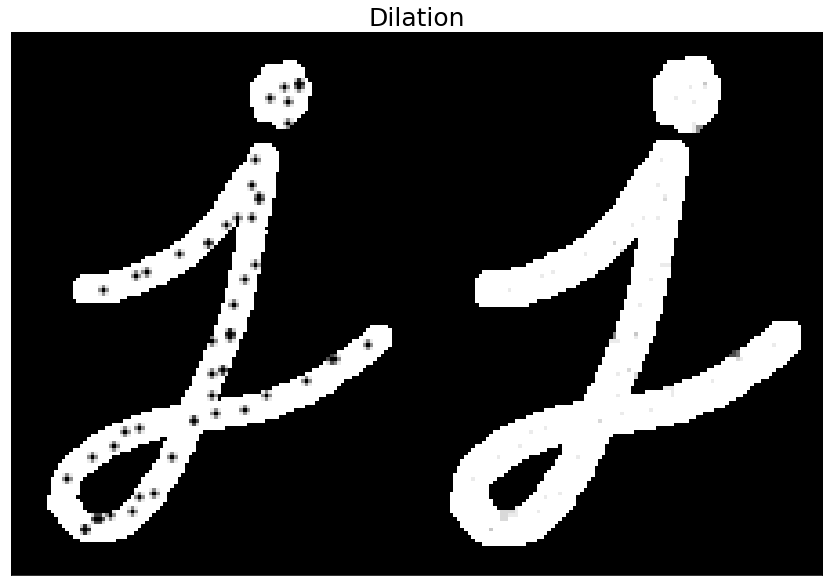

In [39]:
img = cv2.imread('./morph_hole.png')

# 구조화 요소 커널, 사각형 (3x3) 생성 ---①
k = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
# 팽창 연산 적용 ---②
dst = cv2.dilate(img, k)

# 결과 출력
merged = np.hstack((img, dst))
plt.figure(figsize=(20, 10))
plt.title('Dilation',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 실행 결과 글씨가 더 팽창, 글씨 안에 있던 검정색 노이즈가 제거
- 흰색 글씨가 바깥으로도 안으로도 팽창이 되어 노이즈는 제거되고 더 커짐

### 열림, 닫힘, 그레디언트, 탑햇, 블랙햇 연산

- 침식은 어두운 부분의 노이즈를 제거하는 효과, 팽창은 밝은 부분의 노이즈를 제거하는 효과
    - 노이즈 제거 효과는 좋으나 원래 모양이 홀쭉해지거나 뚱뚱해지는 변형 발생
    - 침식과 팽창의 연산을 조합하면 원래의 모양을 유지하면서 노이즈를 제거하는 효과 얻을 수 있음
- 침식 연산 후 팽창 연산을 적용하는 것을 열림(opening) 연산이라고 하고, 팽창 연산 후 침식 연산을 적용하는 것을 닫힘(closing) 연산
    - 연림 연산(열림 = 침식 + 팽창)
        - 열림 연산은 주변보다 밝은 노이즈를 제거하는데 효과적
        - 맞닿아 있는 것처럼 보이는 독립된 개체를 분리하거나 돌출된 모양을 제거하는 데 효과적
    - 닫힘 연산(닫힘 = 팽창 + 침식)
        - 닫힘 연산은 주변보다 어두운 노이즈를 제거하는데 효과적
        - 끊어져 보이는 개체를 연결하거나 구멍을 메우는 데 효과적

&nbsp;

- 팽창 연산을 적용한 이미지에서 침식 연산을 적용한 이미지를 빼면 경계 픽셀만 얻음
    - 경계 검출과 비슷함, 이런 연산을 그레디언트(gradient) 연산 이라고함
    - 그레디언트 = 팽창 - 침식
    



- 원본에서 열림 연산 적용 결과를 빼면 값이 크게 튀는 밝은 영역을 강조, 닫힘 연산 적용 결과에서 원본을 빼면 어두운 부분을 강조
    - 이것을 각각 탑햇(top hat)과 블랙햇(black hat) 연산
    - 탑햇 = 원본 - 열림
    - 블랙햇 = 닫힘 - 원본
    
-----------------------------------------
- 열림, 닫힘, 그레디언트, 탑햇, 블랙햇 연산을 위한 함수

```python
dst = cv2.morphologyEx(src, op, kernel, dst, anchor, iteration, borderType, borderValue)
```
        src: 입력 영상
        op: 모폴로지 연산 종류 (cv2.MORPH_OPEN: 열림 연산, cv2.MORPH_COLSE: 닫힘 연산, cv2.MORPH_GRADIENT: 그레디언트 연산, cv2.MORPH_TOPHAT: 탑햇 연산, cv2.MORPH_BLACKHAT: 블랙햇 연산)
        kernel: 구조화 요소 커널
        dst(optional): 결과 영상
        anchor(optional): 커널의 기준점
        iteration(optional): 연산 반복 횟수
        borderType(optional): 외곽 영역 보정 방법
        borderValue(optional): 외곽 영역 보정 값

### 열림과 닫힘 연산으로 노이즈 제거

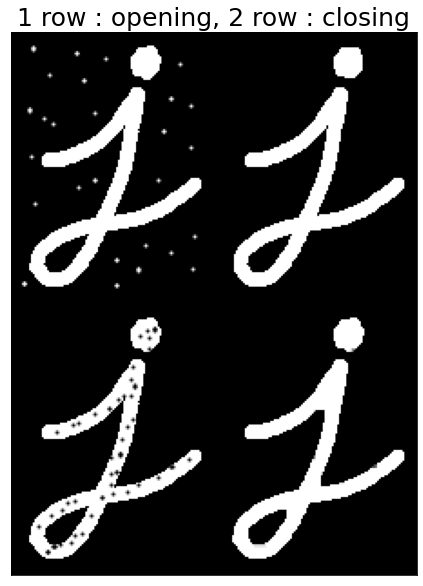

In [46]:
img1 = cv2.imread('./morph_dot.png', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('./morph_hole.png', cv2.IMREAD_GRAYSCALE)    

# 구조화 요소 커널, 사각형 (5x5) 생성 ---①
k = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))

# 열림 연산 적용 ---②
opening = cv2.morphologyEx(img1, cv2.MORPH_OPEN, k)

# 닫힘 연산 적용 ---③
closing = cv2.morphologyEx(img2, cv2.MORPH_CLOSE, k)

# 결과 출력
merged1 = np.hstack((img1, opening))
merged2 = np.hstack((img2, closing))
merged3 = np.vstack((merged1, merged2))

merged = cv2.cvtColor(merged3, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(20, 10))
plt.title('1 row : opening, 2 row : closing',fontsize=25)
plt.imshow(merged)
plt.xticks([])
plt.yticks([])
plt.show()

- 팽창 및 침식과 다르게 글씨의 굵기에는 변함이 없으면서 노이즈는 효과적으로 제거

### 팽창 연산에서 침식 연산을 뺀 그레디언트 연산

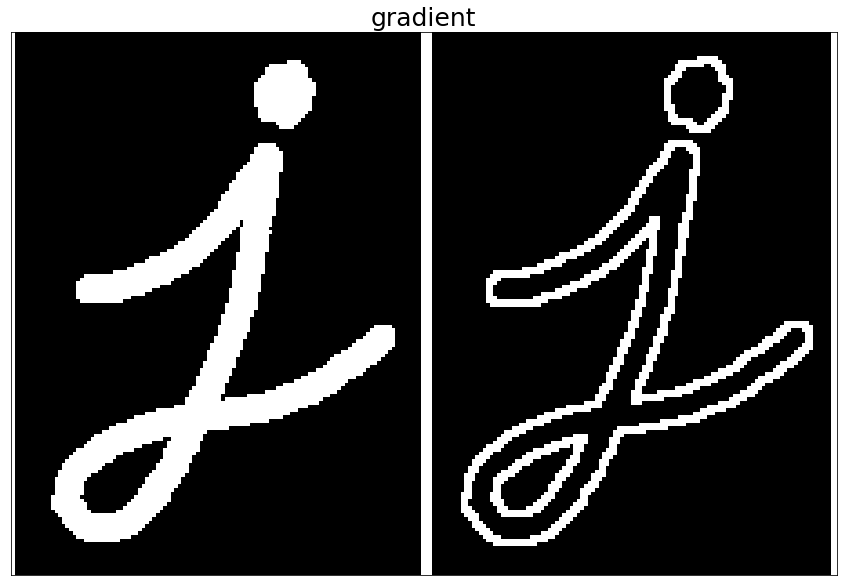

In [47]:
img = cv2.imread('./morphological.png')

# 구조화 요소 커널, 사각형 (3x3) 생성 ---①
k = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))

# 열림 연산 적용 ---②
gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, k)

# 결과 출력
merged = np.hstack((img, gradient))

plt.figure(figsize=(20, 10))
plt.title('gradient',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 경계 검출이 뚜렷하게 나옴

### 모폴로지 탑햇, 블랙햇 연산

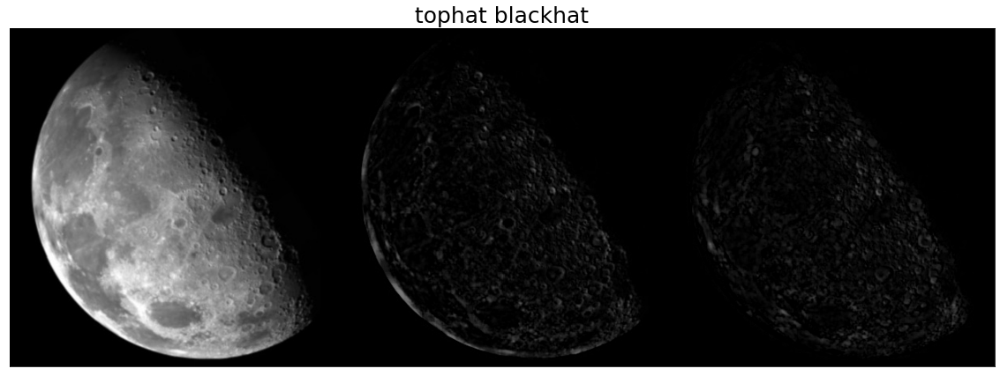

In [50]:
img = cv2.imread('./moon_gray.jpg')

# 구조화 요소 커널, 사각형 (5x5) 생성 ---①
k = cv2.getStructuringElement(cv2.MORPH_RECT, (9,9))

# 탑햇 연산 적용 ---②
tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, k)

# 블랫햇 연산 적용 ---③
blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, k)

# 결과 출력
merged = np.hstack((img, tophat, blackhat))

plt.figure(figsize=(20, 10))
plt.title('tophat blackhat',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 탑햇은 달의 밝은 부분을 강조, 블랙햇은 달의 어두운 부분을 강조

## 17. 이미지 피라미드(Image Pyramid)

- 이미지 피라미드(image pyramid)란 이미지의 크기를 피라미드처럼 단계적으로 확대하거나 축소하는 작업

### 가우시안 피라미드

- 가우시안 필터를 적용한 뒤 이미지 피라미드를 구성하는 것

```python
dst = cv2.pyrDown(src, dst, dstsize, borderType)
dst = cv2.pyrUp(src, dst, dstsize, borderType)
```
        src: 입력 영상
        dst: 결과 영상
        distsize: 결과 영상 크기
        borderType: 외곽 보정 방식
        
- cv2.pyrDown()은 가우시안 필터를 적용한 뒤 모든 짝수 행과 열을 삭제해 입력 영상의 1/4 크기로 축소
- cv2.pyrUp()은 0으로 채워진 짝수 행과 열을 새롭게 삽입하고 나서 가우시안 필터를 적용해 주변 픽셀과 비슷하게 만드는 방법으로 크기는 4배 확대

### 가우시안 이미지 피라미드

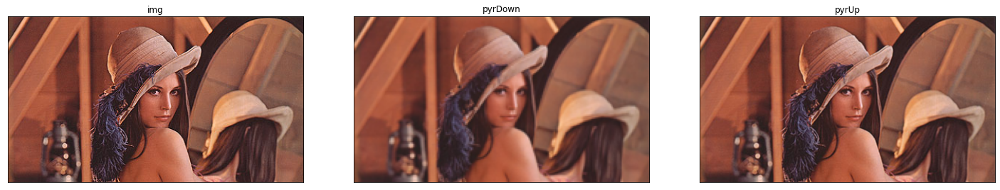

In [58]:
img = cv2.imread('./test_image.jpg')

# 가우시안 이미지 피라미드 축소
smaller = cv2.pyrDown(img) # img x 1/4
# 가우시안 이미지 피라미드 확대
bigger = cv2.pyrUp(img) # img x 4

# 결과 출력
imgs = {'img' : img, 'pyrDown' : smaller, 'pyrUp' : bigger}

fig, axes = plt.subplots(1,3,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- 실제 수행결과에서 왼쪽이 중간사이즈, 가운대가 작은사이즈, 오른쪽이 큰사이즈
- 이미지 피라미드로 축소하거나 확대한 이미지는 화질이 떨어짐

### 라플라시안 피라미드

- cv2.pyUp() 함수로 이미지를 확대하면 0으로 채워진 행과 열이 새롭게 삽입되므로 원본 이미지보다 화질이 떨어짐
-  cv2.pyDown() 함수를 적용한 뒤 다시 cv2.pyUp()을 하면 원본 이미지보다 화질이 많이 떨어짐


    --> 이런 문제점을 개선한 방식이 라플라시안 피라미드

### 라플라시안 피라미드로 영상 복원

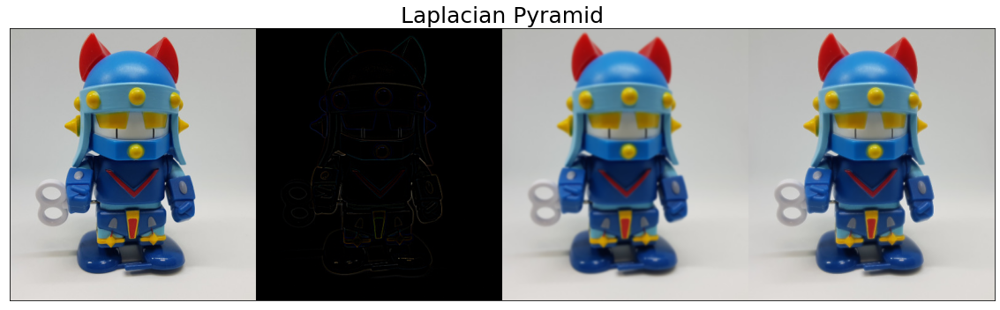

In [4]:
img = cv2.imread('./taekwonv1.jpg')

# 원본 영상을 가우시안 피라미드로 축소
smaller = cv2.pyrDown(img)

# 축소한 영상을 가우시안 피라미드로 확대
bigger = cv2.pyrUp(smaller)

# 원본에서 확대한 영상 빼기
laplacian = cv2.subtract(img, bigger)

# 확대 한 영상에 라플라시안 영상 더해서 복원
restored = bigger + laplacian

# 결과 출력 (원본 영상, 라플라시안, 확대 영상, 복원 영상)
merged = np.hstack((img, laplacian, bigger, restored))

plt.figure(figsize=(20, 10))
plt.title('Laplacian Pyramid',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 라플라시안 피라미드는 cv2.pyUp() 함수를 적용한 이미지와 원본 이미지의 차를 cv2.pyUp() 함수를 적용한 이미지에 더해주는 방식으로 구현
- cv2.pyUp()만 적용한 사진이 3번째 화질이 떨어짐
- 라플라시안 피라미드를 적용한 네 번째 이미지는 원본과 같이 또렷히 복구됨

## 18. 컨투어(Contour)

### 컨투어(Contour)

- 컨투어(contour)는 등고선을 의미
- 컨투어 찾는 함수

```python
contours, hierarchy = cv2.findContours(src, mode, method, contours, hierarchy, offset)
```
        src: 입력 영상, 검정과 흰색으로 구성된 바이너리 이미지
        mode: 컨투어 제공 방식 (cv2.RETR_EXTERNAL: 가장 바깥쪽 라인만 생성, cv2.RETR_LIST: 모든 라인을 계층 없이 생성, cv2.RET_CCOMP: 모든 라인을 2 계층으로 생성, cv2.RETR_TREE: 모든 라인의 모든 계층 정보를 트리 구조로 생성)
        method: 근사 값 방식 (cv2.CHAIN_APPROX_NONE: 근사 없이 모든 좌표 제공, cv2.CHAIN_APPROX_SIMPLE: 컨투어 꼭짓점 좌표만 제공, cv2.CHAIN_APPROX_TC89_L1: Teh-Chin 알고리즘으로 좌표 개수 축소, cv2.CHAIN_APPROX_TC89_KC0S: Teh-Chin 알고리즘으로 좌표 개수 축소)
        contours(optional): 검출한 컨투어 좌표 (list type)
        hierarchy(optional): 컨투어 계층 정보 (Next, Prev, FirstChild, Parent, -1 [해당 없음])
        offset(optional): ROI 등으로 인해 이동한 컨투어 좌표의 오프셋

- 컨투어를 그리는 함수

```python
cv2.drawContours(img, contours, contourIdx, color, thickness)
```
        img: 입력 영상
        contours: 그림 그릴 컨투어 배열 (cv2.findContours() 함수의 반환 결과를 전달해주면 됨)
        contourIdx: 그림 그릴 컨투어 인덱스, -1: 모든 컨투어 표시
        color: 색상 값
        thickness: 선 두께, 0: 채우기

- cv2.darwContours()는 실제로 컨투어 선을 그리는 함수
-  img영상에 contours 배열에 있는 컨투어 중 contourIdx에 해당하는 컨투어를 color 색상과 thickness 두께로 선을 그림

### 컨투어 찾기와 그리기

도형의 갯수: 3(3)


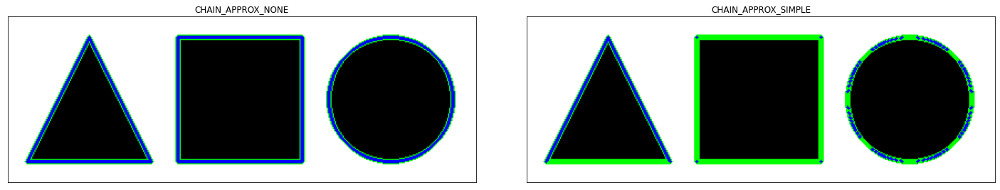

In [8]:
img = cv2.imread('./shapes.png')
img2 = img.copy()

# 그레이 스케일로 변환 ---①
imgray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# 스레시홀드로 바이너리 이미지로 만들어서 검은배경에 흰색전경으로 반전 ---②
ret, imthres = cv2.threshold(imgray, 127, 255, cv2.THRESH_BINARY_INV)

# 가장 바깥쪽 컨투어에 대해 모든 좌표 반환 ---③
contour, hierarchy = cv2.findContours(imthres, cv2.RETR_EXTERNAL, \
                                                 cv2.CHAIN_APPROX_NONE)
# 가장 바깥쪽 컨투어에 대해 꼭지점 좌표만 반환 ---④
contour2, hierarchy = cv2.findContours(imthres, cv2.RETR_EXTERNAL, \
                                                cv2.CHAIN_APPROX_SIMPLE)
# 각각의 컨투의 갯수 출력 ---⑤
print('도형의 갯수: %d(%d)'% (len(contour), len(contour2)))

# 모든 좌표를 갖는 컨투어 그리기, 초록색  ---⑥
cv2.drawContours(img, contour, -1, (0,255,0), 4)

# 꼭지점 좌표만을 갖는 컨투어 그리기, 초록색  ---⑦
cv2.drawContours(img2, contour2, -1, (0,255,0), 4)

# 컨투어 모든 좌표를 작은 파랑색 점(원)으로 표시 ---⑧
for i in contour:
    for j in i:
        cv2.circle(img, tuple(j[0]), 1, (255,0,0), -1) 

# 컨투어 꼭지점 좌표를 작은 파랑색 점(원)으로 표시 ---⑨
for i in contour2:
    for j in i:
        cv2.circle(img2, tuple(j[0]), 1, (255,0,0), -1) 

# 결과 출력 ---⑩
imgs = {'CHAIN_APPROX_NONE' : img, 'CHAIN_APPROX_SIMPLE' : img2}

fig, axes = plt.subplots(1,2,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- 왼쪽은 파라미터로 cv2.CHAIN_APPROX_SIMPLE을 사용해서 꼭짓점만 표시, 오른쪽은 cv2.CHAIN_APPROX_NONE을 사용해서 모든 좌표에 컨투어 표시

### 컨투어 계층 트리

3 [[[ 1 -1 -1 -1]
  [ 2  0 -1 -1]
  [-1  1 -1 -1]]]
6 [[[ 2 -1  1 -1]
  [-1 -1 -1  0]
  [ 4  0  3 -1]
  [-1 -1 -1  2]
  [-1  2  5 -1]
  [-1 -1 -1  4]]]


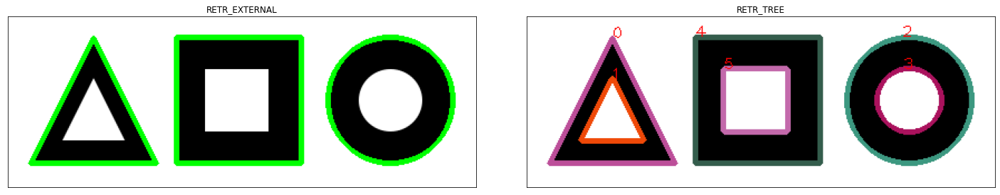

In [10]:
# 영상 읽기
img = cv2.imread('./shapes_donut.png')
img2 = img.copy()

# 바이너리 이미지로 변환
imgray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
ret, imthres = cv2.threshold(imgray, 127, 255, cv2.THRESH_BINARY_INV)

# 가장 바깥 컨투어만 수집   --- ①
contour, hierarchy = cv2.findContours(imthres, cv2.RETR_EXTERNAL, \
                                                cv2.CHAIN_APPROX_NONE)
# 컨투어 갯수와 계층 트리 출력 --- ②
print(len(contour), hierarchy)

# 모든 컨투어를 트리 계층 으로 수집 ---③
contour2, hierarchy = cv2.findContours(imthres, cv2.RETR_TREE, \
                                            cv2.CHAIN_APPROX_SIMPLE)
# 컨투어 갯수와 계층 트리 출력 ---④
print(len(contour2), hierarchy)

# 가장 바깥 컨투어만 그리기 ---⑤
cv2.drawContours(img, contour, -1, (0,255,0), 3)

# 모든 컨투어 그리기 ---⑥
for idx, cont in enumerate(contour2): 
    
    # 랜덤한 컬러 추출 ---⑦
    color = [int(i) for i in np.random.randint(0,255, 3)]
    
    # 컨투어 인덱스 마다 랜덤한 색상으로 그리기 ---⑧
    cv2.drawContours(img2, contour2, idx, color, 3)
    
    # 컨투어 첫 좌표에 인덱스 숫자 표시 ---⑨
    cv2.putText(img2, str(idx), tuple(cont[0][0]), cv2.FONT_HERSHEY_PLAIN, \
                                                            1, (0,0,255))

# 화면 출력
imgs = {'RETR_EXTERNAL' : img, 'RETR_TREE' : img2}

fig, axes = plt.subplots(1,2,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- 파라미터로 cv2.RETR_EXTERNAL을 전달할 때는 그림의 외곽 부분에만 컨투어 표시
- cv2.RETR_TREE를 전달할 때는 모든 경계에 컨투어 생성 -> 트리 계층 컨투어
    - 다양한 색으로 표시한 것 위의 오른쪽 이미지는 

### 컨투어를 감싸는 도형 그리기

```python
x, y, w, h = cv2.boundingRect(contour): 좌표를 감싸는 사각형 반환
```
        x, y: 사각형의 왼쪽 상단 좌표
        w, h: 사각형의 폭과 높이
    
```python
rotateRect = cv2.minAreaRect(contour): 좌표를 감싸는 최소한의 사각형 계산
vertex = cv2.boxPoints(rotateRect): rotateRect로부터 꼭짓점 좌표 계산
```
        vertex: 4개의 꼭짓점 좌표, 소수점 포함이므로 정수 변환 필요

```python
center, radius = cv2.minEnclosingCircle(contour): 좌표를 감싸는 최소한의 동그라미 계산
```
        center: 원점 좌표(x, y)
        radius: 반지름

```python
area, triangle = cv2.minEnclosingTriangle(points): 좌표를 감싸는 최소한의 삼각형 게산
```
        area: 넓이
        triangle: 3개의 꼭짓점 좌표
        
```python
ellipse = cv2.fitEllipse(points): 좌표를 감싸는 최소한의 타원 계산
```

```python
line = cv2.fitLine(points, distType, param, reps, aeps, line): 중심점을 통과하는 직선 계산
```
        distType: 거리 계산 방식 (cv2.DIST_L2, cv2.DIST_L1, cv2.DIST_L12, cv2.DIST_FAIR, cv2.DIST_WELSCH, cv2.DIST_HUBER)
        param: distType에 전달할 인자, 0 = 최적 값 선택
        reps: 반지름 정확도, 선과 원본 좌표의 거리, 0.01 권장
        aeps: 각도 정확도, 0.01 권장
        line(optional): vx, vy 정규화된 단위 벡터, x0, y0: 중심점 좌표

### 컨투어를 감싸는 도형 그리기

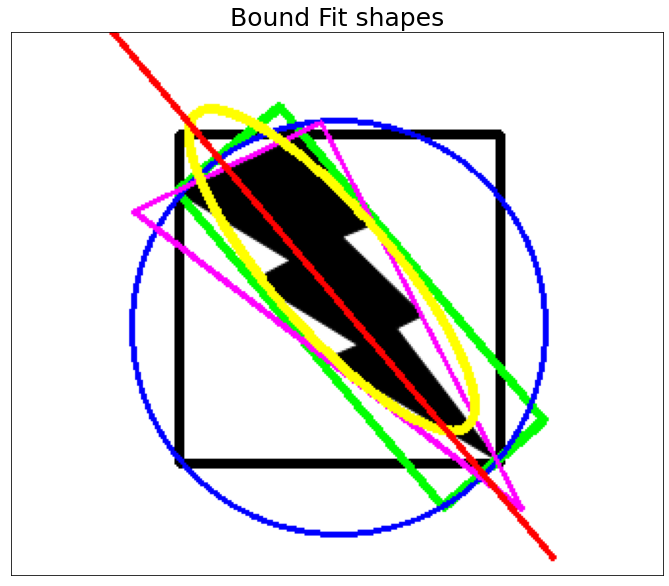

In [17]:
# 이미지 읽어서 그레이스케일 변환, 바이너리 스케일 변환
img = cv2.imread("./lightning.png")
imgray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
ret, th = cv2.threshold(imgray, 127,255,cv2.THRESH_BINARY_INV)

# 컨튜어 찾기
contours, hr = cv2.findContours(th, cv2.RETR_EXTERNAL, \
                                        cv2.CHAIN_APPROX_SIMPLE)
contr = contours[0]

# 감싸는 사각형 표시(검정색)
x,y,w,h = cv2.boundingRect(contr)
cv2.rectangle(img, (x,y), (x+w, y+h), (0,0,0), 3)

# 최소한의 사각형 표시(초록색)
rect = cv2.minAreaRect(contr)
box = cv2.boxPoints(rect)   # 중심점과 각도를 4개의 꼭지점 좌표로 변환
box = np.int0(box)          # 정수로 변환
cv2.drawContours(img, [box], -1, (0,255,0), 3)

# 최소한의 원 표시(파랑색)
(x,y), radius = cv2.minEnclosingCircle(contr)
cv2.circle(img, (int(x), int(y)), int(radius), (255,0,0), 2)

# 최소한의 삼각형 표시(분홍색)
ret, tri = cv2.minEnclosingTriangle(contr)
cv2.polylines(img, [np.int32(tri)], True, (255,0,255), 2)

# 최소한의 타원 표시(노랑색)
ellipse = cv2.fitEllipse(contr)
cv2.ellipse(img, ellipse, (0,255,255), 3)

# 중심점 통과하는 직선 표시(빨강색)
[vx,vy,x,y] = cv2.fitLine(contr, cv2.DIST_L2,0,0.01,0.01)
cols,rows = img.shape[:2]

cv2.line(img, (0, int(0-x*(vy/vx) + y)), (cols-1, int((cols-x)*(vy/vx) + y)), \
                                                        (0,0,255),2) # cv.2 좌표 int만 가능

# 결과 출력
plt.figure(figsize=(20, 10))
plt.title('Bound Fit shapes',fontsize=25)
plt.imshow(img[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

### 컨투어 단순화 

- 실생활에서 얻는 대부분의 이미지는 약간의 노이즈가 포함되어 있음
- 컨투어를 너무 정확히 그리는 것도 바람직하지 않음
- 약간 단순화해 그리는 게 정확하게 그리는 것보다 더 쓸모 있는 경우가 있음

- 근사값 컨투어 함수

```python
epsilon = cv2.arcLength(윤곽선, 폐곡선) ->  윤곽선의 전체 길이를 계산
```
        윤곽선은 검출된 윤곽선들이 저장된 Numpy 배열
        폐곡선은 검출된 윤곽선이 닫혀있는지, 열려있는지 설정
            - 폐곡선을 True로 사용할 경우, 윤곽선이 닫혀 최종 길이가 더 길어짐

```python
approx = cv2.approxPolyDP(contour, epsilon, closed)
```
        contour: 대상 컨투어 좌표
        epsilon: 근사 값 정확도, 오차 범위
        closed: 컨투어의 닫힘 여부
        approx: 근사 계산한 컨투어 좌표

### 근사 컨투어

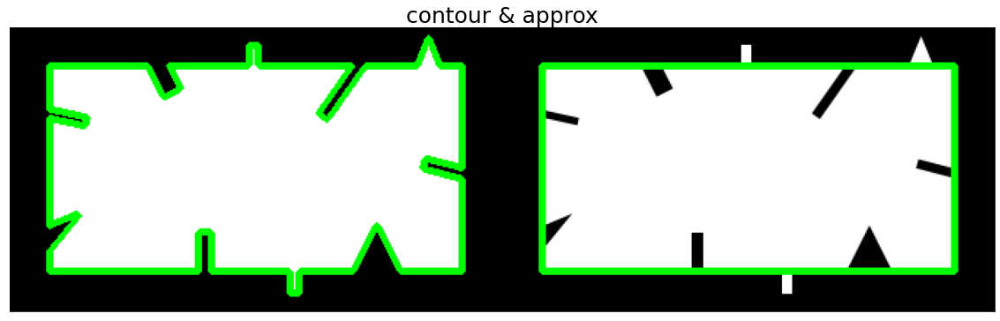

In [19]:
img = cv2.imread('./bad_rect.png')
img2 = img.copy()

# 그레이스케일과 바이너리 스케일 변환
imgray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) 
ret, th = cv2.threshold(imgray, 127, 255, cv2.THRESH_BINARY)

# 컨투어 찾기 ---①
contours, hierachy = cv2.findContours(th, cv2.RETR_EXTERNAL, \
                                     cv2.CHAIN_APPROX_SIMPLE)
contour = contours[0]

# 전체 둘레의 0.05로 오차 범위 지정 ---②
epsilon = 0.05 * cv2.arcLength(contour, True)

# 근사 컨투어 계산 ---③
approx = cv2.approxPolyDP(contour, epsilon, True)

# 각각 컨투어 선 그리기 ---④
cv2.drawContours(img, [contour], -1, (0,255,0), 3)
cv2.drawContours(img2, [approx], -1, (0,255,0), 3)

# 결과 출력
merged = np.hstack((img, img2))

plt.figure(figsize=(20, 10))
plt.title('contour & approx',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- cv2.approxPolyDP() 함수를 활용하면 오른쪽과 같이 들어가고 나온 부분은 무시하고 컨투어 계산

- 컨투어를 단순화하는 또 다른 형태는 볼록 선체(convex hull)를 만드는 것
    - 볼록 선체란 어느 한 부분도 오목하지 않은 도형을 의미
    - 볼록 선체는 대상을 완전히 포함하는 외곽 영역을 찾는데 유용

```python
hull = cv2.convexHull(points, hull, clockwise, returnPoints): 볼록 선체 계산
```
        points: 입력 컨투어
        hull(optional): 볼록 선체 결과
        clockwise(optional): 방향 지정 (True: 시계 방향)
        returnPoints(optional): 결과 좌표 형식 선택 (True: 볼록 선체 좌표 변환, False: 입력 컨투어 중에 볼록 선체에 해당하는 인덱스 반환)

```python
retval = cv2.isContourConvex(contour): 볼록 선체 만족 여부 확인
```
        retval: True인 경우 볼록 선체임

```python
defects = cv2.convexityDefects(contour, convexhull): 볼록 선체 결함 찾기
```
        contour: 입력 컨투어
        convexhull: 볼록 선체에 해당하는 컨투어의 인덱스
        defects: 볼록 선체 결함이 있는 컨투어의 배열 인덱스, N x 1 x 4 배열, [starts, end, farthest, distance]
            - start: 오목한 각이 시작되는 컨투어의 인덱스
            - end: 오목한 각이 끝나는 컨투어의 인덱스
            - farthest: 볼록 선체에서 가장 먼 오목한 지점의 컨투어 인덱스
            - distance: farthest와 볼록 선체와의 거리

### 볼록 선체

False True


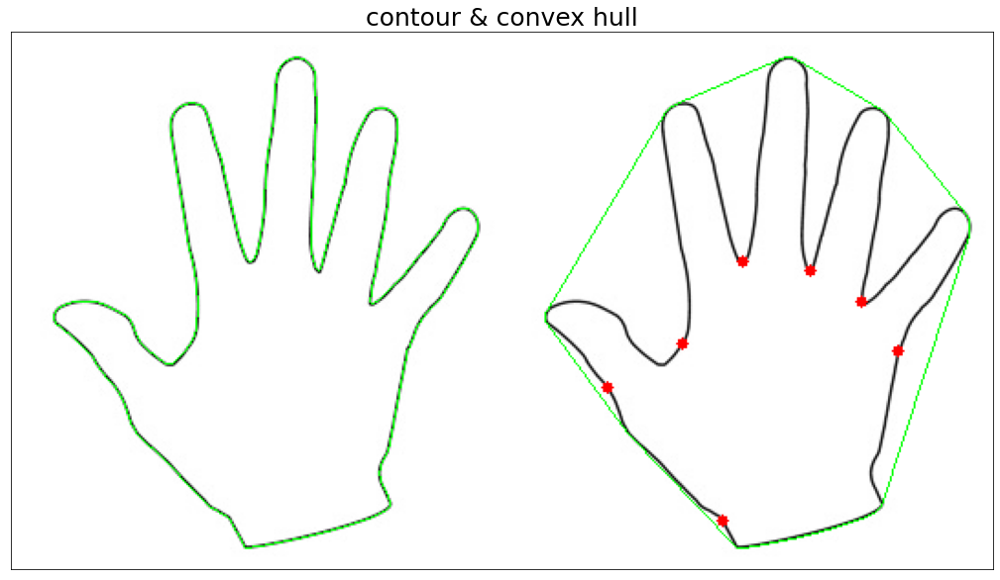

In [21]:
img = cv2.imread('./hand.jpg')
img2 = img.copy()

# 그레이 스케일 및 바이너리 스케일 변환 ---①
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
ret, th = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY_INV)

# 컨투어 찾기와 그리기 ---②
contours, heiarchy = cv2.findContours(th, cv2.RETR_EXTERNAL, \
                                         cv2.CHAIN_APPROX_SIMPLE)
cntr = contours[0]
cv2.drawContours(img, [cntr], -1, (0, 255,0), 1)

# 볼록 선체 찾기(좌표 기준)와 그리기 ---③
hull = cv2.convexHull(cntr)
cv2.drawContours(img2, [hull], -1, (0,255,0), 1)

# 볼록 선체 만족 여부 확인 ---④
print(cv2.isContourConvex(cntr), cv2.isContourConvex(hull))

# 볼록 선체 찾기(인덱스 기준) ---⑤
hull2 = cv2.convexHull(cntr, returnPoints=False)

# 볼록 선체 결함 찾기 ---⑥
defects = cv2.convexityDefects(cntr, hull2)

# 볼록 선체 결함 순회
for i in range(defects.shape[0]):
    # 시작, 종료, 가장 먼 지점, 거리 ---⑦
    startP, endP, farthestP, distance = defects[i, 0]
    # 가장 먼 지점의 좌표 구하기 ---⑧
    farthest = tuple(cntr[farthestP][0])
    # 거리를 부동 소수점으로 변환 ---⑨
    dist = distance/256.0
    # 거리가 1보다 큰 경우 ---⑩
    if dist > 1 :
        # 빨강색 점 표시 
        cv2.circle(img2, farthest, 3, (0,0,255), -1)
        
# 결과 이미지 표시
merged = np.hstack((img, img2))

plt.figure(figsize=(20, 10))
plt.title('contour & convex hull',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

### 컨투어와 도형 매칭

- 서로 다른 물체의 컨투어를 비교하면 두 물체가 얼마나 비슷한지 알 수 있음

```python
retval = cv2.matchShapes(contour1, contour2, method, parameter): 두 개의 컨투어로 도형 매칭
```
        contour1, contour2: 비교할 두 개의 컨투어
        method: 휴 모멘트 비교 알고리즘 선택 플래그 (cv2.CONTOURS_MATCH_I1, cv2.CONTOURS_MATCH_I2, cv2.CONTOURS_MATCH_I3)
        parameter: 알고리즘에 전달을 위한 예비 인수로 0으로 고정
        retval: 두 도형의 닮은 정도 (0=동일, 숫자가 클수록 다름)

### 도형 매칭으로 비슷한 도형 찾기

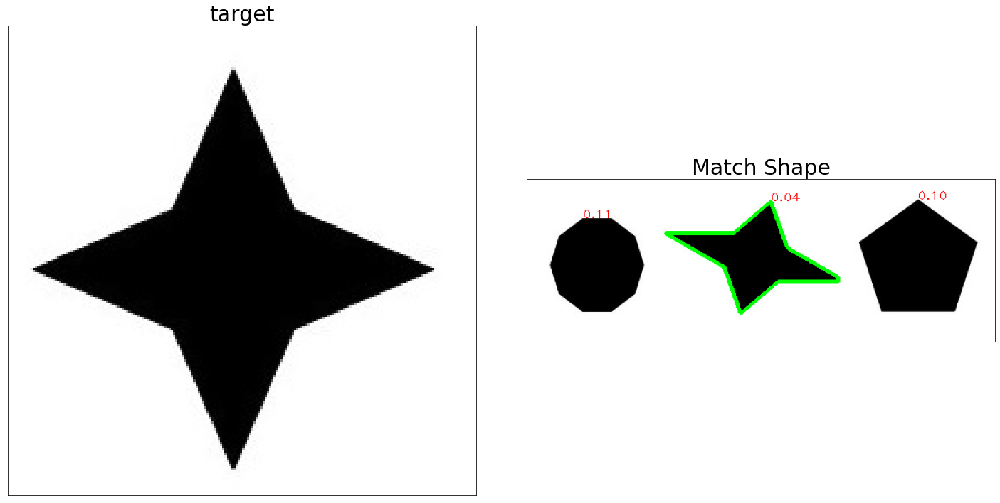

In [26]:
# 매칭을 위한 이미지 읽기
target = cv2.imread('./4star.jpg') # 매칭 대상
shapes = cv2.imread('./shapestomatch.jpg') # 여러 도형

# 그레이 스케일 변환
targetGray = cv2.cvtColor(target, cv2.COLOR_BGR2GRAY)
shapesGray = cv2.cvtColor(shapes, cv2.COLOR_BGR2GRAY)

# 바이너리 스케일 변환
ret, targetTh = cv2.threshold(targetGray, 127, 255, cv2.THRESH_BINARY_INV)
ret, shapesTh = cv2.threshold(shapesGray, 127, 255, cv2.THRESH_BINARY_INV)

# 컨투어 찾기
cntrs_target, _ = cv2.findContours(targetTh, cv2.RETR_EXTERNAL, \
                                            cv2.CHAIN_APPROX_SIMPLE)
cntrs_shapes, _ = cv2.findContours(shapesTh, cv2.RETR_EXTERNAL, \
                                            cv2.CHAIN_APPROX_SIMPLE)

# 각 도형과 매칭을 위한 반복문
matchs = [] # 컨투어와 매칭 점수를 보관할 리스트
for contr in cntrs_shapes:
    # 대상 도형과 여러 도형 중 하나와 매칭 실행 ---①
    match = cv2.matchShapes(cntrs_target[0], contr, cv2.CONTOURS_MATCH_I2, 0.0)
    # 해당 도형의 매칭 점수와 컨투어를 쌍으로 저장 ---②
    matchs.append( (match, contr) )
    # 해당 도형의 컨투어 시작지점에 매칭 점수 표시 ---③
    cv2.putText(shapes, '%.2f'%match, tuple(contr[0][0]),\
                    cv2.FONT_HERSHEY_PLAIN, 1,(0,0,255),1 )
    
# 매칭 점수로 정렬 ---④
matchs.sort(key=lambda x : x[0])

# 가장 적은 매칭 점수를 얻는 도형의 컨투어에 선 그리기 ---⑤
cv2.drawContours(shapes, [matchs[0][1]], -1, (0,255,0), 3)

imgs = {'target' : target, 'Match Shape' : shapes}
fig, axes = plt.subplots(1,2,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i,fontsize=30)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- cv2.matchShapes()을 통해서 가장 적은 수가 서로 닮은 이미지

## 19. 허프 변환(Hough Transformation)

### 허프 변환

- 허프 변환을 활용해 이미지에서 직선이나 원과 같은 다양한 모양을 인식이 가능

### 허프 선 변환

- 이미지는 수많은 픽셀로 구성, 그 픽셀 중 서로 직선 관계를 갖는 픽셀들만 골라내는 것이 허프 선 변환의 핵심

```python
lines = cv2.HoughLines(img, rho, theta, threshold, lines, srn=0, stn=0, min_theta, max_theta)
```
        img: 입력 이미지, 1 채널 바이너리 스케일
        rho: 거리 측정 해상도, 0~1
        theta: 각도, 라디안 단위 (np.pi/0~180)
        threshold: 직선으로 판단할 최소한의 동일 개수 (작은 값: 정확도 감소, 검출 개수 증가 / 큰 값: 정확도 증가, 검출 개수 감소)
        lines: 검출 결과, N x 1 x 2 배열 (r, Θ)
        srn, stn: 멀티 스케일 허프 변환에 사용, 선 검출에서는 사용 안 함
        min_theta, max_theta: 검출을 위해 사용할 최대, 최소 각도
        
- 거리와 각도를 얼마나 세밀하게 계산할 것인지 -> rho와 theta 파라미터로 조정
- threshold는 같은 직선에 몇 개의 점이 등장해야 직선으로 판단할지를 나타내는 최소한의 개수를 의미

### 허프 선 검출

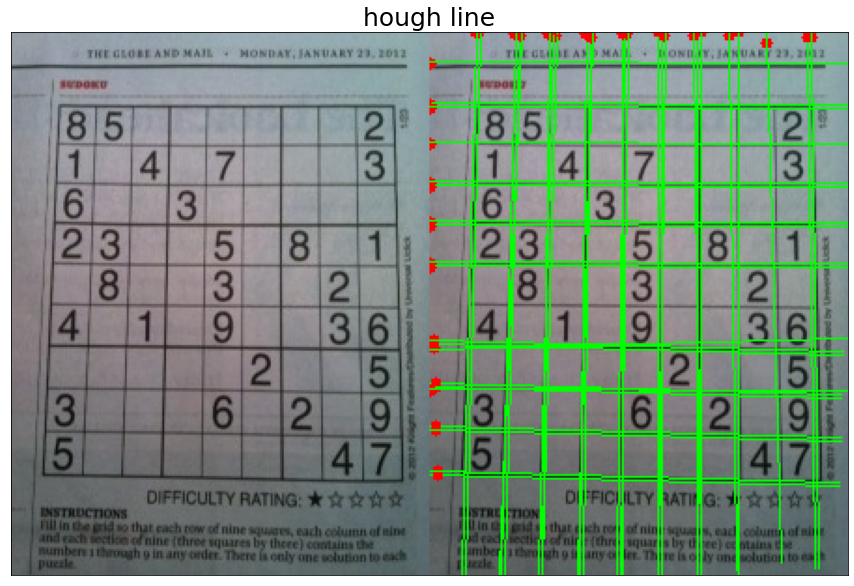

In [29]:
img = cv2.imread('./sudoku.jpg')
img2 = img.copy()
h, w = img.shape[:2]

# 그레이 스케일 변환 및 엣지 검출 ---①
imgray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
edges = cv2.Canny(imgray, 100, 200 )

# 허프 선 검출, 직선으로 판단할 최소한의 점은 130개로 지정 ---②
lines = cv2.HoughLines(edges, 1, np.pi/180, 130)
for line in lines: # 검출된 모든 선 순회
    r,theta = line[0] # 거리와 각도
    tx, ty = np.cos(theta), np.sin(theta) # x, y축에 대한 삼각비
    x0, y0 = tx*r, ty*r  #x, y 기준(절편) 좌표
    
    # 기준 좌표에 빨강색 점 그리기
    cv2.circle(img2, (int(abs(x0)), int(abs(y0))), 3, (0,0,255), -1) # 좌표는 정수
    
    # 직선 방정식으로 그리기 위한 시작점, 끝점 계산
    x1, y1 = int(x0 + w*(-ty)), int(y0 + h * tx)
    x2, y2 = int(x0 - w*(-ty)), int(y0 - h * tx)
    
    # 선그리기
    cv2.line(img2, (x1, y1), (x2, y2), (0,255,0), 1)

#결과 출력    
merged = np.hstack((img, img2))

plt.figure(figsize=(20, 10))
plt.title('hough line',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

### 확률적 허프 선 변환

- 허프 선 검출은 모든 점에 대해 수많은 선을 그어서 직선을 찾기 때문에 연산량이 많음
- 이를 개선하기 위한 방법이 확률적 허프 선 변환
    - 모든 점을 고려하지 않고 무작위로 선정한 픽셀에 대해 허프 변환을 수행, 점차 그 수를 증가시키는 방법
    

```python
lines = cv2.HoughLinesP(img, rho, theta, threshold, lines, minLineLength, maxLineGap)
```
        minLineLength(optional): 선으로 인정할 최소 길이
        maxLineGap(optional): 선으로 판단할 최대 간격
        lines: 검출된 선 좌표, N x 1 x 4 배열 (x1, y1, x2, y2)
        이외의 파라미터는 cv2.HoughLines()와 동일
        
- cv2.HoughLines()의 검출 결과는 r, Θ이지만 cv2.HoughLinesP()의 검출 결과는 선의 시작과 끝 좌표
    - 확률적으로 선을 검출하므로 당연히 cv2.HoughLines()보다 선 검출이 적음
    - 엣지를 강하게 하고 threshold를 낮게 지정

### 확률 허프 변환으로 선 검출

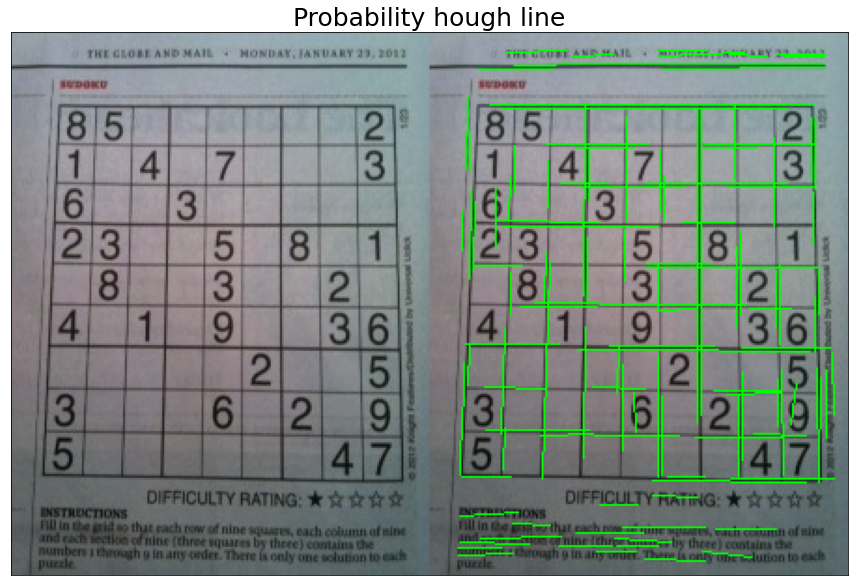

In [31]:
img = cv2.imread('./sudoku.jpg')
img2 = img.copy()

# 그레이 스케일로 변환 및 엣지 검출 ---①
imgray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
edges = cv2.Canny(imgray, 50, 200)

# 확율 허프 변환 적용 ---②
lines = cv2.HoughLinesP(edges, 1, np.pi/180, 10, None, 20, 2)
for line in lines:
    # 검출된 선 그리기 ---③
    x1, y1, x2, y2 = line[0]
    cv2.line(img2, (x1,y1), (x2, y2), (0,255,0), 1)

merged = np.hstack((img, img2))

plt.figure(figsize=(20, 10))
plt.title('Probability hough line',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- cv2.HoughLines()보다는 선을 잘 검출하지 못함
    - 하지만 속도는 더 빠름
- cv2.HoughLinesP()의 반환 값이 선의 시작과 끝 좌표이므로 직선을 그리기가 더 편함

### 허프 원 변환

```python
circle = cv2.HoughCircles(img, method, dp, minDist, circles, param1, param2, minRadius, maxRadius)
```
        img: 입력 이미지, 1채널 배열
        method: 검출 방식 선택 (현재 cv2.HOUGH_GRADIENT만 가능)
        dp: 입력 영상과 경사 누적의 해상도 반비례율, 1: 입력과 동일, 값이 커질수록 부정확
        minDist: 원들 중심 간의 최소 거리 (0: 에러, 0이면 동심원이 검출 불가하므로)
        circles(optional): 검출 원 결과, N x 1 x 3 부동 소수점 배열 (x, y, 반지름)
        param1(optional): 캐니 엣지에 전달할 스레시홀드 최대 값 (최소 값은 최대 값의 2배 작은 값을 전달)
        param2(optional): 경사도 누적 경계 값 (값이 작을수록 잘못된 원 검출)
        minRadius, maxRadius(optional): 원의 최소 반지름, 최대 반지름 (0이면 이미지 전체의 크기)
        
- cv2.HoughCircles는 캐니 엣지를 수행, 소벨 필터를 적용해 엣지의 경사도(gradient)를 누적하는 방법으로 원 검출을 구현

### 허프 원 검출

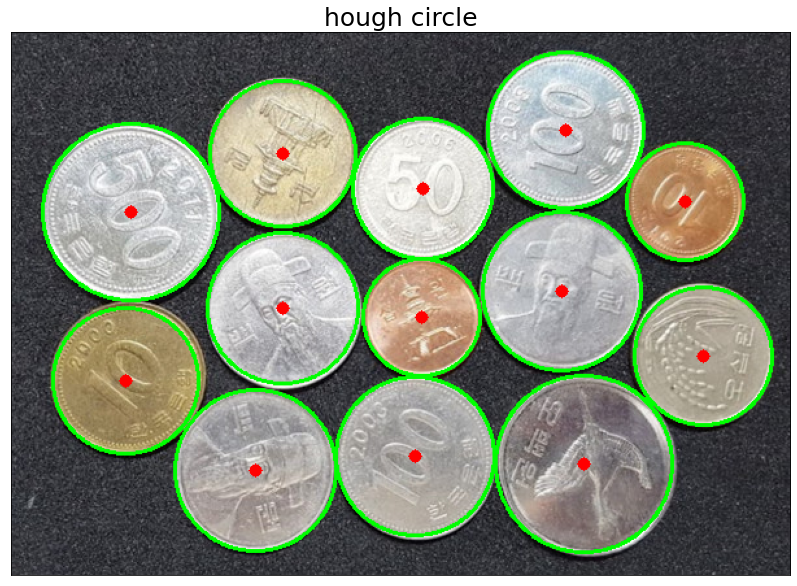

In [33]:
img = cv2.imread('./coins_connected.jpg')

# 그레이 스케일 변환 ---①
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# 노이즈 제거를 위한 가우시안 블러 ---②
blur = cv2.GaussianBlur(gray, (3,3), 0)

# 허프 원 변환 적용( dp=1.2, minDist=30, cany_max=200 ) ---③
circles = cv2.HoughCircles(blur, cv2.HOUGH_GRADIENT, 1.2, 30, None, 200)

if circles is not None:
    circles = np.uint16(np.around(circles))
    for i in circles[0,:]:
        # 원 둘레에 초록색 원 그리기
        cv2.circle(img,(i[0], i[1]), i[2], (0, 255, 0), 2)
        # 원 중심점에 빨강색 원 그리기
        cv2.circle(img, (i[0], i[1]), 2, (0,0,255), 5)

# 결과 출력
plt.figure(figsize=(20, 10))
plt.title('hough circle',fontsize=25)
plt.imshow(img[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- cv2.HoughCircles()는 함수 자체적으로 캐니 엣지를 사용하므로 위 코드에서는 가우시안 블러를 통해 노이즈만 제거, 엣지 검출 X
- dp의 값은 1에 가까울수록 정확하게 원을 검출, dp 값을 경험적으로 조정

## 20. 연속 영역 분할 (거리 변환, 레이블링, 색 채우기, 워터셰드, 그랩컷, 평균 이동 필터)

### 거리 변환 (Distatnce Transformation)

- 이미지에서 물체 영역을 정확히 파악하기 위해서는 물체 영역의 뼈대를 찾아야함
- 뼈대를 검출하는 방법 중 하나가 외곽 경계로부터 가장 멀리 떨어진 곳을 찾는 방법인 거리 변환임

```python
cv2.distanceTransform(src, distanceType, maskSize)
```
        src: 입력 영상, 바이너리 스케일
        distanceType: 거리 계산 방식 (cv2.DIST_L2, cv2.DIST_L1, cv2.DIST_L12, cv2.DIST_FAIR, cv2.DIST_WELSCH, cv2.DIST_HUBER)
        maskSize: 거리 변환 커널 크기

### 거리 변환으로 전신 스켈레톤 찾기

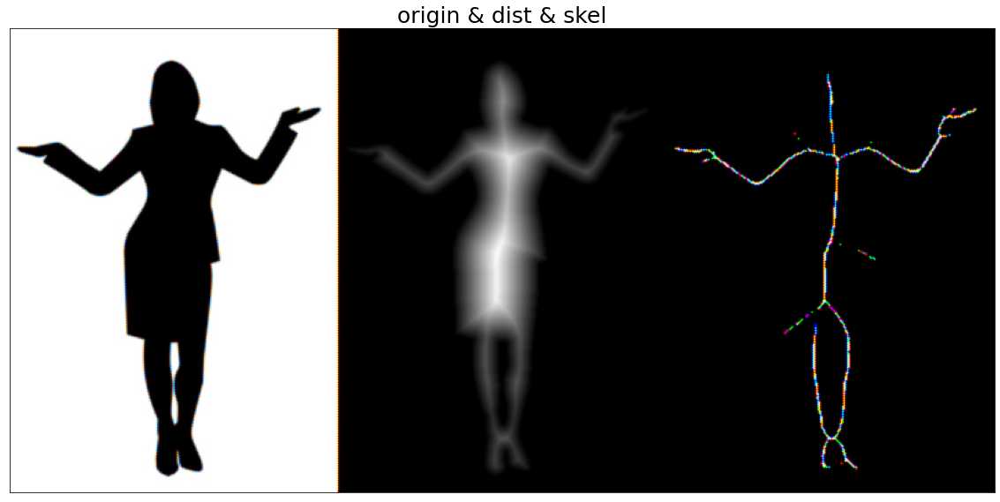

In [41]:
# 이미지를 읽어서 바이너리 스케일로 변환
img = cv2.imread('./full_body.jpg', cv2.IMREAD_GRAYSCALE)
_, biimg = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY_INV)

# 거리 변환 ---①
dst = cv2.distanceTransform(biimg, cv2.DIST_L2, 5)

# 거리 값을 0 ~ 255 범위로 정규화 ---②
dst = (dst/(dst.max()-dst.min()) * 255).astype(np.uint8)

# 거리 값에 쓰레시홀드로 완전한 뼈대 찾기 ---③
skeleton = cv2.adaptiveThreshold(dst, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, \
                                                 cv2.THRESH_BINARY, 7, -3)
# 결과 출력
merged = np.hstack((img, dst, skeleton))
merge = cv2.cvtColor(merged,cv2.COLOR_BAYER_BG2RGB)

plt.figure(figsize=(20, 10))
plt.title('origin & dist & skel',fontsize=25)
plt.imshow(merge)
plt.xticks([])
plt.yticks([])
plt.show()

- 왼쪽 이미지는 원본 이미지를 바이너리 스케일로 변환한 이미지
- 가운데 이미지는 0 ~ 255 범위로 정규화한 거리 변환 결과
    - 외곽 경계로부터 멀어질수록 흰색이 짙어짐
- 오른쪽 이미지는 가운데 이미지에서 픽셀 값=255(흰색)에 해당하는 부분만 추출한 것
    - 이게 이미지의 뼈대, 경계로부터 가장 멀리 떨어져 있는 부분만 추출

### 레이블링 (Labeling)

- 연결된 요소끼리 분리하는 방법 중 레이블링이라는 방법이 존재
- 이미지에서 픽셀 값이 0으로 끊어지지 않는 부분끼리 같은 값을 부여해서 분리를 할 수 있음
- 이미지 전체에서 0으로 끊어지지 않는 부분끼리 같은 값을 부여

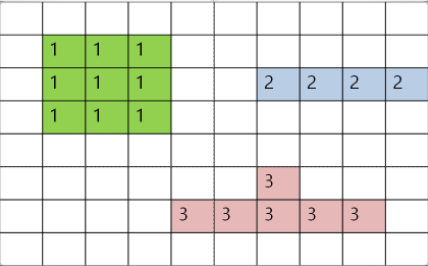


```python
retval, labels = cv2.connectedComponents(src, labels, connectivity=8, ltype): 연결 요소 레이블링과 개수 반환
```
        src: 입력 이미지, 바이너리 스케일
        retval(optional): 레이블 개수
        labels(optional): 레이블링된 입력 이미지와 같은 크기의 배열
        connectivity(optional): 연결성을 검사할 방향 개수(4, 8 중 선택)
        ltype(optional): 결과 레이블 배열 dtype
        
```python
retval, labels, stats, centroids = cv2.connectedComponentsWithStats(src, labels, stats, centroids, connectivity, ltype): 레이블링된 각종 상태 정보 반환
```
        stats: N x 5 행렬 (N: 레이블 개수) [x좌표, y좌표, 폭, 높이, 너비]
        centroids: 각 레이블의 중심점 좌표, N x 2 행렬 (N: 레이블 개수)
        
         src: 8비트 1채널 영상
         labels: 레이블 맵 행렬. 입력 영상과 같은 크기. numpy.ndarray.
         stats: 각 객체의 바운딩 박스, 픽셀 개수 정보를 담은 행렬. numpy.ndarray. shape=(N, 5), N x 5 행렬 (N: 레이블 개수) [x좌표, y좌표, 폭, 높이, 너비]
         centroids: 각 객체의 무게 중심 위치 정보를 담은 행렬 numpy.ndarray. shape=(N, 2)
         ltype: labels 행렬 타입. cv2.CV_32S 또는 cv2.CV_16S. 기본값은 cv2.CV_32S

### 연결된 영역 레이블링

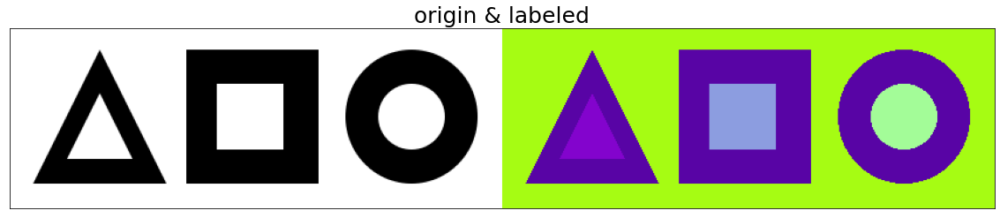

In [50]:
# 이미지 읽기
img = cv2.imread('./shapes_donut.png')

# 결과 이미지 생성
img2 = np.zeros_like(img)

# 그레이 스케일과 바이너리 스케일 변환
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
_, th = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)

# 연결된 요소 레이블링 적용 ---①
cnt, labels = cv2.connectedComponents(th)
#retval, labels, stats, cent = cv2.connectedComponentsWithStats(th)

# 레이블 갯수 만큼 순회
for i in range(cnt):
    # 레이블이 같은 영역에 랜덤한 색상 적용 ---②
    img2[labels==i] =  [int(j) for j in np.random.randint(0,255, 3)]


# 결과 출력
merged = np.hstack((img, img2))

plt.figure(figsize=(20, 10))
plt.title('origin & labeled',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- cv2.connectedComponents() 함수는 이미지 전체에서 0으로 끊어지지 않는 부분끼리 같은 값을 부여
- 반환된 결과를 순회하면서 같은 값끼리는 같은 색상 부여해서 labeling

### 워터셰드 (Watershed)

- 워터셰드(watershed)는 강물이 한 줄기로 흐르다가 갈라지는 경계인 분수령을 뜻함
    - 연속된 영역을 찾는 것
- seed를 하나가 아닌 여러 개를 지정할 수 있고 이를 마커라고 함

```python
markers = cv2.watershed(img, markers)
```
        img: 입력 이미지
        markers: 마커, 입력 이미지와 크기가 같은 1차원 배열(int32)
            - markers는 입력 이미지와 행과 열 크기가 같은 1차원 배열로 전달
            - markers의 값은 경계를 찾고자 하는 픽셀 영역은 -1을 갖게 하고 나머지 연결된 영역에 대해서는 동일한 정수 값 (1은 배경, 2는 전경)

### 마우스와 워터셰드로 배경 분리

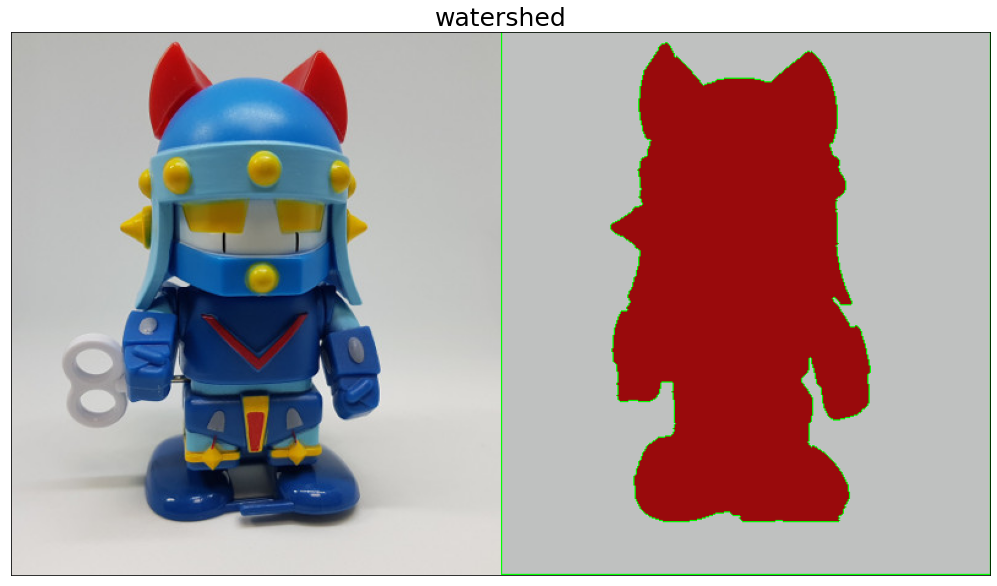

In [60]:
img = cv2.imread('./taekwonv1.jpg')
rows, cols = img.shape[:2]
img_draw = img.copy()

# 마커 생성, 모든 요소는 0으로 초기화 ---①
marker = np.zeros((rows, cols), np.int32)
markerId = 1        # 마커 아이디는 1에서 시작
colors = []         # 마커 선택한 영역 색상 저장할 공간
isDragging = False  # 드래그 여부 확인 변수

# 마우스 이벤트 처리 함수
def onMouse(event, x, y, flags, param):
    global img_draw, marker, markerId, isDragging
    if event == cv2.EVENT_LBUTTONDOWN:  # 왼쪽 마우스 버튼 다운, 드래그 시작 
        isDragging = True
        # 각 마커의 아이디와 현 위치의 색상 값을 쌍으로 매핑해서 저장 
        colors.append((markerId, img[y,x]))
    elif event == cv2.EVENT_MOUSEMOVE:  # 마우스 움직임
        if isDragging:                  # 드래그 진행 중
            # 마우스 좌표에 해당하는 마커의 좌표에 동일한 마커 아이디로 채워 넣기 ---②
            marker[y,x] = markerId
            # 마커 표시한 곳을 빨강색점으로 표시해서 출력
            cv2.circle(img_draw, (x,y), 3, (0,0,255), -1)
            cv2.imshow('watershed', img_draw)
            
    elif event == cv2.EVENT_LBUTTONUP:  # 왼쪽 마우스 버튼 업
        if isDragging:                  
            isDragging = False          # 드래그 중지
            # 다음 마커 선택을 위해 마커 아이디 증가 ---③
            markerId +=1
    elif event == cv2.EVENT_RBUTTONDOWN: # 오른쪽 마우스 버튼 누름
            # 모아 놓은 마커를 이용해서 워터 쉐드 적용 ---④
            cv2.watershed(img, marker)
            # 마커에 -1로 표시된 경계를 초록색으로 표시  ---⑤
            img_draw[marker == -1] = (0,255,0)
            for mid, color in colors: # 선택한 마커 아이디 갯수 만큼 반복
                # 같은 마커 아이디 값을 갖는 영역을 마커 선택한 색상으로 채우기 ---⑥
                img_draw[marker==mid] = color
            cv2.imshow('watershed', img_draw) # 표시한 결과 출력
            

# 화면 출력
cv2.imshow('watershed', img)
cv2.setMouseCallback('watershed', onMouse)
cv2.waitKey(0)
cv2.destroyAllWindows()

merged = np.hstack((img, img_draw))

plt.figure(figsize=(20, 10))
plt.title('watershed',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 마우스를 드래그하여 로봇 태권 V 내부를 표시해주고, 또 배경도 따로 표시
- 우선은 아래 코드를 통해 0으로 채워진 마커를 생성
```python
marker = np.zeros((rows, cols), np.int32)
```
&nbsp;
-  마우스 드래그한 부분의 좌표에 해당하는 마커 좌표에 현재의 마커 아이디를 채움, 여기서는 전경=1, 배경=2
```python
marker[y,x] = markerId
```
&nbsp;
- 마우스 오른쪽 버튼을 클릭하면 아래 코드로 워터셰드를 실행, 워터셰드를 실행하면 경계에 해당하는 영역은 -1로 채워지고 전경은 1, 배경은 2로 채워짐
```python
cv2.watershed(img, marker)
```
&nbsp;
- 마지막으로 -1로 채워진 마커와 같은 좌표의 이미지 픽셀은 초록색으로 바꾸고, 같은 마커 아이디 값을 갖는 영역끼리 같은 색으로 채움
    - 이때 색은 맨 처음 마우스 왼쪽 버튼을 클릭했을 때 좌표의 픽셀 값으로 지정
- 워터셰드는 경계 검출이 어려운 경우 사용, 전경이나 배경으로 확신할 수 있는 몇몇 픽셀을 지정해줌으로써 경계를 찾을 수 있음

### 그랩컷 (Graph cut)

- 그랩컷은 사용자가 전경(배경이 아닌 부분)으로 분리할 부분에 사각형 표시를 해주면 전경과 배경의 색상 분포를 추정해서 동일한 레이블을 가진 연결된 영역에서 전경과 배경을 분리

```python
mask, bgdModel, fgdModel = cv2.grabCut(img, mask, rect, bgdModel, fgdModel, iterCount, mode)
```
        img: 입력 이미지
        mask: 입력 이미지와 크기가 같은 1 채널 배열, 배경과 전경을 구분하는 값을 저장 (cv2.GC_BGD: 확실한 배경(0), cv2.GC_FGD: 확실한 전경(1), cv2.GC_PR_BGD: 아마도 배경(2), cv2.GC_PR_FGD: 아마도 전경(3))
        rect: 전경이 있을 것으로 추측되는 영역의 사각형 좌표, 튜플 (x1, y1, x2, y2)
        bgdModel, fgdModel: 함수 내에서 사용할 임시 배열 버퍼 (재사용할 경우 수정하지 말 것)
        iterCount: 반복 횟수
        mode(optional): 동작 방법 (cv2.GC_INIT_WITH_RECT: rect에 지정한 좌표를 기준으로 그랩컷 수행, cv2.GC_INIT_WITH_MASK: mask에 지정한 값을 기준으로 그랩컷 수행, cv2.GC_EVAL: 재시도)

- mask에 할당받은 값이 0과 1이면 확실한 배경, 전경을 의미하고, 2와 3이면 아마도 배경, 전경일 가능성이 있다는 뜻

### 그랩컷으로 배경과 전경 분리

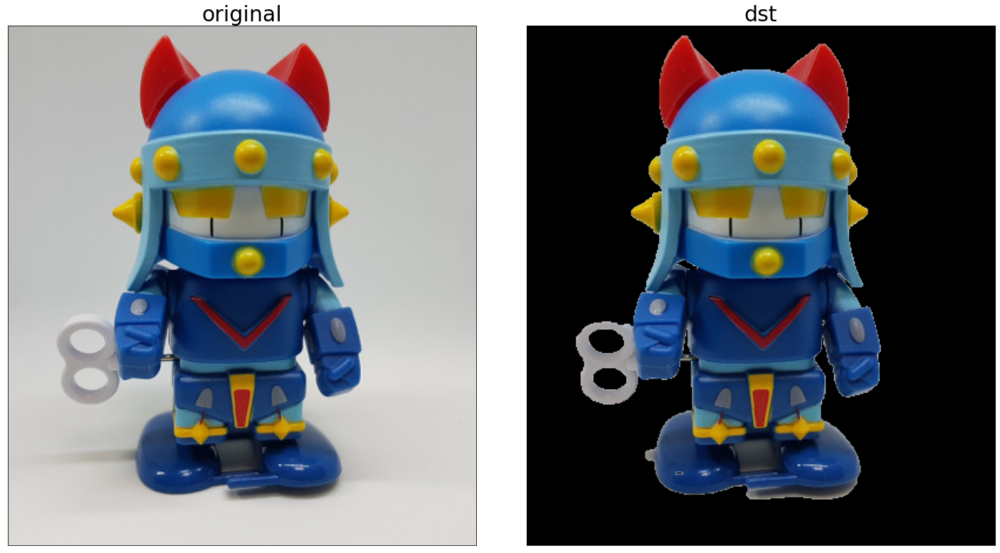

In [72]:
# 입력 영상 불러오기
src = cv2.imread('./taekwonv1.jpg')
    
# 사장형 지정을 통한 초기 분할
rc = cv2.selectROI(src) # 초기 위치 지정하고 모서리 좌표 4개를 튜플값으로 반환
mask = np.zeros(src.shape[:2], np.uint8) # 마스크는 검정색으로 채워져있고 입력 영상과 동일한 크기

# 결과를 계속 업데이트 하고 싶으면 bgd, fgd 입력
cv2.grabCut(src, mask, rc, None, None, 5, cv2.GC_INIT_WITH_RECT)

# grabCut 자료에서 0,2는 배경, 1,3은 전경입니다.
# mask == 0 or mask == 2를 만족하면 0으로 설정 아니면 1로 설정합니다
mask2 = np.where((mask == 0) | (mask == 2), 0, 1).astype('uint8')

# np.newaxis로 차원 확장
dst = src * mask2[:, :, np.newaxis]

cv2.imshow('dst', dst)
cv2.waitKey()
cv2.destroyAllWindows()

imgs = {'original' : src, 'dst' : dst}

fig, axes = plt.subplots(1,2,figsize=(20, 20))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i,fontsize=30)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

### 평균 이동 필터

- 평균 이동 필터를 활용하면 물감으로 그림을 그린 것과 같이 이미지를 바꿀 수 있음

```python
dst = cv2.pyrMeanShiftFiltering(src, sp, sr, dst, maxLevel, termcrit)
```
        src: 입력 이미지
        sp: 공간 윈도 반지름 크기
        sr: 색상 윈도 반지름 크기
        maxLevel(optional): 이미지 피라미드 최대 레벨
        termcrit(optional): 반복 중지 요건 (cv2.TERM_CRITERIA_EPS: 정확도가 최소 정확도(epsilon) 보다 작아지면 중지, cv2.TERM_CRITERIA_MAX_ITER: 최대 반복 횟수(max_iter)에 도달하면 중지) -> default epsilon=1, max_iter=5
        
        
- 이 함수는 내부적으로 이미지 피라미드를 만들어 작은 이미지의 평균 이동 결과를 큰 이미지에 적용

### 평균 이동 세그멘테이션 필터

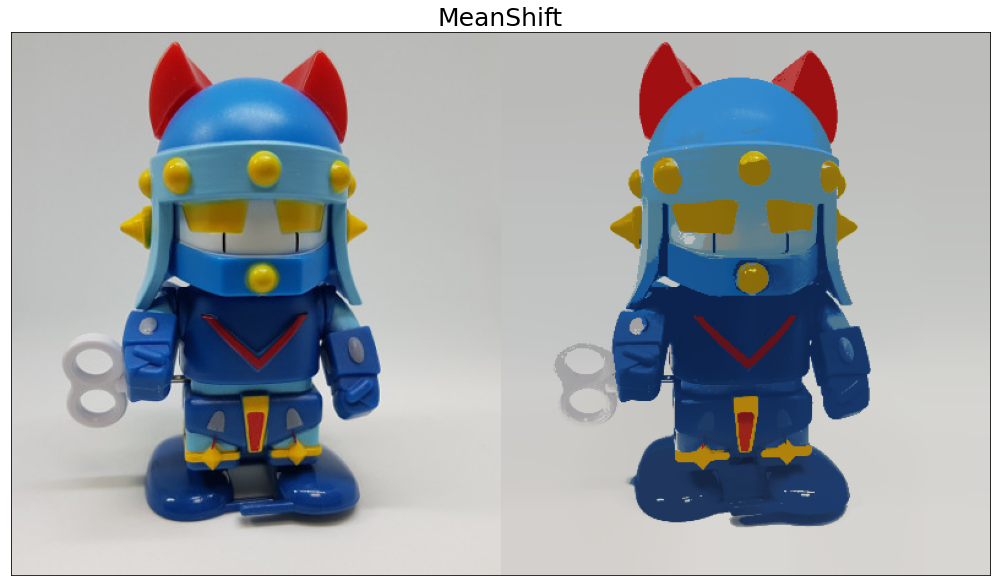

In [77]:
img = cv2.imread('./taekwonv1.jpg')

# 평균 이동 필터 적용 
mean = cv2.pyrMeanShiftFiltering(img, 50, 50, None, 0)
merge = np.hstack((img, mean))

plt.figure(figsize=(20, 10))
plt.title('MeanShift',fontsize=25)
plt.imshow(merge[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

## 21. 이미지 매칭 (평균 해시 매칭, 템플릿 매칭)

### 이미지 매칭(Image Matching)

- 이미지 매칭이란 서로 다른 두 이미지를 비교해서 짝이 맞는 같은 형태의 객체가 있는지 찾아내는 기술
- 이미지에서 객체를 찾는 방법은 이미지에서 의미 있는 특징들을 적절한 숫자로 변환하고 그 숫자들을 서로 비교해서 얼마나 비슷한지 판단하는 것
    - 두 이미지 간 유사도를 측정하는 작업
- 특징을 대표할 수 있는 숫자를 특징 벡터 혹은 특징 디스크립터라고 함

### 평균 해시 매칭(Average Hash Matching)

- 평균 해시 매칭은 이미지 매칭의 한 기법
- 특징 벡터를 구하기 위해 평균값을 사용
    - 특징 벡터 구하는 방법
        1. 이미지를 가로 세로 비율과 무관하게 특정한 크기로 축소
        2. 픽셀 전체의 평균값을 구해서 각 픽셀의 값이 평균보다 작으면 0, 크면 1로 바꿈
        3. 0 또는 1로만 구성된 각 픽셀 값을 1행 1열로 변환
            - 비교를 하고자 하는 두 이미지를 같은 크기로 축소, 같은 크기라서 0,1 개수 동일

### 권총을 평균 해시로 변환

[[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
 [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 1 0 0 1 1 1 1 1 1]
 [1 1 0 0 0 0 0 1 1 1 1 1 1 1 1 1]
 [1 1 0 0 0 0 0 1 1 1 1 1 1 1 1 1]
 [1 1 0 0 0 0 0 0 0 1 1 1 1 1 1 1]
 [1 1 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
 [1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1]
 [1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1]
 [1 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1]
 [1 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1]
 [1 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1]
 [1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1]]
ffff8000800080008000813fc1ffc1ffc07fc3ffc7ffc7ff87ff87ff87ffc7ff


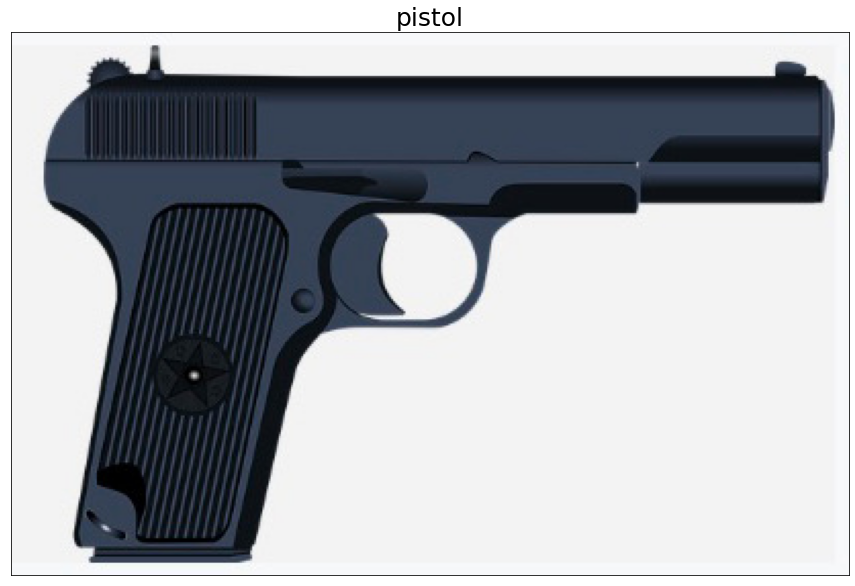

In [8]:
#영상 읽어서 그레이 스케일로 변환
img = cv2.imread('./pistol.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# 8x8 크기로 축소 ---①
gray = cv2.resize(gray, (16,16))

# 영상의 평균값 구하기 ---②
avg = gray.mean()

# 평균값을 기준으로 0과 1로 변환 ---③
bin = 1 * (gray > avg)
print(bin)

# 2진수 문자열을 16진수 문자열로 변환 ---④
dhash = []
for row in bin.tolist():
    s = ''.join([str(i) for i in row])
    dhash.append('%02x'%(int(s,2)))
dhash = ''.join(dhash)
print(dhash)

plt.figure(figsize=(20, 10))
plt.title('pistol',fontsize=25)
plt.imshow(img[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 이미지를 16 x 16 사이즈로 조정
- 픽셀의 전체 평균값을 구하고 그 평균값보다 큰 픽셀은 1, 작은 픽셀은 0 으로 변경, 0으로 구성된 부분이 권총 모양을 닮음
    - 전체 픽셀의 평균값보다 작은 부분은 0, 큰 부분은 1로 변경, 검은색이므로 픽셀 값이 0 흰색은 1
- 비슷한 정도를 측정하는 방법 : 유클리드 거리, 해밍 거리
    - 유클리드 거리는 두 값의 차이로 거리를 계산
    - 해밍 거리는 두 값의 길이가 같아야 계산, 두 수의 같은 자리 값 중 서로 다른 것이 몇 개인지를 판단하여 유사도를 계산
- 여기서는 해밍 거리 이용
    - 유클리드 거리는 자릿수가 높을수록 차이가 크게 벌어지지만 해밍 거리는 몇 개의 숫자가 다른가만을 고려하기 때문에

### 사물 이미지 중에서 권총 이미지 찾기

./101_ObjectCategories\BACKGROUND_Google\image_0398.jpg 0.234375
./101_ObjectCategories\binocular\image_0011.jpg 0.23828125
./101_ObjectCategories\Faces_easy\image_0419.jpg 0.2421875
./101_ObjectCategories\revolver\image_0001.jpg 0.2421875
./101_ObjectCategories\revolver\image_0015.jpg 0.24609375
./101_ObjectCategories\revolver\image_0017.jpg 0.23828125
./101_ObjectCategories\revolver\image_0018.jpg 0.1953125
./101_ObjectCategories\revolver\image_0019.jpg 0.23828125
./101_ObjectCategories\revolver\image_0021.jpg 0.171875
./101_ObjectCategories\revolver\image_0022.jpg 0.21484375
./101_ObjectCategories\revolver\image_0023.jpg 0.21875
./101_ObjectCategories\revolver\image_0031.jpg 0.21875
./101_ObjectCategories\revolver\image_0033.jpg 0.2421875
./101_ObjectCategories\revolver\image_0034.jpg 0.23046875
./101_ObjectCategories\revolver\image_0037.jpg 0.2421875
./101_ObjectCategories\revolver\image_0064.jpg 0.18359375
./101_ObjectCategories\revolver\image_0068.jpg 0.24609375
./101_ObjectCateg

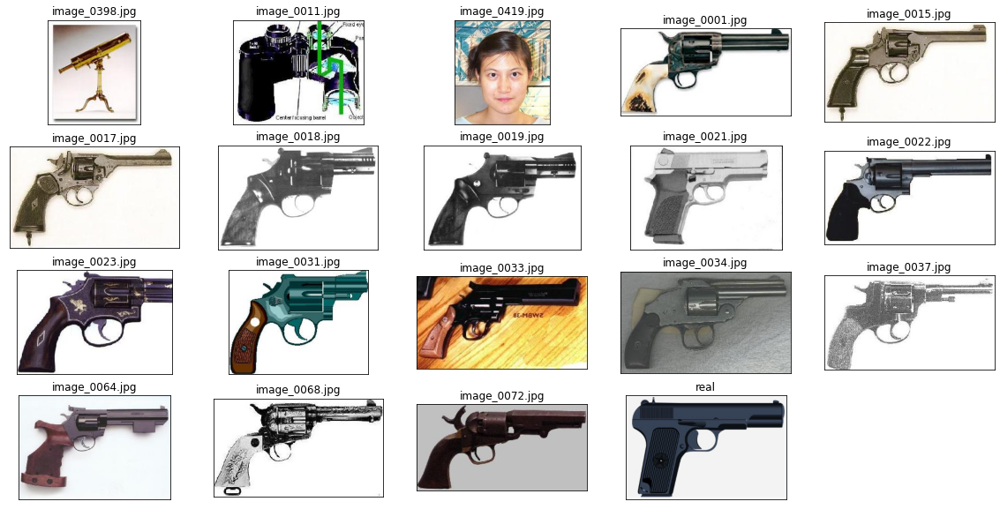

In [18]:
# 영상 읽기 및 표시
img = cv2.imread('./pistol.jpg')
real_img = img.copy()
# cv2.imshow('query', img)

# 비교할 영상들이 있는 경로 ---①
search_dir = './101_ObjectCategories'

# 이미지를 16x16 크기의 평균 해쉬로 변환 ---②
def img2hash(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.resize(gray, (16, 16))
    avg = gray.mean()
    bi = 1 * (gray > avg)
    return bi

# 해밍거리 측정 함수 ---③
def hamming_distance(a, b):
    a = a.reshape(1,-1)
    b = b.reshape(1,-1)
    # 같은 자리의 값이 서로 다른 것들의 합
    distance = (a !=b).sum()
    return distance

# 권총 영상의 해쉬 구하기 ---④
query_hash = img2hash(img)

count =0
plt.figure(figsize=(20, 10))

# 이미지 데이타 셋 디렉토리의 모든 영상 파일 경로 ---⑤
img_path = glob.glob(search_dir+'/**/*.jpg')
for path in img_path:
   
    # 데이타 셋 영상 한개 읽어서 표시 ---⑥
    img = cv2.imread(path)
    
    # 데이타 셋 영상 한개의 해시  ---⑦
    a_hash = img2hash(img)
    
    # 해밍 거리 산출 ---⑧
    dst = hamming_distance(query_hash, a_hash)
    if dst/256 < 0.25: # 해밍거리 25% 이내만 출력 ---⑨
        print(path, dst/256)
        
        plt.subplot(4,5, count + 1)
        plt.imshow(img[:,:,::-1]) # BGR -> RGB
        plt.title(path.split('\\')[2])
        plt.xticks([])
        plt.yticks([])
        
        count += 1
        
plt.imshow(real_img[:,:,::-1]) # BGR -> RGB
plt.title('real')
plt.xticks([])
plt.yticks([])
plt.show()

- 대부분 권총과 유사한 사진들이 검출되지만 완벽하진 않음

### 템플릿 매칭 (Template Matching)

- 특정 물체에 대한 이미지를 준비해 두고 그 물체가 포함되어 있을 것이라고 예상할 수 있는 이미지와 비교하여 매칭 되는 위치를 찾는 것
    - 미리 준비한 이미지를 템플릿 이미지라고 함
    - 템플릿 이미지는 비교할 이미지보다 크기가 항상 작아야 함
    

```python
result = cv2.matchTemplate(img, templ, method, result, mask)
```
        img: 입력 이미지
        templ: 템플릿 이미지
        method: 매칭 메서드 (cv2.TM_SQDIFF: 제곱 차이 매칭, 완벽 매칭:0, 나쁜 매칭: 큰 값 / cv2.TM_SQDIFF_NORMED: 제곱 차이 매칭의 정규화 / cv2.TM_CCORR: 상관관계 매칭, 완벽 매칭: 큰 값, 나쁜 매칭: 0 / cv2.TM_CCORR_NORMED: 상관관계 매칭의 정규화 / cv2.TM_CCOEFF: 상관계수 매칭, 완벽 매칭:1, 나쁜 매칭: -1 / cv2.TM_CCOEFF_NORMED: 상관계수 매칭의 정규화)
        result(optional): 매칭 결과, (W - w + 1) x (H - h + 1) 크기의 2차원 배열 [여기서 W, H는 입력 이미지의 너비와 높이, w, h는 템플릿 이미지의 너비와 높이]
        mask(optional): TM_SQDIFF, TM_CCORR_NORMED인 경우 사용할 마스크
        
```python
minVal, maxVal, minLoc, maxLoc = cv2.minMaxLoc(src, mask)
```
        src: 입력 1 채널 배열
        minVal, maxVal: 배열 전체에서의 최소 값, 최대 값
        minLoc, maxLoc: 최소 값과 최대 값의 좌표 (x, y)
 

- cv2.matchTemplate() 함수는 입력 이미지(img)에서 템플릿 이미지(templ)를 슬라이딩하면서 주어진 메서드에 따라 매칭을 수행
- cv2.matchTemplate() 함수의 반환 값은 (W - w + 1) x (H - h + 1) 크기의 2차원 배열 (W, H는 입력 이미지의 너비와 높이, w, h는 템플릿 이미지의 너비와 높이)
- cv2.minMaxLoc()는  입력 배열에서의 최솟값, 최댓값뿐만 아니라 최솟값, 최댓값의 좌표도 반환

### 템플릿 매칭으로 객체 위치 검출

cv2.TM_CCOEFF_NORMED -0.1780252307653427 0.5131933093070984 (42, 0) (208, 43)
cv2.TM_CCORR_NORMED 0.827332615852356 0.9238022565841675 (85, 6) (208, 43)
cv2.TM_SQDIFF_NORMED 0.17028295993804932 0.36860838532447815 (208, 43) (86, 7)


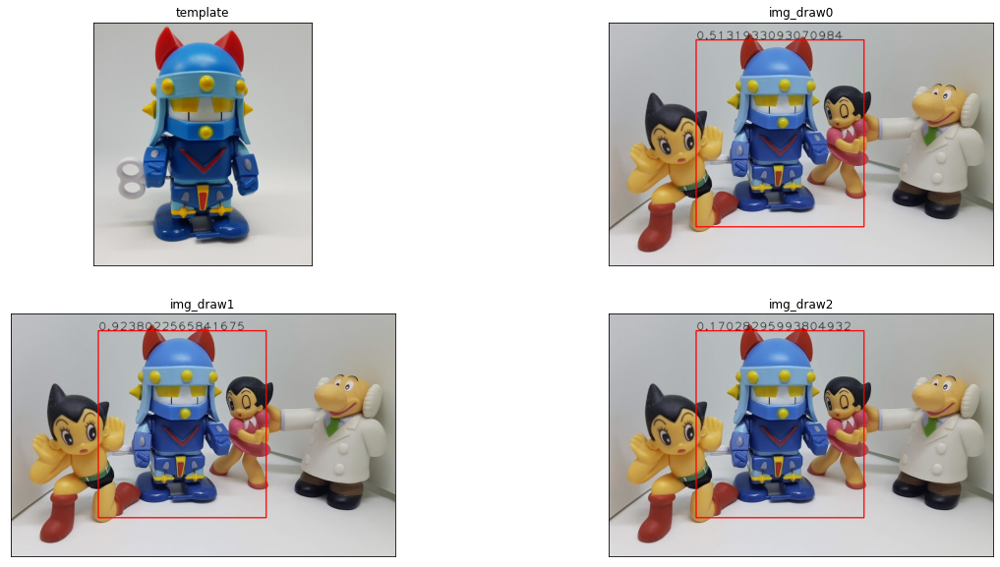

In [28]:
# 입력이미지와 템플릿 이미지 읽기
img = cv2.imread('./figures.jpg')
template = cv2.imread('./taekwonv1.jpg')
th, tw = template.shape[:2]

# 3가지 매칭 메서드 순회
methods = ['cv2.TM_CCOEFF_NORMED', 'cv2.TM_CCORR_NORMED', \
                                     'cv2.TM_SQDIFF_NORMED']
for i, method_name in enumerate(methods):
    img_draw = img.copy()
    method = eval(method_name)
    
    # 템플릿 매칭   ---①
    res = cv2.matchTemplate(img, template, method)
    
    # 최솟값, 최댓값과 그 좌표 구하기 ---②
    min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)
    print(method_name, min_val, max_val, min_loc, max_loc)

    # TM_SQDIFF의 경우 최솟값이 좋은 매칭, 나머지는 그 반대 ---③
    if method in [cv2.TM_SQDIFF, cv2.TM_SQDIFF_NORMED]:
        top_left = min_loc
        match_val = min_val
    else:
        top_left = max_loc
        match_val = max_val
        
    # 매칭 좌표 구해서 사각형 표시   ---④      
    bottom_right = (top_left[0] + tw, top_left[1] + th)
    cv2.rectangle(img_draw, top_left, bottom_right, (0,0,255),2)
    
    # 매칭 포인트 표시 ---⑤
    cv2.putText(img_draw, str(match_val), top_left, \
                cv2.FONT_HERSHEY_PLAIN, 2,(0,0,0), 1, cv2.LINE_AA)
    globals()[f'img_draw{i}'] = img_draw




imgs = {'template':template, 'img_draw0':img_draw0, 'img_draw1': img_draw1, 'img_draw2': img_draw2}
plt.figure(figsize=(20, 10))
# ---③ 이미지 출력
for i, (k, v) in enumerate(imgs.items()):
    plt.subplot(2,2, i + 1)
    plt.imshow(v[:,:,::-1]) # BGR -> RGB
    plt.title(k)
    plt.xticks([]); plt.yticks([])

plt.show()


- 3가지 매칭 메서드를 활용해서 템플릿 매칭 수행결과
- 템플릿 매칭은 크기, 방향, 회전 변환에는 잘 작동하지 않고, 속도가 느리다는 단점 가짐

## 22. 이미지의 특징점(Keypoints)과 특징점 검출기(Keypoints detector)

### 이미지 특징점

- 이미지에서 특징이 되는 부분을 의미
- 이미지끼리 서로 매칭이 되는지 확인을 할 때 각 이미지에서의 특징이 되는 부분끼리 비교 
- 이미지 매칭 시 사용하는 것이 바로 특징점
    - 보통 특징점이 되는 부분은 물체의 모서리나 코너임
    - 대부분의 특징점 검출을 코너 검출을 바탕으로 수행

### 해리스 코너 검출 (Harris Corner Detection)

- 우리가 어떤 물체를 볼 때 꼭짓점을 더 유심히 보는 경향이 존재,  물체를 인식할 때 물체의 코너 부분에 중점을 둠
- 이미지 상의 코너를 잘 찾아낸다면 물체를 보다 쉽게 인식 가능
- 이런 코너를 검출하기 위한 방법으로는 해리스 코너 검출(Harris corner detection)이 있음
    - 해리스 코너 검출은 소벨(Sobel) 미분으로 경곗값을 검출하면서 경곗값의 경사도 변화량을 측정하여 변화량이 수직, 수평, 대각선 방향으로 크게 변화하는 것을 코너로 판단

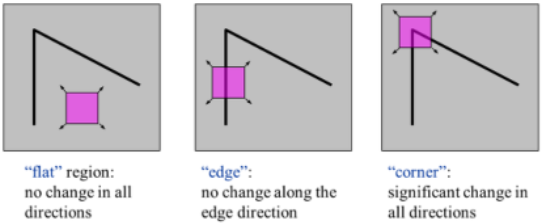

```python
dst = cv2.cornerHarris(src, blockSize, ksize, k, dst, borderType)
```
        src: 입력 이미지, 그레이 스케일
        blockSize: 이웃 픽셀 범위
        ksize: 소벨 미분 필터 크기
        k(optional): 코너 검출 상수 (보토 0.04~0.06)
        dst(optional): 코너 검출 결과 (src와 같은 크기의 1 채널 배열, 변화량의 값, 지역 최대 값이 코너점을 의미)
        borderType(optional): 외곽 영역 보정 형식

### 해리스 코너 검출

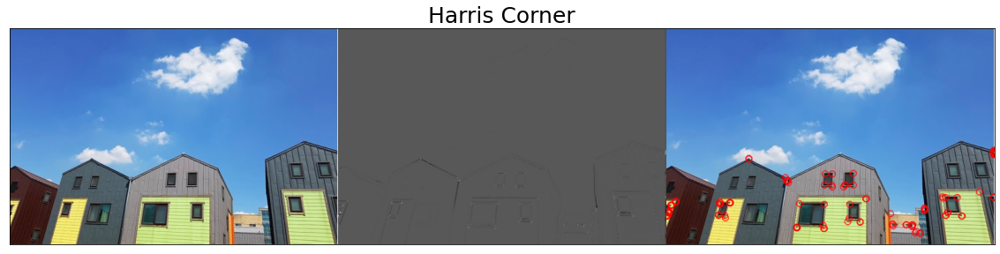

In [32]:
img = cv2.imread('./house.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
real_img = img.copy()

# 해리스 코너 검출 ---①
corner = cv2.cornerHarris(gray, 2, 3, 0.04)

# 변화량 결과의 최대값 10% 이상의 좌표 구하기 ---②
coord = np.where(corner > 0.1* corner.max())
coord = np.stack((coord[1], coord[0]), axis=-1)

# 코너 좌표에 동그리미 그리기 ---③
for x, y in coord:
    cv2.circle(img, (x,y), 5, (0,0,255), 1, cv2.LINE_AA)

# 변화량을 영상으로 표현하기 위해서 0~255로 정규화 ---④
corner_norm = cv2.normalize(corner, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)

# 화면에 출력
corner_norm = cv2.cvtColor(corner_norm, cv2.COLOR_GRAY2BGR)
merged = np.hstack((real_img,corner_norm, img))

plt.figure(figsize=(20, 10))
plt.title('Harris Corner',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 왼쪽 : 원본, 가운데 : 정규화 이미지, 오른쪽 코너검출


- 오른쪽 이미지는 해리스 코너 검출을 실행하여 그 결과의 최대 값의 10% 이상인 좌표에만 빨간색 동그라미 표시한 것
    - 빨간색 동그라미가 표시된 부분을 보면 거의 다 코너 부분
- cv2.cornerHarris() 함수의 변환 결과는 입력 이미지와 크기가 같은 1차원 배열,  이 결과 값의 지역 최대 값은 코너를 의미
- 가운데 이미지는 해리스 코너 검출 결과를 0~255로 정규화한 이미지, 오른쪽 이미지에서 빨간색 동그라미가 표시되어 있는 코너 부분이 왼쪽 이미지에서도 가장 짙게 표시

### 시-토마시 검출 (Shi & Tomasi Detection)

- 해리스 코너 검출을 좀 더 개선한 알고리즘

```python
corners = cv2.goodFeaturesToTrack(img, maxCorners, qualityLevel, minDistance, corners, mask, blockSize, useHarrisDetector, k)
```
        img: 입력 이미지
        maxCorners: 얻고 싶은 코너의 개수, 강한 것 순으로
        qualityLevel: 코너로 판단할 스레시홀드 값
        minDistance: 코너 간 최소 거리
        mask(optional): 검출에 제외할 마스크
        blockSize(optional)=3: 코너 주변 영역의 크기
        useHarrisDetector(optional)=False: 코너 검출 방법 선택 (True: 해리스 코너 검출 방법, False: 시와 토마시 코너 검출 방법)
        k(optional): 해리스 코너 검출 방법에 사용할 k 계수
        corners: 코너 검출 좌표 결과, N x 1 x 2 크기의 배열, 실수 값이므로 정수로 변형 필요

### 시와 토마시 코너 검출

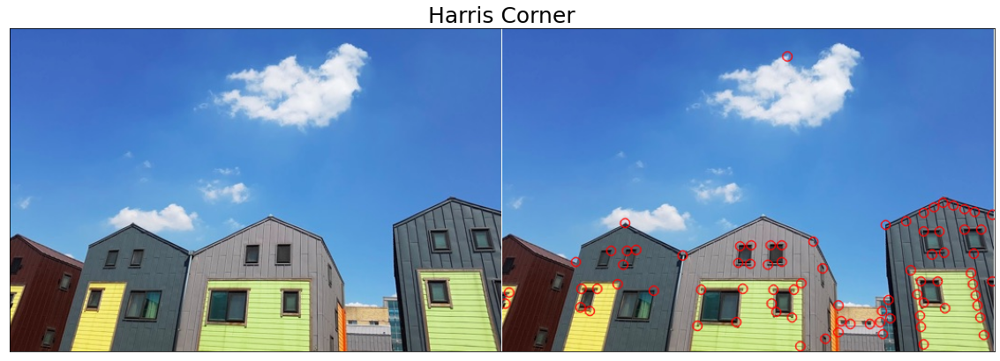

In [41]:
img = cv2.imread('./house.jpg')
real_img = img.copy()
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# 시-토마스의 코너 검출 메서드
corners = cv2.goodFeaturesToTrack(gray, 80, 0.01, 10)

# 실수 좌표를 정수 좌표로 변환
corners = np.int32(corners)

# 좌표에 동그라미 표시
for corner in corners:
    x, y = corner[0]
    cv2.circle(img, (x, y), 5, (0,0,255), 1, cv2.LINE_AA)
    
merged = np.hstack((real_img, img))

plt.figure(figsize=(20, 10))
plt.title('Harris Corner',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 해리스 코너 검출보다 더 많은 코너가 검출

### 다양한 특징점 검출기

- 해리스 코너 검출과 시-토마시 검출의 함수 반환 결과는 특징점의 좌표
- 특징점의 좌표뿐만 아니라 다양한 정보들도 함께 반환하는 함수들 존재

```python
keypoints = detector.detect(img, mask): 특징점 검출 함수
```
        img: 입력 이미지
        mask(optional): 검출 제외 마스크
        keypoints: 특징점 검출 결과 (KeyPoint의 리스트)

```python
Keypoint: 특징점 정보를 담는 객체
```
        pt: 특징점 좌표(x, y), float 타입으로 정수 변환 필요
        size: 의미 있는 특징점 이웃의 반지름
        angle: 특징점 방향 (시계방향, -1=의미 없음)
        response: 특징점 반응 강도 (추출기에 따라 다름)
        octave: 발견된 이미지 피라미드 계층
        class_id: 특징점이 속한 객체 ID
        
- 특징점을 표시해주는 전용 함수

```python
outImg = cv2.drawKeypoints(img, keypoints, outImg, color, flags)
```
        img: 입력 이미지
        keypoints: 표시할 특징점 리스트
        outImg: 특징점이 그려진 결과 이미지
        color(optional): 표시할 색상 (default: 랜덤)
        flags(optional): 표시 방법 (cv2.DRAW_MATCHES_FLAGS_DEFAULT: 좌표 중심에 동그라미만 그림(default), cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS: 동그라미의 크기를 size와 angle을 반영해서 그림)

### GFTTDetector

- cv2.goodFeaturesToTrack() 함수로 구현된 특징점 검출기
- GFTTDetector 검출기를 활용하여 특징점을 검출하는데 사용하는 함수는 detector.detect()와 동일

```python
detector = cv2.GFTTDetector_create(img, maxCorners, qualityLevel, minDistance, corners, mask, blockSize, useHarrisDetector, k)
```
        모든 파라미터는 cv2.goodFeaturesToTrack()과 동일
        검출 결과는 특징점 좌표만 존재

### GFTTDetector로 특징점 검출

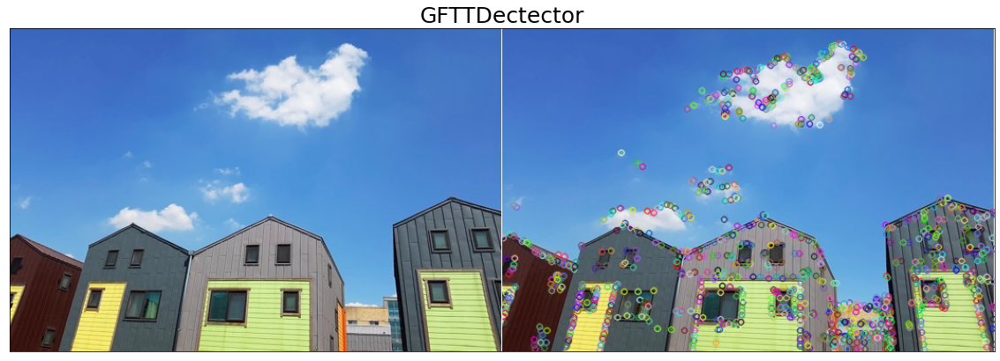

In [45]:
img = cv2.imread("./house.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Good feature to trac 검출기 생성 ---①
gftt = cv2.GFTTDetector_create() 

# 특징점 검출 ---②
keypoints = gftt.detect(gray, None)

# 특징점 그리기 ---③
img_draw = cv2.drawKeypoints(img, keypoints, None)

# 결과 출력 ---④
merged = np.hstack((img, img_draw))

plt.figure(figsize=(20, 10))
plt.title('GFTTDectector',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 해리스 코너 검출, 시와 토마시 코너 검출보다 더 많은 검출
- cv2.drawKeypoints() 함수에서 color 속성을 지정하지 않으면 랜덤한 색상

### FAST(Feature from Accelerated Segment Test)

- FAST는 기존 검출기보다 속도가 빠른 검출기
- FAST 검출기는 코너를 검출할 때 미분 연산을 하지 않음, 대신 픽셀을 중심으로 특정 개수의 픽셀로 원을 그려서 그 안의 픽셀들이 중심 픽셀 값보다 임계 값 이상 밝거나 어두운 것이 일정 개수 이상 연속되면 코너로 판단
    - 어떤 점 p가 특징점인지 여부를 판단할 때, p를 중심으로 하는 원 상이 16개 픽셀 값을 확인, p보다 임계 값 이상 밝은 픽셀들이 n개 이상 연속되어 있거나 또는 임계 값 이상 어두운 픽셀들이 n개 이상 연속되어 있으면 p를 특징점이라고 판단
    
    
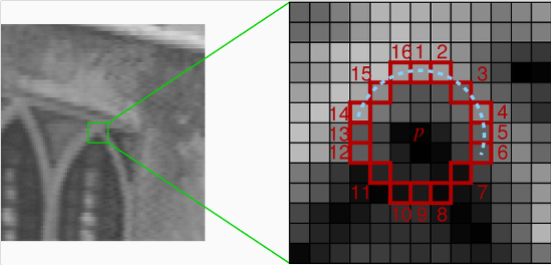

```python
detector = cv2.FastFeatureDetector_create(threshold, nonmaxSuppression, type)
```
        threshold(optional): 코너 판단 임계 값 (default=10)
        nonmaxSuppression(optional): 최대 점수가 아닌 코너 억제 (default=True)
        type(optional): 엣지 검출 패턴 (cv2.FastFeatureDetector_TYPE_9_16: 16개 중 9개 연속(default), cv2.FastFeatureDetector_TYPE_7_12: 12개 중 7개 연속, cv2.FastFeatureDetector_TYPE_5_8: 8개 중 5개 연속)


### FAST로 특징점 검출

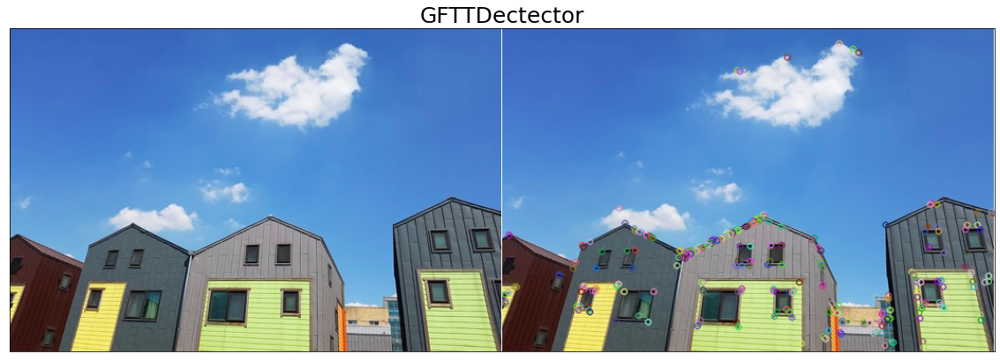

In [48]:
img = cv2.imread('./house.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
real_img = img.copy()

# FASt 특징 검출기 생성 ---①
fast = cv2.FastFeatureDetector_create(50)

# 특징점 검출 ---②
keypoints = fast.detect(gray, None)

# 특징점 그리기 ---③
img = cv2.drawKeypoints(img, keypoints, None)

# 결과 출력 ---④
merged = np.hstack((real_img, img))
plt.figure(figsize=(20, 10))
plt.title('GFTTDectector',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

### SimpleBlobDetector

- BLOB(Binary Large Object)는 이진 스케일로 연결된 픽셀 그룹을 의미
- SimpleBlobDetector는 자잘한 객체는 노이즈로 여기고 특정 크기 이상의 큰 객체만 찾아내는 검출기

```python
detector = cv2.SimpleBlobDetector_create([parameters]): BLOB 검출기 생성자
```
        - parameters 설명
        
        minThreshold, maxThreshold, thresholdStep: BLOB를 생성하기 위한 경계 값
        (minThreshold에서 maxThreshold를 넘지 않을 때까지 thresholdStep만큼 증가)
        minRepeatability: BLOB에 참여하기 위한 연속된 경계 값의 개수
        minDistBetweenBlobs: 두 BLOB을 하나의 BLOB으로 간주하는 거리
        filterByArea: 면적 필터 옵션
        minArea, maxArea: min~max 범위의 면적만 BLOB으로 검출
        filterByCircularity: 원형 비율 필터 옵션
        minCircularity, maxCircularity: min~max 범위의 원형 비율만 BLOB으로 검출
        filterByColor: 밝기를 이용한 필터 옵션
        blobColor: 0 = 검은색 BLOB 검출, 255 = 흰색 BLOB 검출
        filterByConvexity: 볼록 비율 필터 옵션
        minConvexity, maxConvexity: min~max 범위의 볼록 비율만 BLOB으로 검출
        filterByInertia: 관성 비율 필터 옵션
        minInertiaRatio, maxInertiaRatio: min~max 범위의 관성 비율만 BLOB으로 검출

### SimpleBolbDetector 검출기

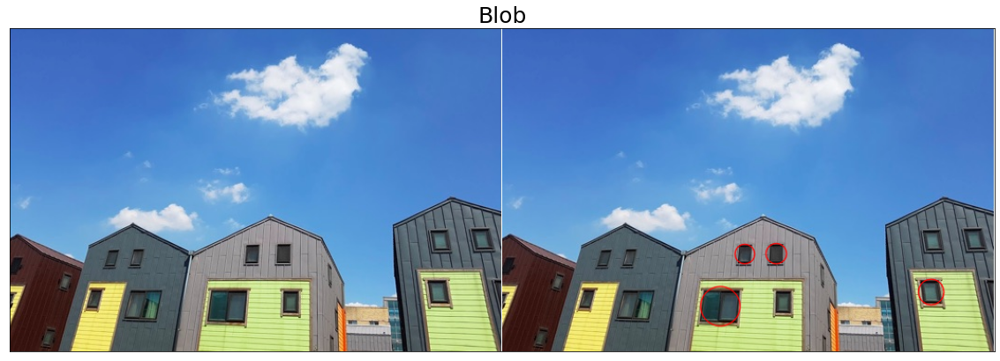

In [53]:
img = cv2.imread("./house.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
real_img = img.copy()

# SimpleBlobDetector 생성 ---①
detector = cv2.SimpleBlobDetector_create()

# 키 포인트 검출 ---②
keypoints = detector.detect(gray)

# 키 포인트를 빨간색으로 표시 ---③
img = cv2.drawKeypoints(img, keypoints, None, (0,0,255),\
                flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

merged = np.hstack((real_img, img))
plt.figure(figsize=(20, 10))
plt.title('Blob',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- SimpleBlobDetector는 자잘한 코너는 노이즈로 간주하고 특정 크기 이상의 객체만 검출

### 필터 옵션으로 생성한 SimpleBlobDetector 검출기

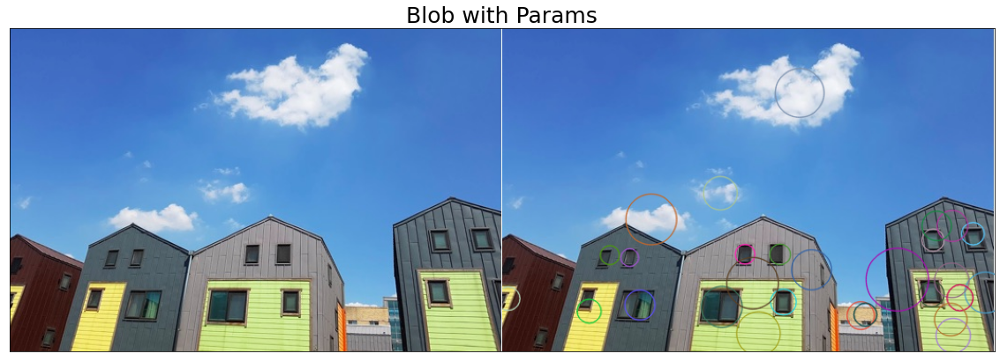

In [57]:
img = cv2.imread("./house.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
real_img = img.copy()

# blob 검출 필터 파라미터 생성 ---①
params = cv2.SimpleBlobDetector_Params()

# 경계값 조정 ---②
params.minThreshold = 10
params.maxThreshold = 240
params.thresholdStep = 5

# 면적 필터 켜고 최소 값 지정 ---③
params.filterByArea = True
params.minArea = 200
  
# 컬러, 볼록 비율, 원형비율 필터 옵션 끄기 ---④
params.filterByColor = False
params.filterByConvexity = False
params.filterByInertia = False
params.filterByCircularity = False 

# 필터 파라미터로 blob 검출기 생성 ---⑤
detector = cv2.SimpleBlobDetector_create(params)

# 키 포인트 검출 ---⑥
keypoints = detector.detect(gray)

# 키 포인트 그리기 ---⑦
img_draw = cv2.drawKeypoints(img, keypoints, None, None,\
                     cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
# 결과 출력 ---⑧
merged = np.hstack((real_img, img_draw))
plt.figure(figsize=(20, 10))
plt.title('Blob with Params',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

## 23. 특징 디스크립터 검출기 (SIFT, ORB)

### 특징 디스크립터

- 특징 디스크립터란 특징점 주변 픽셀을 일정한 크기의 블록으로 나누어 각 블록에 속한 픽셀의 그레디언트 히스토그램을 계산한 것
- 주로 특징점 주변의 밝기, 색상, 방향, 크기 등의 정보가 포함되어 있음
- 특징점 주변의 블록 크기에 8방향(상, 하, 좌, 우 및 네 방향의 대각선) 경사도를 표현, 4 x 4 크기의 블록인 경우 한 개의 특징점당 4 x 4 x 8 = 128개의 값을 가짐

```python
keypoints, descriptors = detector.compute(image, keypoins, descriptors): 특징점을 전달하면 특징 디스크립터를 계산해서 반환
keypoints, descriptors = detector.detectAndCompute(image, mask, decriptors, useProvidedKeypoints): 특징점 검출과 특징 디스크립터 계산을 한 번에 수행
```
        image: 입력 이미지
        keypoints: 디스크립터 계산을 위해 사용할 특징점
        descriptors(optional): 계산된 디스크립터
        mask(optional): 특징점 검출에 사용할 마스크
        useProvidedKeypoints(optional): True인 경우 특징점 검출을 수행하지 않음
        
        
- 이전의 특징점 검출기는 detector.compute() 함수를 통해 특징 디스크립터를 구할 수 있음, detector.compute() 함수의 keypoints 파라미터에 특징점을 전달
- detector.detectAndCompute() 함수는 특징점과 특징 디스크립터를 동시에 계산

### SIFT (Scale-Invariant Feature Transform)

- 해리스 코너 검출 알고리즘은 크기 변화에 민감한 문제를 가짐
- SIFT는 이미지 피라미드를 이용해서 크기 변화에 따른 특징점 검출 문제를 해결한 알고리즘

```python
detector = cv2.xfeatures2d.SIFT_create(nfeatures, nOctaveLayers, contrastThreshold, edgeThreshold, sigma)
```
        nfeatures: 검출 최대 특징 수
        nOctaveLayers: 이미지 피라미드에 사용할 계층 수
        contrastThreshold: 필터링할 빈약한 특징 문턱 값
        edgeThreshold: 필터링할 엣지 문턱 값
        sigma: 이미지 피라미드 0 계층에서 사용할 가우시안 필터의 시그마 값

### SIFT로 특징점 및 디스크립터 추출

keypoint: 413 descriptor: (413, 128)
[[  1.   1.   1. ...   0.   0.   1.]
 [  8.  24.   0. ...   1.   0.   4.]
 [  0.   0.   0. ...   0.   0.   2.]
 ...
 [  1.   8.  71. ...  73. 127.   3.]
 [ 35.   2.   7. ...   0.   0.   9.]
 [ 36.  34.   3. ...   0.   0.   1.]]


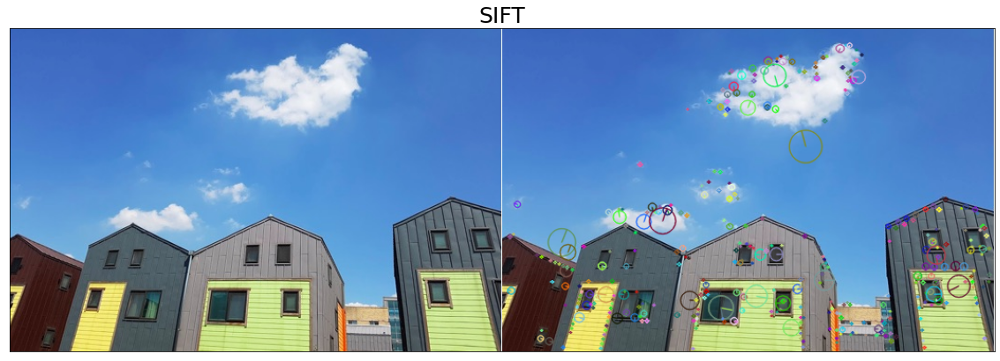

In [66]:
img = cv2.imread('./house.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# SIFT 추출기 생성
sift = cv2.SIFT_create()

# 키 포인트 검출과 서술자 계산
keypoints, descriptor = sift.detectAndCompute(gray, None)
print('keypoint:', len(keypoints), 'descriptor:', descriptor.shape)
print(descriptor)

# 키 포인트 그리기
img_draw = cv2.drawKeypoints(img, keypoints, None, \
                flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
# 결과 출력
merged = np.hstack((img, img_draw))

plt.figure(figsize=(20, 10))
plt.title('SIFT',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

- 특징점이 총 413, 특징점 1개 당 128개의 특징 디스크립터 값을 사용하는 것

### ORB (Oriented and Rotated BRIEF)

- 디스크립터 검출기 중 BRIEF(Binary Robust Independent Elementary Features) 존재
    - BRIEF는 특징점 검출은 지원하지 않는 디스크립터 추출기
    - BRIEF에 방향과 회전을 고려하도록 개선한 알고리즘이 바로 ORB
    - BRIEF 특징점 검출 알고리즘으로 FAST를 사용하고 회전과 방향을 고려하도록 개선했으며 속도도 빨라 SIFT와 SURF의 좋은 대안으로 사용

```python
detector = cv2.ORB_create(nfeatures, scaleFactor, nlevels, edgeThreshold, firstLevel, WTA_K, scoreType, patchSize, fastThreshold)
```
        nfeatures(optional): 검출할 최대 특징 수 (default=500)
        scaleFactor(optional): 이미지 피라미드 비율 (default=1.2)
        nlevels(optional): 이미지 피라미드 계층 수 (default=8)
        edgeThreshold(optional): 검색에서 제외할 테두리 크기, patchSize와 맞출 것 (default=31)
        firstLevel(optional): 최초 이미지 피라미드 계층 단계 (default=0)
        WTA_K(optional): 임의 좌표 생성 수 (default=2)
        scoreType(optional): 특징점 검출에 사용할 방식 (cv2.ORB_HARRIS_SCORE: 해리스 코너 검출(default), cv2.ORB_FAST_SCORE: FAST 코너 검출)
        patchSize(optional): 디스크립터의 패치 크기 (default=31)
        fastThreshold(optional): FAST에 사용할 임계 값 (default=20)

### ORB로 특징점 및 특징 디스크립터 검출

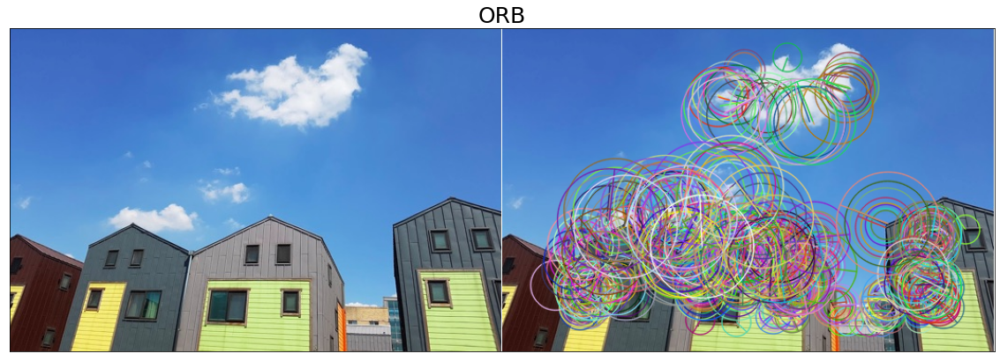

In [75]:
img = cv2.imread('./house.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# ORB 추출기 생성
orb = cv2.ORB_create()

# 키 포인트 검출과 서술자 계산
keypoints, descriptor = orb.detectAndCompute(img, None)

# 키 포인트 그리기
img_draw = cv2.drawKeypoints(img, keypoints, None, \
             flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
# 결과 출력
merged = np.hstack((img, img_draw))

plt.figure(figsize=(20, 10))
plt.title('ORB',fontsize=25)
plt.imshow(merged[:,:,::-1])
plt.xticks([])
plt.yticks([])
plt.show()

## 24. 특징 매칭(Feature Matching)

### 특징 매칭(Feature Matching)

- 서로 다른 두 이미지에서 특징점과 특징 디스크립터들을 비교해서 비슷한 객체끼리 짝짓는 것

```python
matcher = cv2.DescriptorMatcher_create(matcherType): 매칭기 생성자
```
        matcherType: 생성할 구현 클래스의 알고리즘 ("BruteForce": NORM_L2를 사용하는 BFMatcher, "BruteForce-L1": NORM_L1을 사용하는 BFMatcher, "BruteForce-Hamming": NORM_HAMMING을 사용하는 BRMatcher, "BruteForce-Hamming(2)": NORM_HAMMING2를 사용하는 BFMatcher, "FlannBased": NORM_L2를 사용하는 FlannBasedMatcher)

- openCV 제공하는 특징 매칭기는 BFMatcher와 FLannBasedMatcher, 객체를 생성하기 위해 해당 클래스의 생성자를 호출해도 되지만 cv2.DescriptorMatcher_create()의 파라미터로 구현할 클래스의 알고리즘을 문자열로 전달해도 사용가능

- cv2.DescriptorMatcher_create() 함수를 통해 생성된 특징 매칭기는 두 개의 디스크립터를 서로 비교하여 매칭 해주는 함수
- match(), knnMatch(), radiusMatch() 모두 첫 번째 파라미터인 queryDescriptors를 기준으로 두 번째 파라미터인 trainDescriptors에 맞는 매칭 찾음

```python
matches: matcher.match(queryDescriptors, trainDescriptors, mask): 1개의 최적 매칭
```
        queryDescriptors: 특징 디스크립터 배열, 매칭의 기준이 될 디스크립터
        trainDescriptors: 특징 디스크립터 배열, 매칭의 대상이 될 디스크립터
        mask(optional): 매칭 진행 여부 마스크
        matches: 매칭 결과, DMatch 객체의 리스트
        
```python
matches = matcher.knnMatch(queryDescriptors, trainDescriptors, k, mask, compactResult): k개의 가장 근접한 매칭
```
        k: 매칭할 근접 이웃 개수
        compactResult(optional): True: 매칭이 없는 경우 매칭 결과에 불포함 (default=False)
        
```python
matches = matcher.radiusMatch(queryDescriptors, trainDescriptors, maxDistance, mask, compactResult): maxDistance 이내의 거리 매칭
```
        maxDistance: 매칭 대상 거리
        

- knnMatch() 함수는 queryDescriptors 한 개당 k개의 최근접 이웃 개수만큼 trainDescriptors에서 찾아 반환, k는 knnMat의 세 번째 파라미터
    - k개의 최근접 이웃 개수만큼이라는 말은 가장 비슷한 k개만큼의 매칭 값을 반환한다는 뜻
    -  CompactResult에 default값이 False가 전달되면 매칭 결과를 찾지 못해도 결과에 queryDescriptors의 ID를 보관하는 행을 추가, True는 추가없음


- radiusMatch() 함수는 queryDescriptors에서 maxDistance 이내에 있는 trainDescriptors를 찾아 반환
-  match(), knnMatch(), radiusMatch() 반환결과

```python 
DMatch: 매칭 결과를 표현하는 객체 
```
    queryIdx: queryDescriptors의 인덱스
    trainIdx: trainDescriptors의 인덱스
    imgIdx: trainDescriptor의 이미지 인덱스
    distance: 유사도 거리

    - DMatch 객체의 queryIdx와 trainIdx로 두 이미지의 어느 지점이 서로 매칭 되었는지 알수 있음
    - distnace로 얼마나 가까운 거리 인지 파악 가능

- 매칭 결과를 시각적으로 표현하기 위해 두 이미지를 하나로 합쳐서 매칭점끼리 선으로 연결하는 함수

```python
cv2.drawMatches(img1, kp1, img2, kp2, matches, flags): 매칭점을 이미지에 표시
```
        img1, kp1: queryDescriptor의 이미지와 특징점
        img2, kp2: trainDescriptor의 이미지와 특징점
        matches: 매칭 결과
        flags: 매칭점 그리기 옵션 (cv2.DRAW_MATCHES_FLAGS_DEFAULT: 결과 이미지 새로 생성(default값), cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG: 결과 이미지 새로 생성 안 함, cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS: 특징점 크기와 방향도 그리기, cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS: 한쪽만 있는 매칭 결과 그리기 제외)

### BFMatcher(Brute-Force Matcher)

- Brute-Force 매칭기는 queryDescriptors와 trainDescriptors를 하나하나 확인해 매칭되는지 판단하는 알고리즘

```python
matcher = cv2.BFMatcher_create(normType, crossCheck)
```
        normType: 거리 측정 알고리즘 (cv2.NORM_L1, cv2.NORM_L2(default), cv2.NORM_L2SQR, cv2.NORM_HAMMING, cv2.NORM_HAMMING2)
        crosscheck: 상호 매칭이 되는 것만 반영 (default=False)
        
- 거리 측정 알고리즘을 전달하는 파라미터인 normType의 각각 계산식


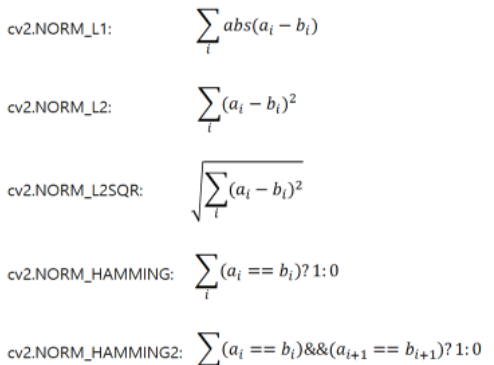

- 세 가지 유클리드 거리 측정법과 두 가지 해밍 거리 측정법 중에 선택
- SIFT와 SURF 디스크립터 검출기의 경우 NORM_L1, NORM_L2가 적합하고 ORB로 디스크립터 검출기의 경우 NORM_HAMMING이 적합하며, NORM_HAMMING2는 ORB의 WTA_K가 3 혹은 4일 때 적합
- crosscheck가 True이면 양쪽 디스크립터 모두에게서 매칭이 완성된 것만 반영하므로 불필요한 매칭을 줄일 수 있지만 그만큼 속도가 느려진다는 단점 존재

### BFMatcher와 SIFT로 매칭

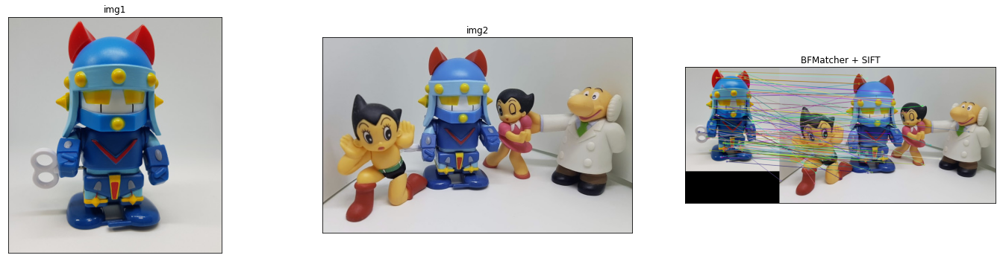

In [83]:
img1 = cv2.imread('./taekwonv1.jpg')
img2 = cv2.imread('./figures.jpg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# SIFT 서술자 추출기 생성 ---①
detector = cv2.SIFT_create()

# 각 영상에 대해 키 포인트와 서술자 추출 ---②
kp1, desc1 = detector.detectAndCompute(gray1, None)
kp2, desc2 = detector.detectAndCompute(gray2, None)

# BFMatcher 생성, L1 거리, 상호 체크 ---③
matcher = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

# 매칭 계산 ---④
matches = matcher.match(desc1, desc2)

# 매칭 결과 그리기 ---⑤
res = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, \
                      flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
# 결과 출력 
imgs = {'img1' : img1, 'img2' : img2, 'BFMatcher + SIFT' : res}

fig, axes = plt.subplots(1,3,figsize=(20, 5))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- SIFT 디스크립터 검출기를 생성
- 그런 다음 각 이미지에 대해 특징점과 디스크립터를 추출
-  BFMatcher 객체를 생성한 뒤 이를 활용하여 두 이미지의 디스크립터로 매칭 계산

### BFMatcher와 ORB로 매칭

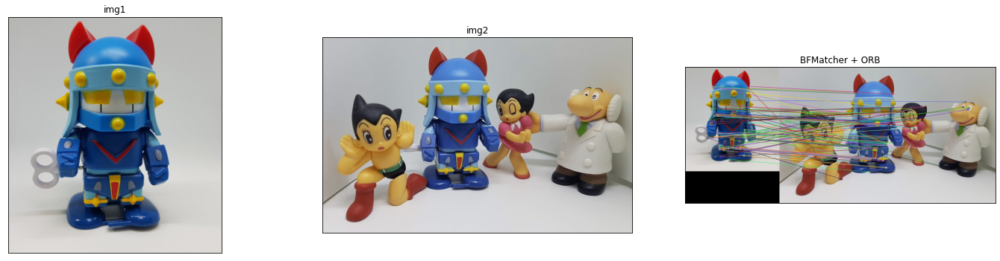

In [84]:
img1 = cv2.imread('./taekwonv1.jpg')
img2 = cv2.imread('./figures.jpg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# SIFT 서술자 추출기 생성 ---①
detector = cv2.ORB_create()

# 각 영상에 대해 키 포인트와 서술자 추출 ---②
kp1, desc1 = detector.detectAndCompute(gray1, None)
kp2, desc2 = detector.detectAndCompute(gray2, None)

# BFMatcher 생성, Hamming 거리, 상호 체크 ---③
matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# 매칭 계산 ---④
matches = matcher.match(desc1, desc2)

# 매칭 결과 그리기 ---⑤
res = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, \
                     flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

imgs = {'img1' : img1, 'img2' : img2, 'BFMatcher + ORB' : res}

fig, axes = plt.subplots(1,3,figsize=(20, 5))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

### FLANN(Fast Library for Approximate Nearest Neighbors Matching)

- BFMatcher는 모든 디스크립터를 전수 조사하므로 이미지 사이즈가 클 경우 속도가 느려짐
- FLANN은 모든 디스크립터를 전수 조사하기 보다 이웃하는 디스크립터끼리 비교, 이웃하는 디스크립터를 찾기 위해 FLANN 알고리즘 함수에 인덱스 파라미터와 검색 파라미터를 전달

```python
matcher = cv2.FlannBasedMatcher(indexParams, searchParams)
```

- 파라미터로 전달 받는 인덱스 파라미터와 검색 파라미터는 다음과 같은 값

```python
indexParams: 인덱스 파라미터 (딕셔너리)
```
        algorithm: 알고리즘 선택 키, 선택할 알고리즘에 따라 종속 키를 결정하면 됨
        FLANN_INDEX_LINEAR=0: 선형 인덱싱, BFMatcher와 동일
        FLANN_INDEX_KDTREE=1: KD-트리 인덱싱 (trees=4: 트리 개수(16을 권장))
        FLANN_INDEX_KMEANS=2: K-평균 트리 인덱싱 (branching=32: 트리 분기 개수, iterations=11: 반복 횟수, centers_init=0: 초기 중심점 방식)
        FLANN_INDEX_COMPOSITE=3: KD-트리, K-평균 혼합 인덱싱 (trees=4: 트리 개수, branching=32: 트리 분기 새수, iterations=11: 반복 횟수, centers_init=0: 초기 중심점 방식)
        FLANN_INDEX_LSH=6: LSH 인덱싱 (table_number: 해시 테이블 수, key_size: 키 비트 크기, multi_probe_level: 인접 버킷 검색)
        FLANN_INDEX_AUTOTUNED=255: 자동 인덱스 (target_precision=0.9: 검색 백분율, build_weight=0.01: 속도 우선순위, memory_weight=0.0: 메모리 우선순위, sample_fraction=0.1: 샘플 비율)
        
        
```python
searchParams: 검색 파라미터 (딕셔너리)
```
        checks=32: 검색할 후보 수
        eps=0.0: 사용 안 함
        sorted=True: 정렬해서 반환
        

- 설정할 파라미터가 많지만 대부분 알고리즘에 따라 밑과 같이 설정

- SIFT나 SURF를 사용하는 경우

```python
FLANN_INDEDX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
```
&nbsp;
- ORB를 사용하는 경우

```python
FLANN_INDEX_LSH = 6
index_params = dict(algorithm=FLANN_INDEX_LSH, table_number=6, key_size=12, multi_probe_level=1)
```

### FLANNMatcher와 SIFT로 매칭

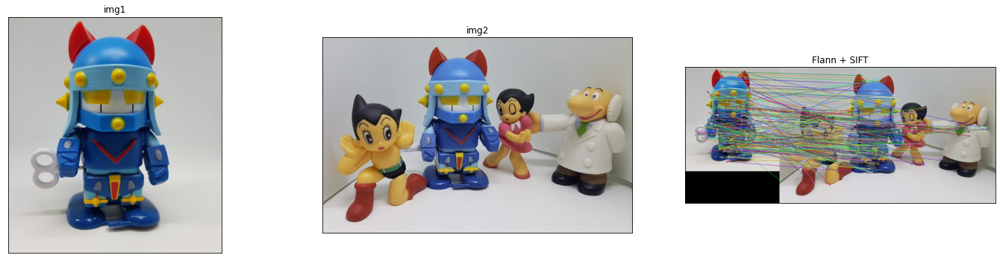

In [87]:
img1 = cv2.imread('./taekwonv1.jpg')
img2 = cv2.imread('./figures.jpg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# SIFT 생성
detector = cv2.SIFT_create()

# 키 포인트와 서술자 추출
kp1, desc1 = detector.detectAndCompute(gray1, None)
kp2, desc2 = detector.detectAndCompute(gray2, None)

# 인덱스 파라미터와 검색 파라미터 설정 ---①
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)

# Flann 매처 생성 ---③
matcher = cv2.FlannBasedMatcher(index_params, search_params)

# 매칭 계산 ---④
matches = matcher.match(desc1, desc2)

# 매칭 그리기
res = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, \
                flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

imgs = {'img1' : img1, 'img2' : img2, 'Flann + SIFT' : res}

fig, axes = plt.subplots(1,3,figsize=(20, 5))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

### FLANNMatcher와 ORB로 매칭

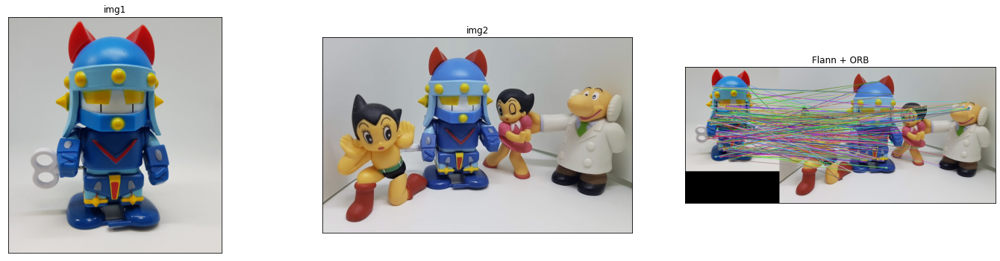

In [88]:
img1 = cv2.imread('./taekwonv1.jpg')
img2 = cv2.imread('./figures.jpg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# ORB 추출기 생성
detector = cv2.ORB_create()

# 키 포인트와 서술자 추출
kp1, desc1 = detector.detectAndCompute(gray1, None)
kp2, desc2 = detector.detectAndCompute(gray2, None)

# 인덱스 파라미터 설정 ---①
FLANN_INDEX_LSH = 6
index_params= dict(algorithm = FLANN_INDEX_LSH,
                   table_number = 6,
                   key_size = 12,
                   multi_probe_level = 1)

# 검색 파라미터 설정 ---②
search_params=dict(checks=32)

# Flann 매처 생성 ---③
matcher = cv2.FlannBasedMatcher(index_params, search_params)

# 매칭 계산 ---④
matches = matcher.match(desc1, desc2)

# 매칭 그리기
res = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, \
            flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

# 결과 출력            
imgs = {'img1' : img1, 'img2' : img2, 'Flann + ORB' : res}

fig, axes = plt.subplots(1,3,figsize=(20, 5))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- 매칭결과가 잘못 되는 경우도 보임 이럴때는 올바른 매칭점을 찾는 작업을 추가해줘야함

## 25. 올바른 매칭점 찾기

### 올바른 매칭점 찾기

- 매칭 결과에서 쓸모없는 매칭점은 버리고 올바른 매칭점만 골라내는 작업이 필요
- 올바른 매칭점만 남겼는데 매칭점이 몇 개 없다면 두 이미지는 서로 연관관계가 없다고 판단해야함
- match() 함수는 모든 디스크립터를 하나하나 비교하여 매칭점을 찾습니다. 따라서 가장 작은 거리 값과 큰 거리 값의 상위 몇 퍼센트만 골라서 올바른 매칭점 찾음

### match 함수로부터 올바른 매칭점 찾기

matches:18/127, min:24.00, max:78.00, thresh:34.80


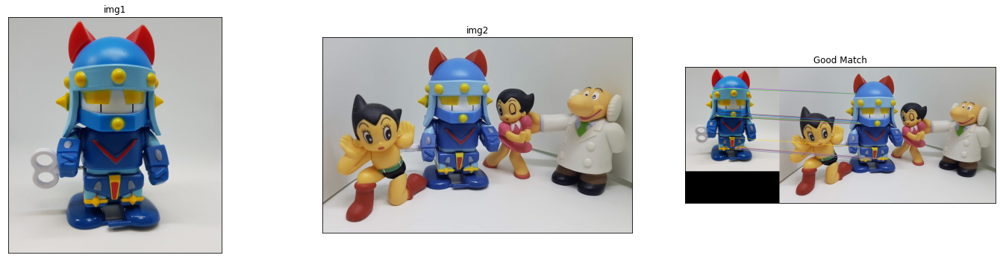

In [93]:
img1 = cv2.imread('./taekwonv1.jpg')
img2 = cv2.imread('./figures.jpg')

gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# ORB로 서술자 추출 ---①
detector = cv2.ORB_create()
kp1, desc1 = detector.detectAndCompute(gray1, None)
kp2, desc2 = detector.detectAndCompute(gray2, None)

# BF-Hamming으로 매칭 ---②
matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = matcher.match(desc1, desc2)

# 매칭 결과를 거리기준 오름차순으로 정렬 ---③
matches = sorted(matches, key=lambda x:x.distance)

# 최소 거리 값과 최대 거리 값 확보 ---④
min_dist, max_dist = matches[0].distance, matches[-1].distance

# 최소 거리의 20% 지점을 임계점으로 설정 ---⑤
ratio = 0.2
good_thresh = (max_dist - min_dist) * ratio + min_dist

# 임계점 보다 작은 매칭점만 좋은 매칭점으로 분류 ---⑥
good_matches = [m for m in matches if m.distance < good_thresh]
print('matches:%d/%d, min:%.2f, max:%.2f, thresh:%.2f' \
        %(len(good_matches),len(matches), min_dist, max_dist, good_thresh))


# 좋은 매칭점만 그리기 ---⑦
res = cv2.drawMatches(img1, kp1, img2, kp2, good_matches, None, \
                flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
# 결과 출력
imgs = {'img1' : img1, 'img2' : img2, 'Good Match' : res}

fig, axes = plt.subplots(1,3,figsize=(20, 5))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

- ORB로 디스크립터를 추출하고 BF-Hamming 매칭기로 매칭을 계산
- 매칭 결과의 거리(distance)를 기준으로 정렬하고 거리가 짧은 20%의 매칭점만 선택

### match 함수로부터 올바른 매칭점 찾

matches:18/127, min:24.00, max:78.00, thresh:34.80


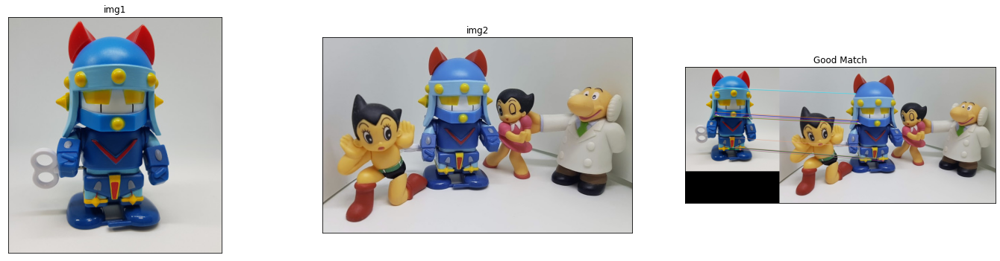

In [94]:
img1 = cv2.imread('./taekwonv1.jpg')
img2 = cv2.imread('./figures.jpg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# ORB로 서술자 추출 ---①
detector = cv2.ORB_create()
kp1, desc1 = detector.detectAndCompute(gray1, None)
kp2, desc2 = detector.detectAndCompute(gray2, None)

# BF-Hamming으로 매칭 ---②
matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = matcher.match(desc1, desc2)

# 매칭 결과를 거리기준 오름차순으로 정렬 ---③
matches = sorted(matches, key=lambda x:x.distance)

# 최소 거리 값과 최대 거리 값 확보 ---④
min_dist, max_dist = matches[0].distance, matches[-1].distance

# 최소 거리의 20% 지점을 임계점으로 설정 ---⑤
ratio = 0.2
good_thresh = (max_dist - min_dist) * ratio + min_dist

# 임계점 보다 작은 매칭점만 좋은 매칭점으로 분류 ---⑥
good_matches = [m for m in matches if m.distance < good_thresh]
print('matches:%d/%d, min:%.2f, max:%.2f, thresh:%.2f' \
        %(len(good_matches),len(matches), min_dist, max_dist, good_thresh))

# 좋은 매칭점만 그리기 ---⑦
res = cv2.drawMatches(img1, kp1, img2, kp2, good_matches, None, \
                flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

# 결과 출력
imgs = {'img1' : img1, 'img2' : img2, 'Good Match' : res}

fig, axes = plt.subplots(1,3,figsize=(20, 5))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

### knnMatch 함수로부터 올바른 매칭점 찾기

matches:23/500


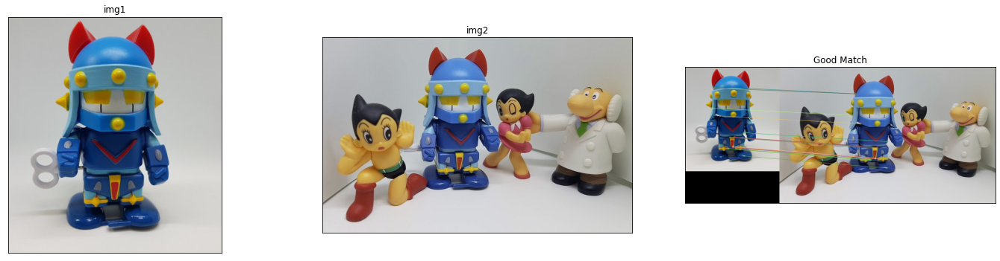

In [95]:
img1 = cv2.imread('./taekwonv1.jpg')
img2 = cv2.imread('./figures.jpg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# ORB로 서술자 추출 ---①
detector = cv2.ORB_create()
kp1, desc1 = detector.detectAndCompute(gray1, None)
kp2, desc2 = detector.detectAndCompute(gray2, None)

# BF-Hamming 생성 ---②
matcher = cv2.BFMatcher(cv2.NORM_HAMMING2)

# knnMatch, k=2 ---③
matches = matcher.knnMatch(desc1, desc2, 2)

# 첫번재 이웃의 거리가 두 번째 이웃 거리의 75% 이내인 것만 추출---⑤
ratio = 0.75
good_matches = [first for first,second in matches \
                    if first.distance < second.distance * ratio]
print('matches:%d/%d' %(len(good_matches),len(matches)))

# 좋은 매칭만 그리기
res = cv2.drawMatches(img1, kp1, img2, kp2, good_matches, None, \
                    flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
# 결과 출력                    
imgs = {'img1' : img1, 'img2' : img2, 'Good Match' : res}

fig, axes = plt.subplots(1,3,figsize=(20, 5))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

### 매칭 영역 원근 변환

- 올바르게 매칭된 좌표들에 원근 변환 행렬을 구하면 매칭 되는 물체가 어디 있는지 표시할 수 있음
- 원근 변환 행렬을 구하면 찾고자 하는 물체의 위치를 잘 찾을 수 있음
- 원근 변환 행렬에 들어맞지 않는 매칭점을 구분할 수 있어서 나쁜 매칭점을 한번 더 제거 가능
- 원근 변환 행렬을 구하는 함수는 cv2.findHomography(), 원래 좌표들을 원근 변환 행렬로 변환하는 함수는 cv2.perspectiveTransform()

```python
mtrx, mask = cv2.findHomography(srcPoints, dstPoints, method, ransacReprojThreshold, mask, maxIters, confidence)
```
        srcPoints: 원본 좌표 배열
        dstPoints: 결과 좌표 배열
        method=0(optional): 근사 계산 알고리즘 선택 (0: 모든 점으로 최소 제곱 오차 계산, cv2.RANSAC, cv2.LMEDS, cv2.RHO)
        ransacReprojThreshold=3(optional): 정상치 거리 임계 값(RANSAC, RHO인 경우)
        maxIters=2000(optional): 근사 계산 반복 횟수
        confidence=0.995(optional): 신뢰도(0~1의 값)
        mtrx: 결과 변환 행렬
        mask: 정상치 판별 결과, N x 1 배열 (0: 비정상치, 1: 정상치)
        
```python
dst = cv2.perspectiveTransform(src, m, dst)
```
        src: 입력 좌표 배열
        m: 변환 배열
        dst(optional): 출력 좌표 배열
        
        
- cv2.findHomography() 함수는 cv2.getPerspectiveTransform() 함수와 유사
    - cv2.getPerspectiveTransform()은 4개의 꼭짓점으로 정확한 원근 변환 행렬을 반환하지만, cv2.findHomography()는 여러 개의 점으로 근사 계산한 원근 변환 행렬을 반환
    - cv2.perspectiveTransform() 함수는 원근 변환할 새로운 좌표 배열을 반환

- cv2.findHomography() 함수의 method 파라미터에는 0, cv2.RANSAC, cv2.LMEDS, cv2.RHO의 값을 전달
    - method 파라미터는 원근 변환의 근사 계산을 위한 알고리즘, default 값인 0은 모든 좌표를 최소 제곱 법으로 근사 계산
    - cv2.RANSAC : 모든 좌표를 사용하지 않고 임의의 좌표만 선정해서 만족도를 구하는 방식, 만족도가 큰 것만 선정하여 근사 계산
        - 선정된 점들은 정상치로 분류하고 그 외의 점들은 이상치로 분류해서 노이즈로 판단, 이상치를 구분하는 임계 값으로 ransacReprojThreshold 값 지정
    - cv2.LMEDS : 제곱의 최소 중간값을 사용, 정상치가 50% 이상인 경우에만 정상적으로 작동
    - cv2.RHO :  이상치가 많은 경우에 더 빠름

### 매칭점 원근 변환으로 영역 찾기

good matches:23/500


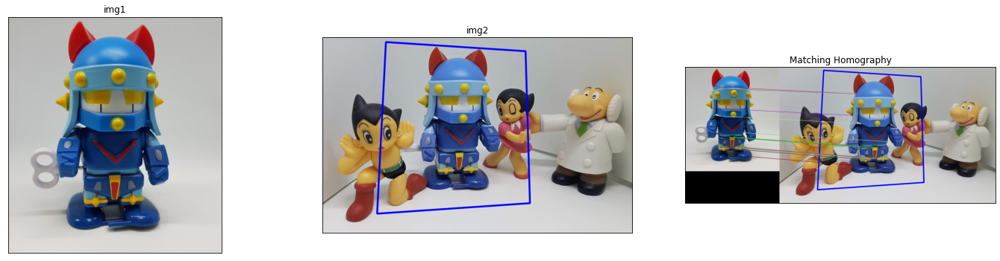

In [96]:
img1 = cv2.imread('./taekwonv1.jpg')
img2 = cv2.imread('./figures.jpg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# ORB, BF-Hamming 로 knnMatch  ---①
detector = cv2.ORB_create()
kp1, desc1 = detector.detectAndCompute(gray1, None)
kp2, desc2 = detector.detectAndCompute(gray2, None)
matcher = cv2.BFMatcher(cv2.NORM_HAMMING2)
matches = matcher.knnMatch(desc1, desc2, 2)

# 이웃 거리의 75%로 좋은 매칭점 추출---②
ratio = 0.75
good_matches = [first for first,second in matches \
                    if first.distance < second.distance * ratio]
print('good matches:%d/%d' %(len(good_matches),len(matches)))

# 좋은 매칭점의 queryIdx로 원본 영상의 좌표 구하기 ---③
src_pts = np.float32([ kp1[m.queryIdx].pt for m in good_matches ])

# 좋은 매칭점의 trainIdx로 대상 영상의 좌표 구하기 ---④
dst_pts = np.float32([ kp2[m.trainIdx].pt for m in good_matches ])

# 원근 변환 행렬 구하기 ---⑤
mtrx, mask = cv2.findHomography(src_pts, dst_pts)

# 원본 영상 크기로 변환 영역 좌표 생성 ---⑥
h,w, = img1.shape[:2]
pts = np.float32([ [[0,0]],[[0,h-1]],[[w-1,h-1]],[[w-1,0]] ])

# 원본 영상 좌표를 원근 변환  ---⑦
dst = cv2.perspectiveTransform(pts,mtrx)

# 변환 좌표 영역을 대상 영상에 그리기 ---⑧
img2 = cv2.polylines(img2,[np.int32(dst)],True,255,3, cv2.LINE_AA)

# 좋은 매칭 그려서 출력 ---⑨
res = cv2.drawMatches(img1, kp1, img2, kp2, good_matches, None, \
                    flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)


imgs = {'img1' : img1, 'img2' : img2, 'Matching Homography' : res}

fig, axes = plt.subplots(1,3,figsize=(20, 5))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

### RANSAC 원근 변환 근사 계산으로 나쁜 매칭 제거

accuracy: 25/135(0.19%)


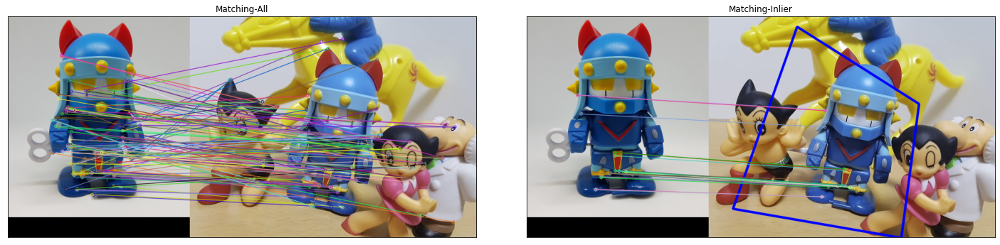

In [99]:
img1 = cv2.imread('./taekwonv1.jpg')
img2 = cv2.imread('./figures2.jpg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# ORB, BF-Hamming 로 knnMatch  ---①
detector = cv2.ORB_create()
kp1, desc1 = detector.detectAndCompute(gray1, None)
kp2, desc2 = detector.detectAndCompute(gray2, None)
matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = matcher.match(desc1, desc2)

# 매칭 결과를 거리기준 오름차순으로 정렬 ---③
matches = sorted(matches, key=lambda x:x.distance)

# 모든 매칭점 그리기 ---④
res1 = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, \
                    flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

# 매칭점으로 원근 변환 및 영역 표시 ---⑤
src_pts = np.float32([ kp1[m.queryIdx].pt for m in matches ])
dst_pts = np.float32([ kp2[m.trainIdx].pt for m in matches ])

# RANSAC으로 변환 행렬 근사 계산 ---⑥
mtrx, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
h,w = img1.shape[:2]
pts = np.float32([ [[0,0]],[[0,h-1]],[[w-1,h-1]],[[w-1,0]] ])
dst = cv2.perspectiveTransform(pts,mtrx)
img2 = cv2.polylines(img2,[np.int32(dst)],True,255,3, cv2.LINE_AA)

# 정상치 매칭만 그리기 ---⑦
matchesMask = mask.ravel().tolist()
res2 = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, \
                    matchesMask = matchesMask,
                    flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

# 모든 매칭점과 정상치 비율 ---⑧
accuracy=float(mask.sum()) / mask.size
print("accuracy: %d/%d(%.2f%%)"% (mask.sum(), mask.size, accuracy))

# 결과 출력                    
imgs = {'Matching-All' : res1, 'Matching-Inlier' : res2}

fig, axes = plt.subplots(1,2,figsize=(20, 5))
plt.tight_layout(h_pad=0, w_pad=4)

for d,i in enumerate(imgs.keys()):
    
    axes[d].imshow(imgs[i][:,:,::-1])
    axes[d].set_title(i)
    axes[d].set_xticks([]) 
    axes[d].set_yticks([]) 

plt.show()

## 26. 배경 제거(Background Subtraction)

### 객체 추적(Object Tracking)

- 동영상에서 지속적으로 움직이는 객체를 찾는 방법을 객체 추적이라고 함

### 배경 제거(Background Subtraction)

- 객체를 명확히 파악하기 위한 방법이 바로 배경 제거
- 배경 제거는 객체를 포함하는 영상에서 객체가 없는 배경 영상을 빼는 방법을 말합니다. 즉, 배경을 모두 제거해 객체만 남기는 방법
- opencv 4.0 버전부터 createBackgroundSubtractorMOG 없어짐

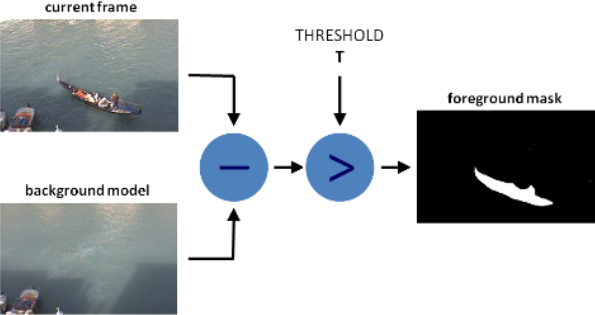


```python
cv2.createBackgroundSubtractorMOG2(history, varThreshold, detectShadows)
```
        history=500: 히스토리 개수
        varThreshold=16: 분산 임계 값
        detectShadows=True: 그림자 표시
        
- 가우시안 분포 값 사용하기 때문에 빛의 변화가 심한 영상에 적용이 좋음
- default 값 설정해도 문제없음


- 배경제거 객체의 인터페이스 함수
```python
foregroundmask = backgroundsubtractor.apply(img, foregroundmask, learningRate)
```
        img: 입력 영상
        foregroundmask: 전경 마스크
        learningRate=-1: 배경 훈련 속도(0~1, -1: 자동)

```python
backgroundImage = backgroundsubtractor.getBackgroundImage(backgroundImage)
```
        backgroundImage: 훈련용 배경 이미지

### BackgroundSubtractorMOG2로 배경 제거

In [105]:
cap = cv2.VideoCapture('./walking.avi')
fps = cap.get(cv2.CAP_PROP_FPS) # 프레임 수 구하기
delay = int(1000/fps)
# 배경 제거 객체 생성 --- ①
fgbg = cv2.createBackgroundSubtractorMOG2()

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
        
    # 배경 제거 마스크 계산 --- ②
    fgmask = fgbg.apply(frame)
    cv2.imshow('frame',frame)
    cv2.imshow('bgsub',fgmask)
    if cv2.waitKey(1) & 0xff == 27:
        break
    
cap.release()
cv2.destroyAllWindows()

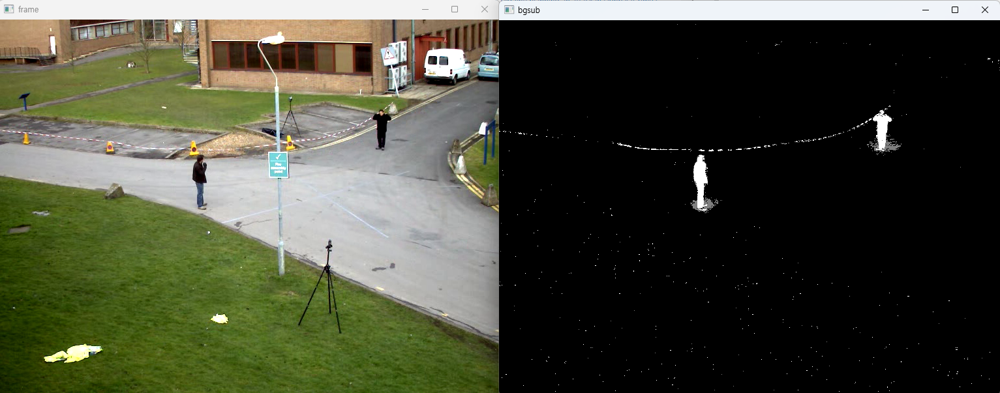

- 배경 제거 객체 생성시 파라미터 값은 모두 default 설정
- 배경 제거 객체에 apply() 함수를 적용하여 배경이 제거된 전경 마스크 생성

## 27. 광학 흐름(Optical Flow)

- 광학 흐름이란 영상 내 물체의 움직임 패턴을 의미
- 이전 프레임과 다음 프레임 간 픽셀이 이동한 방향과 거리 분포
- 광학 흐름으로 영상 내 물체가 어느 방향으로 얼마만큼 움직였는지 파악할 수 있음
- 추가 연산을 하면 물체의 움직임을 예측 가능

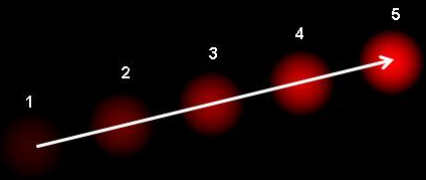


- 광학 흐름의 두 가지 특징
    1. 연속된 프레임 사이에서 움직이는 물체의 픽셀 강도는 변함 없음
    2. 이웃하는 픽셀은 비슷한 움직임을 가짐

- 광학 흐름 계산 방법은 일부 픽셀만 계산하는 희소 광학 흐름, 영상 전체 픽셀을 모두 계산하는 밀집 광학 흐름

### 루카스-카나데(Lucas-Kanade) 알고리즘

- 광학 흐름은 이웃하는 픽셀이 비슷하게 움직인다고 가정, 이 가정을 사용하는 것이 루카스-카나데 알고리즘
    - 이웃하는 픽셀은 비슷한 움직임을 갖는다고 생각하고 광학 흐름을 파악
- 작은 윈도(3 x 3 patch)를 사용하여 움직임을 계산, 물체 움직임이 크면 문제가 생김 윈도 크기가 작기 때문
- 이를 이미지 피라미드를 사용해 개선함,  이미지 피라미드 위쪽으로 갈수록(이미지가 작아질수록) 작은 움직임은 티가 안 나고 큰 움직임은 작은 움직임 같아짐
    - 이를 사용해 큰 움직임도 파악
    
```python
nextPts, status, err = cv2.calcOpticalFlowPyrLK(prevImg, nextImg, prevPts, nextPts, status, err, wirnSize, maxLevel, criteria, flags, minEigThreshold)
```
        prevImg: 이전 프레임 영상
        nextImg: 다음 프레임 영상
        prevPts: 이전 프레임의 코너 특징점, cv2.goodFeaturesToTrack()으로 검출
        nextPst: 다음 프레임에서 이동한 코너 특징점
        status: 결과 상태 벡터, nextPts와 같은 길이, 대응점이 있으면 1, 없으면 0
        err: 결과 에러 벡터, 대응점 간의 오차
        winSize=(21,21): 각 이미지 피라미드의 검색 윈도 크기
        maxLevel=3: 이미지 피라미드 계층 수
        criteria=(COUNT+EPS, 30, 0.01): 반복 탐색 중지 요건 (cv2.TERM_CRITERIA_EPS: 정확도가 epsilon보다 작으면 중지, cv2.TERM_CRITERIA_MAX_ITER: max_iter 횟수를 채우면 중지, cv2.TERM_CRITERIA_COUNT: MAX_ITER와 동일, max_iter: 최대 반복 횟수, epsilon: 최소 정확도)
        flgs=0: 연산 모드 (0: prevPts를 nextPts의 초기 값으로 사용, cv2.OPTFLOW_USE_INITAL_FLOW: nextPts의 값을 초기 값으로 사용, cv2.OPTFLOW_LK_GET_MIN_EIGENVALS: 오차를 최소 고유 값으로 계산)
        minEigThreshold=1e-4: 대응점 계산에 사용할 최소 임계 고유 값
        
------------------------------------

- cv2.calcOpticalFlowPyrLK()는 영상 내 픽셀 전체를 한번에 계산하지 않음,  cv2.goodFeaturesToTrack() 함수로 얻은 특징점만 활용하여 계산
- prevImg와 nextImg 파라미터에는 이전 프레임과 다음 프레임을 전달, prevPts 파라미터에는 이전 프레임에서 얻은 특징점을 전달
- 위 과정으로 특징점이 다음 프레임에서 어디로 이동했는지 계산하여 nextPts로 반환, 두 특징점이 서로 대응하면 status 변수가 1, 그렇지 않으면 0

### calcOpticalFlowPyrLK 이용한 광학 흐름 추적 

In [109]:
cap = cv2.VideoCapture('./walking.avi')
fps = cap.get(cv2.CAP_PROP_FPS) # 프레임 수 구하기
delay = int(1000/fps)

# 추적 경로를 그리기 위한 랜덤 색상
color = np.random.randint(0,255,(200,3))
lines = None  #추적 선을 그릴 이미지 저장 변수
prevImg = None  # 이전 프레임 저장 변수

# calcOpticalFlowPyrLK 중지 요건 설정
termcriteria =  (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)

while cap.isOpened():
    ret,frame = cap.read()
    if not ret:
        break
    img_draw = frame.copy()
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    
    # 최초 프레임 경우
    if prevImg is None:
        prevImg = gray
        # 추적선 그릴 이미지를 프레임 크기에 맞게 생성
        lines = np.zeros_like(frame)
        
        # 추적 시작을 위한 코너 검출  ---①
        prevPt = cv2.goodFeaturesToTrack(prevImg, 200, 0.01, 10)
    else:
        nextImg = gray
        
        # 옵티컬 플로우로 다음 프레임의 코너점  찾기 ---②
        nextPt, status, err = cv2.calcOpticalFlowPyrLK(prevImg, nextImg, \
                                        prevPt, None, criteria=termcriteria)
        
        # 대응점이 있는 코너, 움직인 코너 선별 ---③
        prevMv = prevPt[status==1]
        nextMv = nextPt[status==1]
        for i,(p, n) in enumerate(zip(prevMv, nextMv)):
            px,py = p.ravel()
            nx,ny = n.ravel()
            
            # 이전 코너와 새로운 코너에 선그리기 ---④
            cv2.line(lines, (int(px), int(py)), (int(nx),int(ny)), color[i].tolist(), 2)
            
            # 새로운 코너에 점 그리기
            cv2.circle(img_draw, (int(nx),int(ny)), 2, color[i].tolist(), -1)
            
        # 누적된 추적 선을 출력 이미지에 합성 ---⑤
        img_draw = cv2.add(img_draw, lines)
        
        # 다음 프레임을 위한 프레임과 코너점 이월
        prevImg = nextImg
        prevPt = nextMv.reshape(-1,1,2)

    cv2.imshow('OpticalFlow-LK', img_draw)
    key = cv2.waitKey(delay)
    if key == 27 : # Esc:종료
        break
    elif key == 8: # Backspace:추적 이력 지우기
        prevImg = None
        
        
cap.release()
cv2.destroyAllWindows()

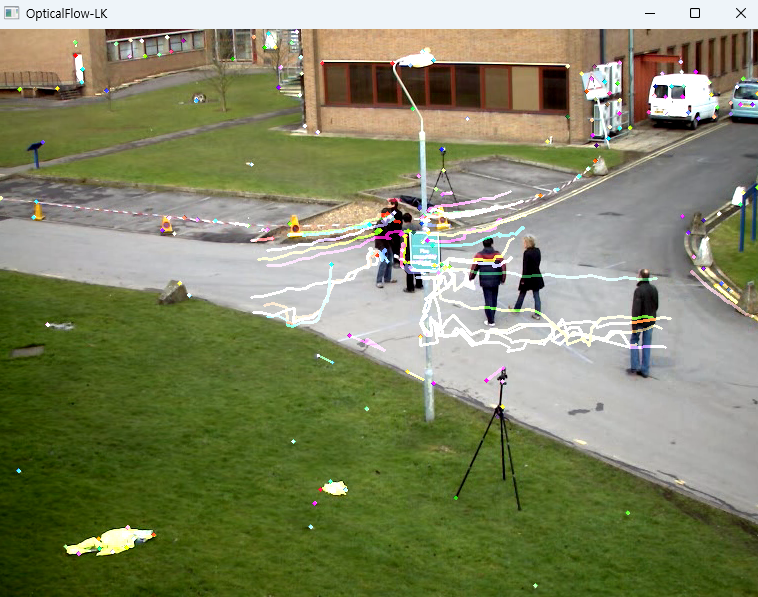

- cv2.goodFeatureToTrack() 함수로 이전 프레임의 특징점을 검출
- cv2.calcOpticalFlowPyrLK() 함수로 광학 흐름을 계산해 다음 프레임의 특징점 찾음
- 이전 프레임과 다음 프레임 특징점 중 잘 대응되는 특징점만 선별하여 선과 점으로 표시후 원본 이미지에 추적선 합치는 방식

### 군나르 파너백(Gunner Farneback) 알고리즘

- 밀집 방식으로 광학 흐름을 계산하는 알고리즘

```python
flow = cv2.calcOpticalFlowFarneback(prev, next, flow, pyr_scale, levels, winsize, iterations, poly_n, poly_sigma, flags)
```
        prev, next: 이전, 이후 프레임
        flow: 광학 흐름 계산 결과, 각 픽셀이 이동한 거리 (입력과 동일한 크기)
        pyr_scale: 이미지 피라미드 스케일
        levels: 이미지 피라미드 개수
        winsize: 평균 윈도 크기
        iterations: 각 피라미드에서 반복할 횟수
        poly_n: 다항식 근사를 위한 이웃 크기, 5 또는 7
        poly_sigma: 다항식 근사에서 사용할 가우시안 시그마 (poly_n=5일 때는 1.1, poly_n=7일 때는 1.5)
        flags: 연산 모드 (cv2.OPTFLOW_USE_INITAL_FLOW: flow 값을 초기 값으로 사용, cv2.OPTFLOW_FARNEBACK_GAUSSIAN: 박스 필터 대신 가우시안 필터 사용)

### calcOPticalFlowFarneback 추적

In [111]:
# 플로우 결과 그리기 ---①
def drawFlow(img,flow,step=16):
  h,w = img.shape[:2]

  # 16픽셀 간격의 그리드 인덱스 구하기 ---②
  idx_y,idx_x = np.mgrid[step/2:h:step,step/2:w:step].astype(np.int)
  indices =  np.stack( (idx_x,idx_y), axis =-1).reshape(-1,2)
  for x,y in indices:   # 인덱스 순회
    # 각 그리드 인덱스 위치에 점 그리기 ---③
    cv2.circle(img, (x,y), 1, (0,255,0), -1)
    # 각 그리드 인덱스에 해당하는 플로우 결과 값 (이동 거리)  ---④
    dx,dy = flow[y, x].astype(np.int)
    # 각 그리드 인덱스 위치에서 이동한 거리 만큼 선 그리기 ---⑤
    cv2.line(img, (x,y), (x+dx, y+dy), (0,255, 0),2, cv2.LINE_AA )


prev = None # 이전 프레임 저장 변수

cap = cv2.VideoCapture('./walking.avi')
fps = cap.get(cv2.CAP_PROP_FPS) # 프레임 수 구하기
delay = int(1000/fps)

while cap.isOpened():
  ret,frame = cap.read()
  if not ret: break
  gray = cv2.cvtColor(frame,cv2.COLOR_BGR2GRAY)
  # 최초 프레임 경우 
  if prev is None: 
    prev = gray # 첫 이전 프레임 --- ⑥
  else:
    # 이전, 이후 프레임으로 옵티컬 플로우 계산 ---⑦
    flow = cv2.calcOpticalFlowFarneback(prev,gray,None,\
                0.5,3,15,3,5,1.1,cv2.OPTFLOW_FARNEBACK_GAUSSIAN) 
    # 계산 결과 그리기, 선언한 함수 호출 ---⑧
    drawFlow(frame,flow)
    # 다음 프레임을 위해 이월 ---⑨
    prev = gray
  
  cv2.imshow('OpticalFlow-Farneback', frame)
  if cv2.waitKey(delay) == 27:
      break
        
cap.release()
cv2.destroyAllWindows()

C:\Users\AIFactory DS1-A\AppData\Local\Temp\ipykernel_38440\970572121.py:6: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  idx_y,idx_x = np.mgrid[step/2:h:step,step/2:w:step].astype(np.int)
C:\Users\AIFactory DS1-A\AppData\Local\Temp\ipykernel_38440\970572121.py:12: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish 

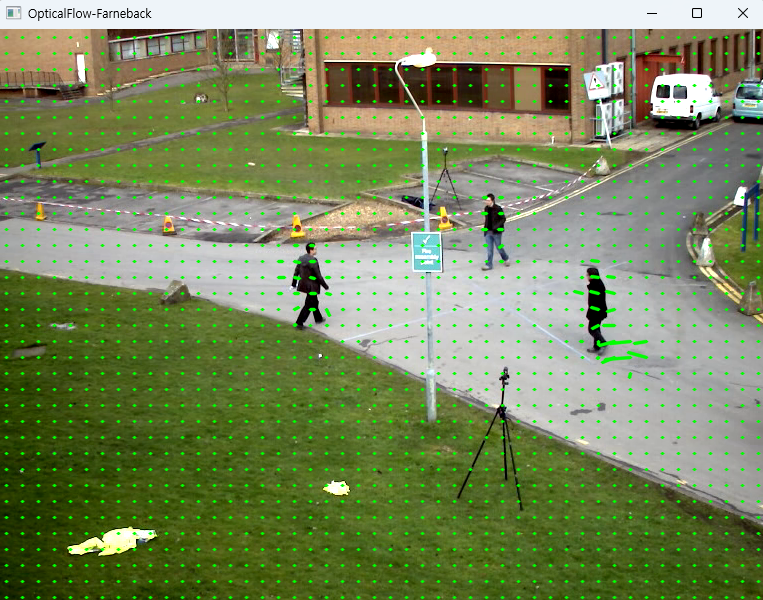

- drawFlow() 함수로 16픽셀 간격으로 격자 모양의 점 생성
- 각 점에서 해당하는 픽셀이 이동한 만큼 선으로 표시
- 희소 광학 흐름과 다르게 밀집 광학 흐름은 영상 전체에서 일어나는 움직임을 감지

## 28. 객체 추적을 위한 Tracking API

### Tracking API

- Tracking API를 이용하면 쉽게 객체 추적이 가능
- 추적하고자 하는 객체만 지정해주면 API가 알아서 객체를 추적
- Tracking API생성자는 밑과 같음
        - tracker = cv2.TrackerBoosting_create(): AdaBoost 알고리즘 기반
        - tracker = cv2.TrackerMIL_create(): MIL(Multiple Instance Learning) 알고리즘 기반
        - tracker = cv2.TrackerKCF_create(): KCF(Kernelized Correlation Filters) 알고리즘 기반
        - tracker = cv2.TrackerTLD_create(): TLD(Tracking, Learning and Detection) 알고리즘 기반
        - tracker = cv2.TrackerMedianFlow_create(): 객체의 전방향/역방향을 추적해서 불일치성을 측정
        - tracker = cv2.TrackerGOTURN_cretae(): CNN(Convolutional Neural Networks) 기반
        - tracker = cv2.TrackerCSRT_create(): CSRT(Channel and Spatial Reliability)
        - tracker = cv2.TrackerMOSSE_create(): 내부적으로 그레이 스케일 사용


-  생성한 Tracker는 init() 함수로 초기화 가능, init() 함수의 파라미터로  입력 영상과 추적 대상 객체가 있는 좌표를 전달

```python
retval = cv2.Tracker.init(img, boundingBox): Tracker 초기화
```
        img: 입력 영상
        boundingBox: 추적 대상 객체가 있는 좌표 (x, y)
- 초기화 후 새로운 영상 프레임에서 추적 대상 객체의 위치를 찾기 위해 update() 함수를 호출

```python
retval, boundingBox = cv2.Tracker.update(img): 새로운 프레임에서 추적 대상 객체 위치 찾기
```
        img: 새로운 프레임 영상
        retval: 추적 성공 여부
        boundingBox: 새로운 프레임에서의 추적 대상 객체의 새로운 위치 (x, y, w, h)

### Tracker APIs 현재 버전에서는 함수가 사라졌기 때문에 3.4.11.45 버전으로 다운그래이드 후 수행

In [6]:
# 트랙커 객체 생성자 함수 리스트 ---①
trackers = [cv2.TrackerBoosting_create,
            cv2.TrackerMIL_create,
            cv2.TrackerKCF_create,
            cv2.TrackerTLD_create,
            cv2.TrackerMedianFlow_create,
            # cv2.TrackerGOTURN_create, #버그로 오류 발생
            cv2.TrackerCSRT_create,
            cv2.TrackerMOSSE_create]

trackerIdx = 0  # 트랙커 생성자 함수 선택 인덱스
tracker = None
isFirst = True

video_src = 0 # 비디오 파일과 카메라 선택 ---②
video_src = "./highway.mp4"
cap = cv2.VideoCapture(video_src)
fps = cap.get(cv2.CAP_PROP_FPS) # 프레임 수 구하기
delay = int(1000/fps)
win_name = 'Tracking APIs'

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        print('Cannot read video file')
        break
    img_draw = frame.copy()
    if tracker is None: # 트랙커 생성 안된 경우
        cv2.putText(img_draw, "Press the Space to set ROI!!", \
            (100,80), cv2.FONT_HERSHEY_SIMPLEX, 0.75,(0,0,255),2,cv2.LINE_AA)
    else:
        ok, bbox = tracker.update(frame)   # 새로운 프레임에서 추적 위치 찾기 ---③
        (x,y,w,h) = bbox
        if ok: # 추적 성공
            cv2.rectangle(img_draw, (int(x), int(y)), (int(x + w), int(y + h)), \
                          (0,255,0), 2, 1)
        else : # 추적 실패
            cv2.putText(img_draw, "Tracking fail.", (100,80), \
                        cv2.FONT_HERSHEY_SIMPLEX, 0.75,(0,0,255),2,cv2.LINE_AA)
            
    trackerName = tracker.__class__.__name__
    cv2.putText(img_draw, str(trackerIdx) + ":"+trackerName , (100,20), \
                 cv2.FONT_HERSHEY_SIMPLEX, 0.75, (0,255,0),2,cv2.LINE_AA)

    cv2.imshow(win_name, img_draw)
    key = cv2.waitKey(delay) & 0xff
    # 스페이스 바 또는 비디오 파일 최초 실행 ---④
    if key == ord(' ') or (video_src != 0 and isFirst): 
        isFirst = False
        roi = cv2.selectROI(win_name, frame, False)  # 초기 객체 위치 설정
        if roi[2] and roi[3]:         # 위치 설정 값 있는 경우
            tracker = trackers[trackerIdx]()    #트랙커 객체 생성 ---⑤
            isInit = tracker.init(frame, roi)
    elif key in range(48, 56): # 0~7 숫자 입력   ---⑥
        trackerIdx = key-48     # 선택한 숫자로 트랙커 인덱스 수정
        if bbox is not None:
            tracker = trackers[trackerIdx]() # 선택한 숫자의 트랙커 객체 생성 ---⑦
            isInit = tracker.init(frame, bbox) # 이전 추적 위치로 추적 위치 초기화
    elif key == 27 : 
        break
else:
    print( "Could not open video")
cap.release()
cv2.destroyAllWindows()

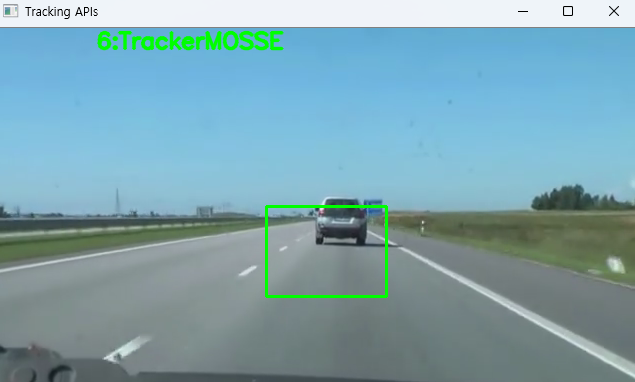

## 29. HOG(Histogram of Oriented Gradient) 디스크립터

### 기울기 벡터(Gradient Vectors)

- 기울기 벡터란 영상 내 하나의 픽셀을 기준으로 주변 픽셀에 대한 기울기를 나타내는 벡터를 의미

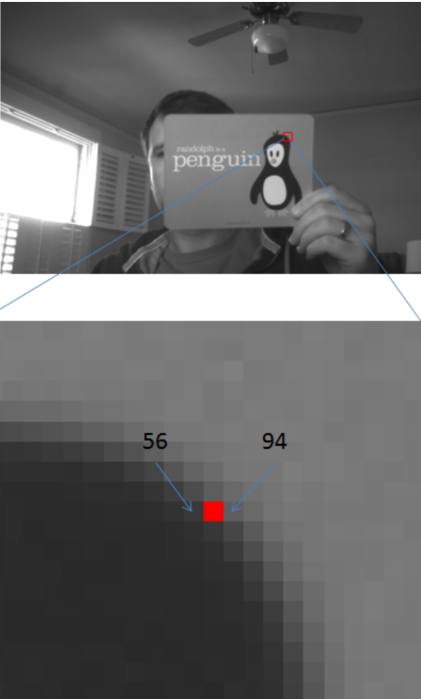

- 빨간 점으로 표시된 픽셀을 기준으로 왼쪽의 Gray Scale 값은 56이고, 오른쪽의 값은 94
- Gray Scale의 경우 0이면 검은색이고 255이면 흰색, 따라서 Gray Scale 값 94가 56보다 밝음
- 빨간 점으로 표시된 픽셀은 x축 방향의 변화량(gx)은 (94 - 56) = 38 , 이 값이 x축 방향 기울기 변화량

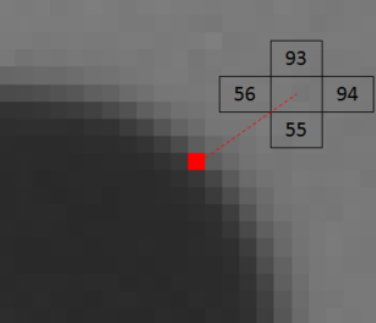

- y축 방향의 기울기 변화량은 (93 - 55) = 38, 즉 x=y=38
- x축 방향 기울기 변화량, y축 방향 기울기 변화량을 함께 표현한 값이 기울기 벡터
- 기울기 벡터의 크기와 방향의 공식 + 크기 방향 표시

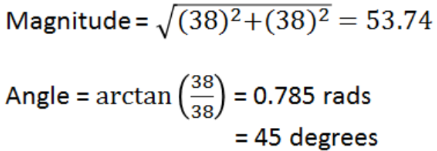
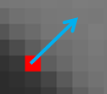

### 픽셀(Pixels), 셀(Cells), 블록(Blocks)

- 픽셀은 말 그대로 영상 내 하나의 픽셀 값을 의미, 픽셀들을 몇 개 묶어서 소그룹으로 만든 것이 셀. 셀을 몇 개 묶어서 그룹으로 만든 것이 블록
    - 하나의 블록 안에 셀 여러 개가 있고, 하나의 셀 안에 픽셀 여러 개 존재

### HOG(Histogram of Oriented Gradient)

- HOG는 보행자 검출을 위해 만들어진 특징 디스크립터
- 이미지 경계의 기울기 벡터 크기, 방향을 히스토그램으로 나타내 계산

- HOG 디스크립터를 만들기 위해서는 영상 속에서 검출하고자 하는 영역을 잘라내야 함
- 잘라낸 영역을 윈도라고 함
- 해당 윈도에 소벨 필터를 적용해 경계의 기울기 gx, gy 계산, 기울기의 방향, 크기를 계산
- 위 작업을 코드로 나타내면

```python
img = cv2.imread('img.png')
img = np.float(img)

gx = cv2.Sobel(img, cv2.CV_32F, 1, 0)
gy = cv2.Sobel(img, cv2.CV_32F, 0, 1)
magnitude, angle = cv2.cartToPolar(gx, gy)
```

-----------------
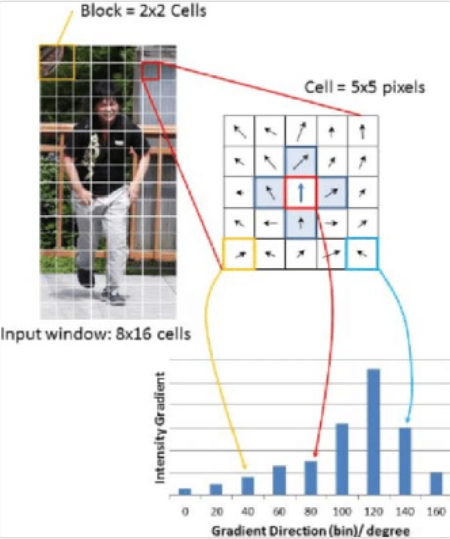

- 위 예시를 확인하면 윈도 사이즈가 8 x 16 cells ,  하나의 셀은 5 x 5 픽셀로 구성 , 하나의 블록은 2x2 셀로 구성, 윈도 사이즈는 (8x5) x (16x5) = 40 x 80 픽셀

- 각 픽셀을 기준으로 기울기 벡터를 계산, 그림에서 화살표
- 계산된 기울기 벡터의 크기와 방향을 히스토그램으로 표시, 기울기 벡터 방향이 속하는 구간(0~180 20도씩 나눈 구간)에 기울기 벡터 크기를 누적
- 히스토그램 계산을 마치면 정규화 수행, 경계 값 기울기는 밝기에 민감해서 없애주려고 정규화 수행
- 정규화를 적용하려면 윈도를 특정 크기로 나눠줘야함, 이렇게 나누는 영역을 블록, 블록 크기는 일반적으로 셀 크기의 2배
    - 8 x 8 픽셀의 셀을 가지고 있다면 블록은 16 x 16 , 각 블록은 전체 윈도를 순회하면서 정규화 수행
    - 정규화 수행하면서 겹치는 부분이 생기는데 이걸 블록 스트라이드 라고함
        - 64 x 128 픽셀의 윈도, 16 x 16 픽셀의 블록이 8 x 8 픽셀의 블록 스트라이드를 가지면 정규화를 계산하는 횟수는 총 7 x 15= 105
        - {64/(16-8) - 1} x {128/(16-8) - 1} = 105

### HOG 디스크립터를 활용한 보행자 인식

```python
descriptor = cv2.HOGDescriptor(winSize, blockSize, blockStride, cellSize, nbins): HOG 디스크립터 추출기 생성
```
        winSize: 윈도 크기, HOG 추출 영역
        blockSize: 블록 크기, 정규화 영역
        blockStride: 정규화 블록 겹침 크기
        cellSize: 셀 크기, 히스토그램 계산 영역
        nbins: 히스토그램 계급 수
        descriptor: HOG 특징 디스크립터 추출기
        
```python
hog = descriptor.compute(img): HOG 계산
```
        img: 계산 대상 이미지
        hog: HOG 특징 디스크립터 결과
        
        
- OpenCV는 보행자 인식을 위한 사전 훈련 API

    - scvmdetector = cv2.HOGDescriptor_getDefaultPeopleDetector(): 64 x 128 윈도 크기로 훈련된 모델
    - scvmdetector = cv2.HOGDescriptor_getDaimlerPeopleDetector(): 48 x 96 윈도 크기로 훈련된 모델
    - descriptor = cv2.HOGDescriptor(winSize, blockSize, blockStride, cellSize, nbins): HOG 생성
    - descriptor.setSVMDetector(svmdetector): 훈련된 SVM 모델 설정
    - rects, weights = descriptor.detectMultiScale(img): 객체 검출
            img: 검출하고자 하는 이미지
            rects: 검출된 결과 영역 좌표 N x 4 (x, y, w, h)
            weights: 검출된 결과 계수 N x 1

### HOG-SVM 보행자 검출 디스크립터를 이용한 보행자 인식

In [8]:
# default 디덱터를 위한 HOG 객체 생성 및 설정--- ①
hogdef = cv2.HOGDescriptor()
hogdef.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())

# dailer 디덱터를 위한 HOG 객체 생성 및 설정--- ②
hogdaim  = cv2.HOGDescriptor((48,96), (16,16), (8,8), (8,8), 9)
hogdaim.setSVMDetector(cv2.HOGDescriptor_getDaimlerPeopleDetector())

cap = cv2.VideoCapture('./walking.avi')
mode = True  # 모드 변환을 위한 플래그 변수 
print('Toggle Space-bar to change mode.')
while cap.isOpened():
    ret, img = cap.read()
    if ret :
        if mode:
            # default 디텍터로 보행자 검출 --- ③
            found, _ = hogdef.detectMultiScale(img)
            for (x,y,w,h) in found:
                cv2.rectangle(img, (x,y), (x+w, y+h), (0,255,255))
        else:
            # daimler 디텍터로 보행자 검출 --- ④
            found, _ = hogdaim.detectMultiScale(img)
            for (x,y,w,h) in found:
                cv2.rectangle(img, (x,y), (x+w, y+h), (0,255,0))
        cv2.putText(img, 'Detector:%s'%('Default' if mode else 'Daimler'), \
                        (10,50 ), cv2.FONT_HERSHEY_DUPLEX,1, (0,255,0),1)
        cv2.imshow('frame', img)
        key = cv2.waitKey(1) 
        if key == 27:
            break
        elif key == ord(' '):
            mode = not mode
    else:
        break
cap.release()
cv2.destroyAllWindows()

Toggle Space-bar to change mode.


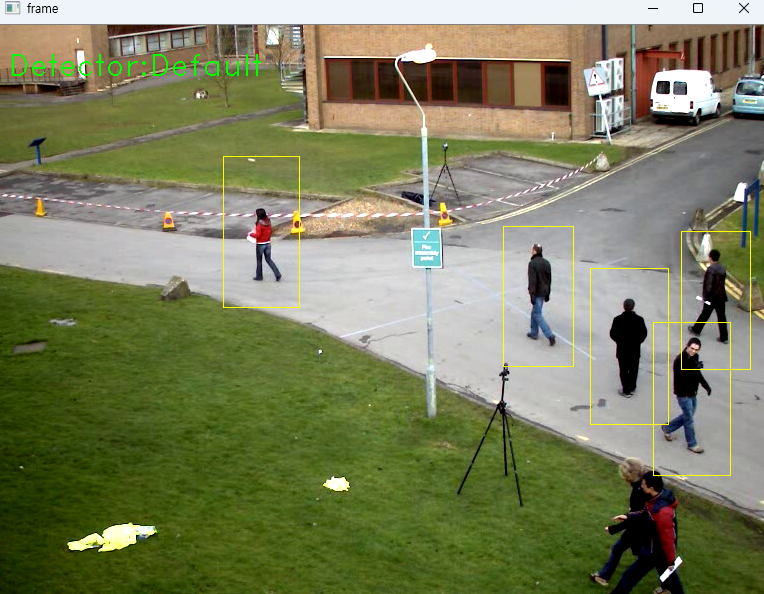

- yolo보다는 확실이 성능이 떨어지지만 그래도 객체를 잡는 속도가 나쁘지않음